# Project: Identify Customer Segments

In this project, you will apply unsupervised learning techniques to identify segments of the population that form the core customer base for a mail-order sales company in Germany. These segments can then be used to direct marketing campaigns towards audiences that will have the highest expected rate of returns. The data that you will use has been provided by our partners at Bertelsmann Arvato Analytics, and represents a real-life data science task.

This notebook will help you complete this task by providing a framework within which you will perform your analysis steps. In each step of the project, you will see some text describing the subtask that you will perform, followed by one or more code cells for you to complete your work. **Feel free to add additional code and markdown cells as you go along so that you can explore everything in precise chunks.** The code cells provided in the base template will outline only the major tasks, and will usually not be enough to cover all of the minor tasks that comprise it.

It should be noted that while there will be precise guidelines on how you should handle certain tasks in the project, there will also be places where an exact specification is not provided. **There will be times in the project where you will need to make and justify your own decisions on how to treat the data.** These are places where there may not be only one way to handle the data. In real-life tasks, there may be many valid ways to approach an analysis task. One of the most important things you can do is clearly document your approach so that other scientists can understand the decisions you've made.

At the end of most sections, there will be a Markdown cell labeled **Discussion**. In these cells, you will report your findings for the completed section, as well as document the decisions that you made in your approach to each subtask. **Your project will be evaluated not just on the code used to complete the tasks outlined, but also your communication about your observations and conclusions at each stage.**

In [1]:
# import libraries here; add more as necessary
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import LabelEncoder
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

import ast

# magic word for producing visualizations in notebook
%matplotlib inline

pd.options.display.max_rows = None
pd.options.display.max_columns = None

In [2]:
root_path = 'C:/Users/User/Udacity/ML-Clustering/Final_project/'

In [3]:
pwd

'C:\\Users\\User'

### Step 0: Load the Data

There are four files associated with this project (not including this one):

- `Udacity_AZDIAS_Subset.csv`: Demographics data for the general population of Germany; 891211 persons (rows) x 85 features (columns).
- `Udacity_CUSTOMERS_Subset.csv`: Demographics data for customers of a mail-order company; 191652 persons (rows) x 85 features (columns).
- `Data_Dictionary.md`: Detailed information file about the features in the provided datasets.
- `AZDIAS_Feature_Summary.csv`: Summary of feature attributes for demographics data; 85 features (rows) x 4 columns

Each row of the demographics files represents a single person, but also includes information outside of individuals, including information about their household, building, and neighborhood. You will use this information to cluster the general population into groups with similar demographic properties. Then, you will see how the people in the customers dataset fit into those created clusters. The hope here is that certain clusters are over-represented in the customers data, as compared to the general population; those over-represented clusters will be assumed to be part of the core userbase. This information can then be used for further applications, such as targeting for a marketing campaign.

To start off with, load in the demographics data for the general population into a pandas DataFrame, and do the same for the feature attributes summary. Note for all of the `.csv` data files in this project: they're semicolon (`;`) delimited, so you'll need an additional argument in your [`read_csv()`](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.read_csv.html) call to read in the data properly. Also, considering the size of the main dataset, it may take some time for it to load completely.

Once the dataset is loaded, it's recommended that you take a little bit of time just browsing the general structure of the dataset and feature summary file. You'll be getting deep into the innards of the cleaning in the first major step of the project, so gaining some general familiarity can help you get your bearings.

### Load Population

In [4]:
# Load in the general demographics data.
population = pd.read_csv(root_path+'/Udacity_AZDIAS_Subset.csv', delimiter=';')


In [5]:
# Check the structure of the data after it's loaded (e.g. print the number of
# rows and columns, print the first few rows).
population.head(10)

,AGER_TYP,ALTERSKATEGORIE_GROB,ANREDE_KZ,CJT_GESAMTTYP,FINANZ_MINIMALIST,FINANZ_SPARER,FINANZ_VORSORGER,FINANZ_ANLEGER,FINANZ_UNAUFFAELLIGER,FINANZ_HAUSBAUER,FINANZTYP,GEBURTSJAHR,GFK_URLAUBERTYP,GREEN_AVANTGARDE,HEALTH_TYP,LP_LEBENSPHASE_FEIN,LP_LEBENSPHASE_GROB,LP_FAMILIE_FEIN,LP_FAMILIE_GROB,LP_STATUS_FEIN,LP_STATUS_GROB,NATIONALITAET_KZ,PRAEGENDE_JUGENDJAHRE,RETOURTYP_BK_S,SEMIO_SOZ,SEMIO_FAM,SEMIO_REL,SEMIO_MAT,SEMIO_VERT,SEMIO_LUST,SEMIO_ERL,SEMIO_KULT,SEMIO_RAT,SEMIO_KRIT,SEMIO_DOM,SEMIO_KAEM,SEMIO_PFLICHT,SEMIO_TRADV,SHOPPER_TYP,SOHO_KZ,TITEL_KZ,VERS_TYP,ZABEOTYP,ALTER_HH,ANZ_PERSONEN,ANZ_TITEL,HH_EINKOMMEN_SCORE,KK_KUNDENTYP,W_KEIT_KIND_HH,WOHNDAUER_2008,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,GEBAEUDETYP,KONSUMNAEHE,MIN_GEBAEUDEJAHR,OST_WEST_KZ,WOHNLAGE,CAMEO_DEUG_2015,CAMEO_DEU_2015,CAMEO_INTL_2015,KBA05_ANTG1,KBA05_ANTG2,KBA05_ANTG3,KBA05_ANTG4,KBA05_BAUMAX,KBA05_GBZ,BALLRAUM,EWDICHTE,INNENSTADT,GEBAEUDETYP_RASTER,KKK,MOBI_REGIO,ONLINE_AFFINITAET,REGIOTYP,KBA13_ANZAHL_PKW,PLZ8_ANTG1,PLZ8_ANTG2,PLZ8_ANTG3,PLZ8_ANTG4,PLZ8_BAUMAX,PLZ8_HHZ,PLZ8_GBZ,ARBEIT,ORTSGR_KLS9,RELAT_AB
0,-1,2,1,2.0,3,4,3,5,5,3,4,0,10.0,0,-1,15.0,4.0,2.0,2.0,1.0,1.0,0,0,5.0,2,6,7,5,1,5,3,3,4,7,6,6,5,3,-1,NaN,NaN,-1,3,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,-1,1,2,5.0,1,5,2,5,4,5,1,1996,10.0,0,3,21.0,6.0,5.0,3.0,2.0,1.0,1,14,1.0,5,4,4,3,1,2,2,3,6,4,7,4,7,6,3,1.0,0.0,2,5,0.0,2.0,0.0,6.0,NaN,3.0,9.0,11.0,0.0,8.0,1.0,1992.0,W,4.0,8,8A,51,0.0,0.0,0.0,2.0,5.0,1.0,6.0,3.0,8.0,3.0,2.0,1.0,3.0,3.0,963.0,2.0,3.0,2.0,1.0,1.0,5.0,4.0,3.0,5.0,4.0
2,-1,3,2,3.0,1,4,1,2,3,5,1,1979,10.0,1,3,3.0,1.0,1.0,1.0,3.0,2.0,1,15,3.0,4,1,3,3,4,4,6,3,4,7,7,7,3,3,2,0.0,0.0,1,5,17.0,1.0,0.0,4.0,NaN,3.0,9.0,10.0,0.0,1.0,5.0,1992.0,W,2.0,4,4C,24,1.0,3.0,1.0,0.0,0.0,3.0,2.0,4.0,4.0,4.0,2.0,3.0,2.0,2.0,712.0,3.0,3.0,1.0,0.0,1.0,4.0,4.0,3.0,5.0,2.0
3,2,4,2,2.0,4,2,5,2,1,2,6,1957,1.0,0,2,0.0,0.0,0.0,0.0,9.0,4.0,1,8,2.0,5,1,2,1,4,4,7,4,3,4,4,5,4,4,1,0.0,0.0,1,3,13.0,0.0,0.0,1.0,NaN,NaN,9.0,1.0,0.0,1.0,4.0,1997.0,W,7.0,2,2A,12,4.0,1.0,0.0,0.0,1.0,4.0,4.0,2.0,6.0,4.0,0.0,4.0,1.0,0.0,596.0,2.0,2.0,2.0,0.0,1.0,3.0,4.0,2.0,3.0,3.0
4,-1,3,1,5.0,4,3,4,1,3,2,5,1963,5.0,0,3,32.0,10.0,10.0,5.0,3.0,2.0,1,8,5.0,6,4,4,2,7,4,4,6,2,3,2,2,4,2,2,0.0,0.0,2,4,20.0,4.0,0.0,5.0,1.0,2.0,9.0,3.0,0.0,1.0,4.0,1992.0,W,3.0,6,6B,43,1.0,4.0,1.0,0.0,0.0,3.0,2.0,5.0,1.0,5.0,3.0,3.0,5.0,5.0,435.0,2.0,4.0,2.0,1.0,2.0,3.0,3.0,4.0,6.0,5.0
5,3,1,2,2.0,3,1,5,2,2,5,2,1943,1.0,0,3,8.0,2.0,1.0,1.0,4.0,2.0,1,3,3.0,2,4,7,4,2,2,2,5,7,4,4,4,7,6,0,0.0,0.0,2,4,10.0,1.0,0.0,5.0,3.0,6.0,9.0,5.0,0.0,1.0,5.0,1992.0,W,7.0,8,8C,54,2.0,2.0,0.0,0.0,0.0,4.0,6.0,2.0,7.0,4.0,4.0,4.0,1.0,5.0,1300.0,2.0,3.0,1.0,1.0,1.0,5.0,5.0,2.0,3.0,3.0
6,-1,2,2,5.0,1,5,1,5,4,3,4,0,12.0,0,2,2.0,1.0,1.0,1.0,2.0,1.0,1,10,4.0,2,5,5,7,2,6,5,5,7,7,4,7,7,7,1,0.0,0.0,1,4,0.0,1.0,0.0,6.0,NaN,3.0,9.0,4.0,0.0,1.0,5.0,1992.0,W,5.0,4,4A,22,3.0,2.0,0.0,0.0,1.0,3.0,6.0,4.0,3.0,5.0,3.0,5.0,2.0,5.0,867.0,3.0,3.0,1.0,0.0,1.0,5.0,5.0,4.0,6.0,3.0
7,-1,1,1,3.0,3,3,4,1,3,2,5,1964,9.0,0,1,5.0,2.0,1.0,1.0,1.0,1.0,1,8,5.0,7,7,7,5,6,2,2,7,5,1,1,2,5,5,0,0.0,0.0,1,1,14.0,1.0,0.0,4.0,NaN,5.0,9.0,6.0,0.0,8.0,3.0,1992.0,W,1.0,2,2D,14,2.0,2.0,0.0,0.0,0.0,4.0,2.0,5.0,3.0,4.0,1.0,4.0,1.0,1.0,758.0,3.0,3.0,1.0,0.0,1.0,4.0,4.0,2.0,5.0,2.0
8,-1,3,1,3.0,4,4,2,4,2,2,6,1974,3.0,1,3,10.0,3.0,1.0,1.0,10.0,5.0,1,11,4.0,4,5,4,1,5,6,4,5,2,5,5,3,1,4,3,0.0,0.0,2,6,16.0,1.0,0.0,3.0,NaN,5.0,8.0,2.0,1.0,3.0,4.0,1992.0,W,1.0,1,1A,13,1.0,1.0,0.0,0.0,0.0,5.0,3.0,4.0,4.0,4.0,1.0,3.0,2.0,3.0,511.0,2.0,3.0,2.0,1.0,1.0,3.0,3.0,2.0,4.0,3.0
9,-1,3,2,4.0,2,4,2,3,5,4,1,1975,12.0,1,2,4.0,1.0,1.0,1.0,3.0,2.0,1,15,4.0,2,1,1,3,2,6,6,3,4,7,6,7,1,3,3,0.0,0.0,2,4,17.0,1.0,0.0,4.0,6.0,4.0,3.0,9.0,0.0,3.0,4.0,1992.0,W,7.0,1,1E,15,1.0,3.0,1.0,0.0,0.0,2.0,6.0,5.0,4.0,3.0,1.0,3.0,3.0,1.0,530.0,2.0,3.0,2.0,1.0,1.0,3.0,3.0,2.0,3.0,1.0


In [6]:
population.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 891221 entries, 0 to 891220
Data columns (total 85 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   AGER_TYP               891221 non-null  int64  
 1   ALTERSKATEGORIE_GROB   891221 non-null  int64  
 2   ANREDE_KZ              891221 non-null  int64  
 3   CJT_GESAMTTYP          886367 non-null  float64
 4   FINANZ_MINIMALIST      891221 non-null  int64  
 5   FINANZ_SPARER          891221 non-null  int64  
 6   FINANZ_VORSORGER       891221 non-null  int64  
 7   FINANZ_ANLEGER         891221 non-null  int64  
 8   FINANZ_UNAUFFAELLIGER  891221 non-null  int64  
 9   FINANZ_HAUSBAUER       891221 non-null  int64  
 10  FINANZTYP              891221 non-null  int64  
 11  GEBURTSJAHR            891221 non-null  int64  
 12  GFK_URLAUBERTYP        886367 non-null  float64
 13  GREEN_AVANTGARDE       891221 non-null  int64  
 14  HEALTH_TYP             891221 non-nu

### Load feature_summary

In [7]:
feature_summary = pd.read_csv(root_path+'/AZDIAS_Feature_Summary.csv', delimiter=';')
feature_summary.describe()


,attribute,information_level,type,missing_or_unknown
count,85,85,85,85
unique,85,9,5,9
top,AGER_TYP,person,ordinal,[-1]
freq,1,43,49,26


In [8]:
feature_summary

,attribute,information_level,type,missing_or_unknown
0,AGER_TYP,person,categorical,"[-1,0]"
1,ALTERSKATEGORIE_GROB,person,ordinal,"[-1,0,9]"
2,ANREDE_KZ,person,categorical,"[-1,0]"
3,CJT_GESAMTTYP,person,categorical,[0]
4,FINANZ_MINIMALIST,person,ordinal,[-1]
5,FINANZ_SPARER,person,ordinal,[-1]
6,FINANZ_VORSORGER,person,ordinal,[-1]
7,FINANZ_ANLEGER,person,ordinal,[-1]
8,FINANZ_UNAUFFAELLIGER,person,ordinal,[-1]
9,FINANZ_HAUSBAUER,person,ordinal,[-1]


### load Customer data 

In [9]:
customers = pd.read_csv(root_path+'/Udacity_CUSTOMERS_Subset.csv', delimiter=';')

In [10]:
customers.head()

,AGER_TYP,ALTERSKATEGORIE_GROB,ANREDE_KZ,CJT_GESAMTTYP,FINANZ_MINIMALIST,FINANZ_SPARER,FINANZ_VORSORGER,FINANZ_ANLEGER,FINANZ_UNAUFFAELLIGER,FINANZ_HAUSBAUER,FINANZTYP,GEBURTSJAHR,GFK_URLAUBERTYP,GREEN_AVANTGARDE,HEALTH_TYP,LP_LEBENSPHASE_FEIN,LP_LEBENSPHASE_GROB,LP_FAMILIE_FEIN,LP_FAMILIE_GROB,LP_STATUS_FEIN,LP_STATUS_GROB,NATIONALITAET_KZ,PRAEGENDE_JUGENDJAHRE,RETOURTYP_BK_S,SEMIO_SOZ,SEMIO_FAM,SEMIO_REL,SEMIO_MAT,SEMIO_VERT,SEMIO_LUST,SEMIO_ERL,SEMIO_KULT,SEMIO_RAT,SEMIO_KRIT,SEMIO_DOM,SEMIO_KAEM,SEMIO_PFLICHT,SEMIO_TRADV,SHOPPER_TYP,SOHO_KZ,TITEL_KZ,VERS_TYP,ZABEOTYP,ALTER_HH,ANZ_PERSONEN,ANZ_TITEL,HH_EINKOMMEN_SCORE,KK_KUNDENTYP,W_KEIT_KIND_HH,WOHNDAUER_2008,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,GEBAEUDETYP,KONSUMNAEHE,MIN_GEBAEUDEJAHR,OST_WEST_KZ,WOHNLAGE,CAMEO_DEUG_2015,CAMEO_DEU_2015,CAMEO_INTL_2015,KBA05_ANTG1,KBA05_ANTG2,KBA05_ANTG3,KBA05_ANTG4,KBA05_BAUMAX,KBA05_GBZ,BALLRAUM,EWDICHTE,INNENSTADT,GEBAEUDETYP_RASTER,KKK,MOBI_REGIO,ONLINE_AFFINITAET,REGIOTYP,KBA13_ANZAHL_PKW,PLZ8_ANTG1,PLZ8_ANTG2,PLZ8_ANTG3,PLZ8_ANTG4,PLZ8_BAUMAX,PLZ8_HHZ,PLZ8_GBZ,ARBEIT,ORTSGR_KLS9,RELAT_AB
0,2,4,1,5.0,5,1,5,1,2,2,2,0,4.0,1,1,20.0,5.0,2.0,2.0,10.0,5.0,1,4,5.0,6,5,2,6,6,7,3,4,1,3,1,1,2,1,3,0.0,0.0,1,3,10.0,2.0,0.0,1.0,NaN,6.0,9.0,1.0,0.0,1.0,5.0,1992.0,W,7.0,1,1A,13,2.0,2.0,0.0,0.0,0.0,4.0,3.0,2.0,4.0,4.0,1.0,4.0,3.0,1.0,1201.0,3.0,3.0,1.0,0.0,1.0,5.0,5.0,1.0,2.0,1.0
1,-1,4,1,NaN,5,1,5,1,3,2,2,0,NaN,0,1,NaN,NaN,NaN,NaN,NaN,NaN,1,0,NaN,3,6,2,6,7,5,3,4,1,3,3,2,4,1,3,0.0,0.0,1,3,11.0,3.0,0.0,NaN,NaN,0.0,9.0,NaN,NaN,NaN,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,-1,4,2,2.0,5,1,5,1,4,4,2,0,3.0,1,2,13.0,3.0,1.0,1.0,10.0,5.0,1,4,5.0,2,2,1,3,3,7,7,1,2,7,5,6,4,1,1,0.0,0.0,2,3,6.0,1.0,0.0,1.0,NaN,6.0,9.0,1.0,0.0,8.0,1.0,1992.0,W,2.0,5,5D,34,2.0,2.0,0.0,0.0,0.0,3.0,7.0,4.0,1.0,3.0,3.0,3.0,1.0,7.0,433.0,2.0,3.0,3.0,1.0,3.0,3.0,2.0,3.0,5.0,3.0
3,1,4,1,2.0,5,1,5,2,1,2,6,0,10.0,0,2,0.0,0.0,0.0,0.0,9.0,4.0,1,1,3.0,6,5,3,4,7,5,3,4,3,3,3,3,3,4,0,0.0,0.0,1,1,8.0,0.0,0.0,4.0,NaN,NaN,9.0,0.0,NaN,2.0,2.0,1992.0,W,7.0,4,4C,24,3.0,0.0,0.0,0.0,1.0,4.0,7.0,1.0,7.0,4.0,3.0,4.0,2.0,6.0,755.0,3.0,2.0,1.0,0.0,1.0,3.0,4.0,1.0,3.0,1.0
4,-1,3,1,6.0,3,1,4,4,5,2,2,1960,2.0,0,3,31.0,10.0,10.0,5.0,1.0,1.0,1,8,5.0,4,5,4,6,5,6,4,5,5,3,5,2,5,4,1,0.0,0.0,2,1,20.0,4.0,0.0,6.0,2.0,2.0,9.0,7.0,0.0,3.0,1.0,1992.0,W,3.0,7,7B,41,0.0,3.0,2.0,0.0,0.0,3.0,3.0,4.0,4.0,3.0,4.0,3.0,5.0,7.0,513.0,2.0,4.0,2.0,1.0,2.0,3.0,3.0,3.0,5.0,1.0


## Reusable Functions

### count_unknown_values

In [11]:
def count_unknown_values(df, unknown_values, threshold):
    for column, values in unknown_values.items():
        if column in df.columns:
            match_counts = df[column].isin(values).sum()
            percentage = round((match_counts/df.shape[0])*100, 2)
            if (percentage >= threshold):
               print(f'{column} has {match_counts} unknown values = %{percentage}')

### plot_hist

In [12]:
def plot_hist(df, title, x_label, y_label):
    plt.hist(df)
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.title(title)
    plt.show()

### replace_with_nan

In [13]:
def replace_with_nan(df, unknown_values):
    print('\n'+'*' * 40)
    print('Start Replacing Unknown values with NaNs')
    print('*' * 40 +'\n')
    for column, values in unknown_values.items():
        if column in df.columns:
            df[column].replace(values, np.nan, inplace=True)

### Count nan Values

In [14]:
def count_nan_values(df, threshold):
    threshold_columns = []
    for column in df.columns:
        match_counts = df[column].isna().sum()
        percentage = (match_counts/df.shape[0])*100
        if (percentage >= threshold):
            print(f'{column} has {match_counts} NAN values = %{percentage}')
            threshold_columns.append(column)
    print(threshold_columns)        
    return threshold_columns           

### box_plot_matrex

In [15]:
def box_plot_matrex(df):
    fig, axes = plt.subplots(4, 3, figsize=(20,20))
    axes = axes.flatten() 
    for i, col in enumerate(df.columns):
        axes[i].boxplot(df[col])
        axes[i].set_title(col)
        #axes[i].set_ylim(df[col].min(), df[col].max())
        
    plt.tight_layout()
    plt.show

### his_plot_matrex

In [16]:
def his_plot_matrex(df):
    fig, axes = plt.subplots(3,4, figsize=(12,10))
    axes = axes.flatten()
    for i, col in enumerate(df.columns):
        axes[i].hist(df[col])
        axes[i].set_title(col)
        
    plt.tight_layout()
    plt.show

In [17]:
def his_plot(df,col):
    fig, axes = plt.subplots(1,1, figsize=(12,10))
    df[col].hist(df[col])
    plt.tight_layout()
    plt.show

### remove_outliers

In [18]:
# this function used the IQR to remove the outliers 
# any value greater than Q3 + (1.5 * IQR) will be considered as outlier 
# any value below Q1 - (1.5 * IQR) will be considered as outlier 
def remove_outliers(df):
    print('\n'+'*' * 50)
    print('Start Removing Outliers')
    print('\n'+'*' * 50)
    numeric_columns = df.select_dtypes(include=['number']).columns
    Q1 = df[numeric_columns].quantile(0.25)
    Q3 = df[numeric_columns].quantile(0.75)
    IQR = Q3 - Q1
    
    lower_limit = Q1 - (1.5 * IQR)
    upper_limit = Q3 + (1.5 * IQR)
    
    df[numeric_columns] = df[numeric_columns].mask((df[numeric_columns] < lower_limit) | (df[numeric_columns] > upper_limit))
    
    return df
    

### Encode Categorical Data

In [19]:
def encode_categorical_data(df, features):
    print('\n'+'*' * 40)
    print('Start Binary-Category Encoding')
    print('*' * 40 +'\n')
    categorical_attribute = features[features['type'] == 'categorical' ]['attribute']
    binary_categories = []

    for column in categorical_attribute.to_list():
        if (df[column].nunique()==2):
            print(f'Values for {column} before transformation:')
            print(df[column].value_counts())
            binary_categories.append(column)
    print(binary_categories)

    for column in binary_categories:
        label_encoder = LabelEncoder()
        df[column] = label_encoder.fit_transform(df[column])
        print(f'Values for {column} after transformation:')
        print(df[column].value_counts())

    print('\n'+'*' * 40)
    print('Start Multi-Category Encoding')
    print('*' * 40 +'\n')

    many_categories = []
    for column in categorical_attribute.to_list():
       if(df[column].nunique()>2):
           many_categories.append(column)
    print(f'many_categories size = {len(many_categories)}')
    print(f'OneHotEncoder will be applied on the following columns: \n{many_categories}') 


    one_hot_encoder = OneHotEncoder(handle_unknown='ignore', sparse_output=False)
    encoded_data = one_hot_encoder.fit_transform(df[many_categories])
    
    encoded_df = pd.DataFrame(encoded_data, 
                                  columns=one_hot_encoder.get_feature_names_out(many_categories),
                                  index=df.index)
    df = df.drop(columns=many_categories).join(encoded_df)

    return df



### Engineer Mixed-Type Features

In [20]:
def engineer_mixed_features(df, mappers, column, reEngineer_columns):
    print('\n'+'*' * 40)
    print(f'Start Engineering {column}')
    print('*' * 40 +'\n')
    index = 0

    df[column] = pd.to_numeric(df[column], errors='coerce')
    
    for mapper in mappers:
        for key, values in mapper.items():
            df.loc[df[column].isin(values), reEngineer_columns[index]] = key
        index = index + 1

    columns = reEngineer_columns
    columns.append(column)

    print(df[columns].head(10))        

    return df

### Do PCA

In [21]:
def do_pca(df, n):

    n_components = n if n is not None else df.shape[1]
    pca = PCA(n_components=n_components)
    data = pca.fit_transform(df)

    num_components=np.arange(len(pca.explained_variance_ratio_))
    values=pca.explained_variance_ratio_

    plt.bar(num_components,values)
    plt.xlabel("Principal component")
    plt.ylabel("Explained variance")
    plt.title("Explained variance per principal component")
    plt.show() 

    cum_vals = np.cumsum(values)
    plt.plot(num_components,cum_vals)
    plt.xlabel("Principal component")
    plt.ylabel("Cumulative explained variance")
    plt.title("Cumulative explained variance per principal component")
    plt.show()

    return pca, data

### most_frequent_SimpleImputer

In [22]:
def most_frequent_simple_imputer(df):
    imputer = SimpleImputer(strategy='most_frequent')
    column_have_nulls = df.columns[df.isna().any()]

    preprocessor = ColumnTransformer(
        transformers=[
            ('cat', imputer, column_have_nulls)
        ]
    )
    df_transformed = preprocessor.fit_transform(df[column_have_nulls])
    df_transformed = pd.DataFrame(df_transformed, columns=column_have_nulls, index=df.index)

    df[column_have_nulls] = df_transformed

    return df

### Feature Scaling

In [23]:
def feature_scaling(df):
    scaler = StandardScaler()
    features_scaled = scaler.fit_transform(df)
    features_scaled=pd.DataFrame(features_scaled,columns=df.columns.tolist())

    return features_scaled


    

> **Tip**: Add additional cells to keep everything in reasonably-sized chunks! Keyboard shortcut `esc --> a` (press escape to enter command mode, then press the 'A' key) adds a new cell before the active cell, and `esc --> b` adds a new cell after the active cell. If you need to convert an active cell to a markdown cell, use `esc --> m` and to convert to a code cell, use `esc --> y`. 

## Step 1: Preprocessing

### Step 1.1: Assess Missing Data

The feature summary file contains a summary of properties for each demographics data column. You will use this file to help you make cleaning decisions during this stage of the project. First of all, you should assess the demographics data in terms of missing data. Pay attention to the following points as you perform your analysis, and take notes on what you observe. Make sure that you fill in the **Discussion** cell with your findings and decisions at the end of each step that has one!

#### Step 1.1.1: Convert Missing Value Codes to NaNs
The fourth column of the feature attributes summary (loaded in above as `feat_info`) documents the codes from the data dictionary that indicate missing or unknown data. While the file encodes this as a list (e.g. `[-1,0]`), this will get read in as a string object. You'll need to do a little bit of parsing to make use of it to identify and clean the data. Convert data that matches a 'missing' or 'unknown' value code into a numpy NaN value. You might want to see how much data takes on a 'missing' or 'unknown' code, and how much data is naturally missing, as a point of interest.

**As one more reminder, you are encouraged to add additional cells to break up your analysis into manageable chunks.**

In [24]:
feature_summary[['attribute','missing_or_unknown']].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 85 entries, 0 to 84
Data columns (total 2 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   attribute           85 non-null     object
 1   missing_or_unknown  85 non-null     object
dtypes: object(2)
memory usage: 1.5+ KB


In [25]:
feature_summary.head()

,attribute,information_level,type,missing_or_unknown
0,AGER_TYP,person,categorical,"[-1,0]"
1,ALTERSKATEGORIE_GROB,person,ordinal,"[-1,0,9]"
2,ANREDE_KZ,person,categorical,"[-1,0]"
3,CJT_GESAMTTYP,person,categorical,[0]
4,FINANZ_MINIMALIST,person,ordinal,[-1]


In [26]:
# Identify missing or unknown data values and convert them to NaNs.
unknown_values = { 
'AGER_TYP': [-1,0], 
'ALTERSKATEGORIE_GROB': [-1,0,9],
'ANREDE_KZ': [-1,0],
 'CJT_GESAMTTYP': [0],
'FINANZ_MINIMALIST':[0],
'FINANZ_SPARER':[0],
'FINANZ_VORSORGER':[0],
'FINANZ_ANLEGER':[0],
'FINANZ_UNAUFFAELLIGER':[0],
'FINANZ_HAUSBAUER':[0],
'FINANZTYP':[0],
'GEBURTSJAHR':[0],
'GFK_URLAUBERTYP':[],
'GREEN_AVANTGARDE':[],
'HEALTH_TYP':[-1,0],
'LP_LEBENSPHASE_FEIN':[0],
'LP_LEBENSPHASE_GROB':[0],
'LP_FAMILIE_FEIN':[0],
'LP_FAMILIE_GROB':[0],
'LP_STATUS_FEIN':[0],
'LP_STATUS_GROB':[0],
'NATIONALITAET_KZ':[-1,0],
'PRAEGENDE_JUGENDJAHRE':[-1,0],
'RETOURTYP_BK_S':[0],
'SEMIO_SOZ':[-1,9],
'SEMIO_FAM':[-1,9],
'SEMIO_REL':[-1,9],
'SEMIO_MAT':[-1,9],
'SEMIO_VERT':[-1,9],
'SEMIO_LUST':[-1,9],
'SEMIO_ERL':[-1,9],
'SEMIO_KULT':[-1,9],
'SEMIO_RAT':[-1,9],
'SEMIO_KRIT':[-1,9],
'SEMIO_DOM':[-1,9],
'SEMIO_KAEM':[-1,9],
'SEMIO_PFLICHT':[-1,9],
'SEMIO_TRADV':[-1,9],
'SHOPPER_TYP':[-1],
'SOHO_KZ':[-1],
'TITEL_KZ':[-1,0],
'VERS_TYP':[-1],
'ZABEOTYP':[-1,9],
'ALTER_HH':[0],
'ANZ_PERSONEN':[],
'ANZ_TITEL':[],
'HH_EINKOMMEN_SCORE':[-1,0],
'KK_KUNDENTYP':[-1],
'W_KEIT_KIND_HH':[-1,0],
'WOHNDAUER_2008':[-1,0],
'ANZ_HAUSHALTE_AKTIV':[0],
'ANZ_HH_TITEL':[],
'KONSUMNAEHE':[-1,0],
'MIN_GEBAEUDEJAHR':[0],
'OST_WEST_KZ':[-1],
'WOHNLAGE':[-1],
'CAMEO_DEUG_2015':[-1,'X'],
'CAMEO_DEU_2015':[-1,'XX'],
'CAMEO_INTL_2015':[-1,'XX'],
'KBA05_ANTG1':[-1],
'KBA05_ANTG2':[-1],
'KBA05_ANTG3':[-1],
'KBA05_ANTG4':[-1],
'KBA05_BAUMAX':[-1,0],
'KBA05_GBZ':[-1,0],
'BALLRAUM':[-1],
'EWDICHTE':[-1],
'INNENSTADT':[-1],
'GEBAEUDETYP_RASTER':[],
'KKK':[-1,0],
'MOBI_REGIO':[],
'ONLINE_AFFINITAET':[],
'REGIOTYP':[-1,0],
'KBA13_ANZAHL_PKW':[],
'PLZ8_ANTG1':[-1],
'PLZ8_ANTG2':[-1],
'PLZ8_ANTG3':[-1],
'PLZ8_ANTG4':[-1],
'PLZ8_BAUMAX':[-1,0],
'PLZ8_HHZ':[-1],
'PLZ8_GBZ':[-1],
'ARBEIT':[-1,9],
'ORTSGR_KLS9':[-1,0],
'RELAT_AB':[-1,9],
}

### Unknown Data Percentage in each column

#### show the percentage of unknown values in each column

In [27]:
count_unknown_values(population, unknown_values, 0)

AGER_TYP has 685843 unknown values = %76.96
ALTERSKATEGORIE_GROB has 2881 unknown values = %0.32
ANREDE_KZ has 0 unknown values = %0.0
CJT_GESAMTTYP has 0 unknown values = %0.0
FINANZ_MINIMALIST has 0 unknown values = %0.0
FINANZ_SPARER has 0 unknown values = %0.0
FINANZ_VORSORGER has 0 unknown values = %0.0
FINANZ_ANLEGER has 0 unknown values = %0.0
FINANZ_UNAUFFAELLIGER has 0 unknown values = %0.0
FINANZ_HAUSBAUER has 0 unknown values = %0.0
FINANZTYP has 0 unknown values = %0.0
GEBURTSJAHR has 392318 unknown values = %44.02
GFK_URLAUBERTYP has 0 unknown values = %0.0
GREEN_AVANTGARDE has 0 unknown values = %0.0
HEALTH_TYP has 111196 unknown values = %12.48
LP_LEBENSPHASE_FEIN has 92778 unknown values = %10.41
LP_LEBENSPHASE_GROB has 89718 unknown values = %10.07
LP_FAMILIE_FEIN has 72938 unknown values = %8.18
LP_FAMILIE_GROB has 72938 unknown values = %8.18
LP_STATUS_FEIN has 0 unknown values = %0.0
LP_STATUS_GROB has 0 unknown values = %0.0
NATIONALITAET_KZ has 108315 unknown valu

#### show the column names where the percentage of unknown values is  than 10% 

In [28]:
count_unknown_values(population, unknown_values, 10)

AGER_TYP has 685843 unknown values = %76.96
GEBURTSJAHR has 392318 unknown values = %44.02
HEALTH_TYP has 111196 unknown values = %12.48
LP_LEBENSPHASE_FEIN has 92778 unknown values = %10.41
LP_LEBENSPHASE_GROB has 89718 unknown values = %10.07
NATIONALITAET_KZ has 108315 unknown values = %12.15
PRAEGENDE_JUGENDJAHRE has 108164 unknown values = %12.14
SHOPPER_TYP has 111196 unknown values = %12.48
TITEL_KZ has 815562 unknown values = %91.51
VERS_TYP has 111196 unknown values = %12.48
ALTER_HH has 236768 unknown values = %26.57
KBA05_BAUMAX has 343200 unknown values = %38.51


#### show the column names where the percentage of unknown values is  than 50% 

In [29]:
count_unknown_values(population, unknown_values, 50)

AGER_TYP has 685843 unknown values = %76.96
TITEL_KZ has 815562 unknown values = %91.51


from the above we can see the number of unknown value for the two column are more than 50% so we prefer to remove the columns

In [30]:
# make a copy of data to work on 
cleaned_data = population.copy()

#### Replace the unknown data with nan values 

In [31]:
replace_with_nan(cleaned_data, unknown_values)


****************************************
Start Replacing Unknown values with NaNs
****************************************



Make sure that there is no unknow values: the result of the below should give zero for all column 

In [32]:
count_unknown_values(cleaned_data, unknown_values, 0)

AGER_TYP has 0 unknown values = %0.0
ALTERSKATEGORIE_GROB has 0 unknown values = %0.0
ANREDE_KZ has 0 unknown values = %0.0
CJT_GESAMTTYP has 0 unknown values = %0.0
FINANZ_MINIMALIST has 0 unknown values = %0.0
FINANZ_SPARER has 0 unknown values = %0.0
FINANZ_VORSORGER has 0 unknown values = %0.0
FINANZ_ANLEGER has 0 unknown values = %0.0
FINANZ_UNAUFFAELLIGER has 0 unknown values = %0.0
FINANZ_HAUSBAUER has 0 unknown values = %0.0
FINANZTYP has 0 unknown values = %0.0
GEBURTSJAHR has 0 unknown values = %0.0
GFK_URLAUBERTYP has 0 unknown values = %0.0
GREEN_AVANTGARDE has 0 unknown values = %0.0
HEALTH_TYP has 0 unknown values = %0.0
LP_LEBENSPHASE_FEIN has 0 unknown values = %0.0
LP_LEBENSPHASE_GROB has 0 unknown values = %0.0
LP_FAMILIE_FEIN has 0 unknown values = %0.0
LP_FAMILIE_GROB has 0 unknown values = %0.0
LP_STATUS_FEIN has 0 unknown values = %0.0
LP_STATUS_GROB has 0 unknown values = %0.0
NATIONALITAET_KZ has 0 unknown values = %0.0
PRAEGENDE_JUGENDJAHRE has 0 unknown values

#### Step 1.1.2: Assess Missing Data in Each Column

How much missing data is present in each column? There are a few columns that are outliers in terms of the proportion of values that are missing. You will want to use matplotlib's [`hist()`](https://matplotlib.org/api/_as_gen/matplotlib.pyplot.hist.html) function to visualize the distribution of missing value counts to find these columns. Identify and document these columns. While some of these columns might have justifications for keeping or re-encoding the data, for this project you should just remove them from the dataframe. (Feel free to make remarks about these outlier columns in the discussion, however!)

For the remaining features, are there any patterns in which columns have, or share, missing data?

In [33]:
# count the null value 
missing_data_count = cleaned_data.isna().sum()
missing_data_count



AGER_TYP                 685843
ALTERSKATEGORIE_GROB       2881
ANREDE_KZ                     0
CJT_GESAMTTYP              4854
FINANZ_MINIMALIST             0
FINANZ_SPARER                 0
FINANZ_VORSORGER              0
FINANZ_ANLEGER                0
FINANZ_UNAUFFAELLIGER         0
FINANZ_HAUSBAUER              0
FINANZTYP                     0
GEBURTSJAHR              392318
GFK_URLAUBERTYP            4854
GREEN_AVANTGARDE              0
HEALTH_TYP               111196
LP_LEBENSPHASE_FEIN       97632
LP_LEBENSPHASE_GROB       94572
LP_FAMILIE_FEIN           77792
LP_FAMILIE_GROB           77792
LP_STATUS_FEIN             4854
LP_STATUS_GROB             4854
NATIONALITAET_KZ         108315
PRAEGENDE_JUGENDJAHRE    108164
RETOURTYP_BK_S             4854
SEMIO_SOZ                     0
SEMIO_FAM                     0
SEMIO_REL                     0
SEMIO_MAT                     0
SEMIO_VERT                    0
SEMIO_LUST                    0
SEMIO_ERL                     0
SEMIO_KU

In [34]:
null_values_df = pd.DataFrame({"column": missing_data_count.index, "null_values": missing_data_count.values})
null_values_df.head()

,column,null_values
0,AGER_TYP,685843
1,ALTERSKATEGORIE_GROB,2881
2,ANREDE_KZ,0
3,CJT_GESAMTTYP,4854
4,FINANZ_MINIMALIST,0


In [35]:
data = null_values_df[null_values_df['null_values']>0]
data.head()

,column,null_values
0,AGER_TYP,685843
1,ALTERSKATEGORIE_GROB,2881
3,CJT_GESAMTTYP,4854
11,GEBURTSJAHR,392318
12,GFK_URLAUBERTYP,4854


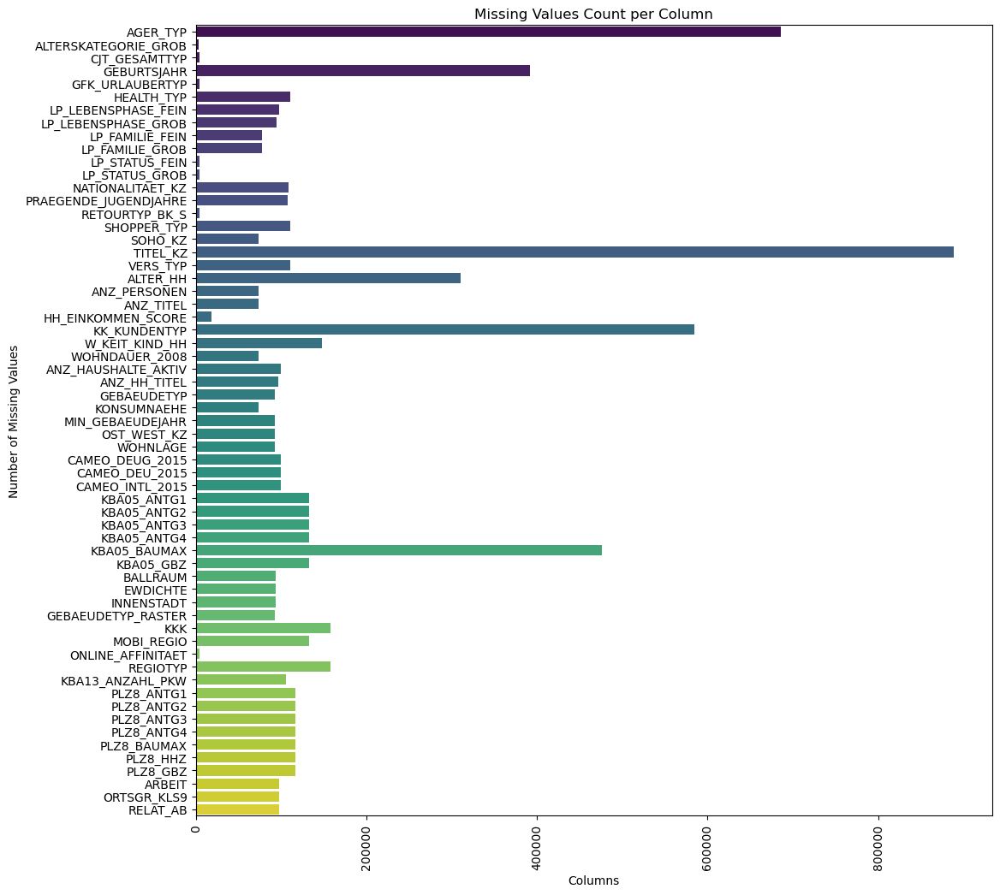

In [36]:

plt.figure(figsize=(12, 12))
sns.barplot(data=data, x="null_values", y="column", palette="viridis")

plt.xticks(rotation=90)
plt.xlabel("Columns")
plt.ylabel("Number of Missing Values")
plt.title("Missing Values Count per Column")
plt.show()

### Outliers

In [37]:
numeric_population = population.select_dtypes(include=[np.number])

In [38]:
numeric_population.head(10)

,AGER_TYP,ALTERSKATEGORIE_GROB,ANREDE_KZ,CJT_GESAMTTYP,FINANZ_MINIMALIST,FINANZ_SPARER,FINANZ_VORSORGER,FINANZ_ANLEGER,FINANZ_UNAUFFAELLIGER,FINANZ_HAUSBAUER,FINANZTYP,GEBURTSJAHR,GFK_URLAUBERTYP,GREEN_AVANTGARDE,HEALTH_TYP,LP_LEBENSPHASE_FEIN,LP_LEBENSPHASE_GROB,LP_FAMILIE_FEIN,LP_FAMILIE_GROB,LP_STATUS_FEIN,LP_STATUS_GROB,NATIONALITAET_KZ,PRAEGENDE_JUGENDJAHRE,RETOURTYP_BK_S,SEMIO_SOZ,SEMIO_FAM,SEMIO_REL,SEMIO_MAT,SEMIO_VERT,SEMIO_LUST,SEMIO_ERL,SEMIO_KULT,SEMIO_RAT,SEMIO_KRIT,SEMIO_DOM,SEMIO_KAEM,SEMIO_PFLICHT,SEMIO_TRADV,SHOPPER_TYP,SOHO_KZ,TITEL_KZ,VERS_TYP,ZABEOTYP,ALTER_HH,ANZ_PERSONEN,ANZ_TITEL,HH_EINKOMMEN_SCORE,KK_KUNDENTYP,W_KEIT_KIND_HH,WOHNDAUER_2008,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,GEBAEUDETYP,KONSUMNAEHE,MIN_GEBAEUDEJAHR,WOHNLAGE,KBA05_ANTG1,KBA05_ANTG2,KBA05_ANTG3,KBA05_ANTG4,KBA05_BAUMAX,KBA05_GBZ,BALLRAUM,EWDICHTE,INNENSTADT,GEBAEUDETYP_RASTER,KKK,MOBI_REGIO,ONLINE_AFFINITAET,REGIOTYP,KBA13_ANZAHL_PKW,PLZ8_ANTG1,PLZ8_ANTG2,PLZ8_ANTG3,PLZ8_ANTG4,PLZ8_BAUMAX,PLZ8_HHZ,PLZ8_GBZ,ARBEIT,ORTSGR_KLS9,RELAT_AB
0,-1,2,1,2.0,3,4,3,5,5,3,4,0,10.0,0,-1,15.0,4.0,2.0,2.0,1.0,1.0,0,0,5.0,2,6,7,5,1,5,3,3,4,7,6,6,5,3,-1,NaN,NaN,-1,3,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,-1,1,2,5.0,1,5,2,5,4,5,1,1996,10.0,0,3,21.0,6.0,5.0,3.0,2.0,1.0,1,14,1.0,5,4,4,3,1,2,2,3,6,4,7,4,7,6,3,1.0,0.0,2,5,0.0,2.0,0.0,6.0,NaN,3.0,9.0,11.0,0.0,8.0,1.0,1992.0,4.0,0.0,0.0,0.0,2.0,5.0,1.0,6.0,3.0,8.0,3.0,2.0,1.0,3.0,3.0,963.0,2.0,3.0,2.0,1.0,1.0,5.0,4.0,3.0,5.0,4.0
2,-1,3,2,3.0,1,4,1,2,3,5,1,1979,10.0,1,3,3.0,1.0,1.0,1.0,3.0,2.0,1,15,3.0,4,1,3,3,4,4,6,3,4,7,7,7,3,3,2,0.0,0.0,1,5,17.0,1.0,0.0,4.0,NaN,3.0,9.0,10.0,0.0,1.0,5.0,1992.0,2.0,1.0,3.0,1.0,0.0,0.0,3.0,2.0,4.0,4.0,4.0,2.0,3.0,2.0,2.0,712.0,3.0,3.0,1.0,0.0,1.0,4.0,4.0,3.0,5.0,2.0
3,2,4,2,2.0,4,2,5,2,1,2,6,1957,1.0,0,2,0.0,0.0,0.0,0.0,9.0,4.0,1,8,2.0,5,1,2,1,4,4,7,4,3,4,4,5,4,4,1,0.0,0.0,1,3,13.0,0.0,0.0,1.0,NaN,NaN,9.0,1.0,0.0,1.0,4.0,1997.0,7.0,4.0,1.0,0.0,0.0,1.0,4.0,4.0,2.0,6.0,4.0,0.0,4.0,1.0,0.0,596.0,2.0,2.0,2.0,0.0,1.0,3.0,4.0,2.0,3.0,3.0
4,-1,3,1,5.0,4,3,4,1,3,2,5,1963,5.0,0,3,32.0,10.0,10.0,5.0,3.0,2.0,1,8,5.0,6,4,4,2,7,4,4,6,2,3,2,2,4,2,2,0.0,0.0,2,4,20.0,4.0,0.0,5.0,1.0,2.0,9.0,3.0,0.0,1.0,4.0,1992.0,3.0,1.0,4.0,1.0,0.0,0.0,3.0,2.0,5.0,1.0,5.0,3.0,3.0,5.0,5.0,435.0,2.0,4.0,2.0,1.0,2.0,3.0,3.0,4.0,6.0,5.0
5,3,1,2,2.0,3,1,5,2,2,5,2,1943,1.0,0,3,8.0,2.0,1.0,1.0,4.0,2.0,1,3,3.0,2,4,7,4,2,2,2,5,7,4,4,4,7,6,0,0.0,0.0,2,4,10.0,1.0,0.0,5.0,3.0,6.0,9.0,5.0,0.0,1.0,5.0,1992.0,7.0,2.0,2.0,0.0,0.0,0.0,4.0,6.0,2.0,7.0,4.0,4.0,4.0,1.0,5.0,1300.0,2.0,3.0,1.0,1.0,1.0,5.0,5.0,2.0,3.0,3.0
6,-1,2,2,5.0,1,5,1,5,4,3,4,0,12.0,0,2,2.0,1.0,1.0,1.0,2.0,1.0,1,10,4.0,2,5,5,7,2,6,5,5,7,7,4,7,7,7,1,0.0,0.0,1,4,0.0,1.0,0.0,6.0,NaN,3.0,9.0,4.0,0.0,1.0,5.0,1992.0,5.0,3.0,2.0,0.0,0.0,1.0,3.0,6.0,4.0,3.0,5.0,3.0,5.0,2.0,5.0,867.0,3.0,3.0,1.0,0.0,1.0,5.0,5.0,4.0,6.0,3.0
7,-1,1,1,3.0,3,3,4,1,3,2,5,1964,9.0,0,1,5.0,2.0,1.0,1.0,1.0,1.0,1,8,5.0,7,7,7,5,6,2,2,7,5,1,1,2,5,5,0,0.0,0.0,1,1,14.0,1.0,0.0,4.0,NaN,5.0,9.0,6.0,0.0,8.0,3.0,1992.0,1.0,2.0,2.0,0.0,0.0,0.0,4.0,2.0,5.0,3.0,4.0,1.0,4.0,1.0,1.0,758.0,3.0,3.0,1.0,0.0,1.0,4.0,4.0,2.0,5.0,2.0
8,-1,3,1,3.0,4,4,2,4,2,2,6,1974,3.0,1,3,10.0,3.0,1.0,1.0,10.0,5.0,1,11,4.0,4,5,4,1,5,6,4,5,2,5,5,3,1,4,3,0.0,0.0,2,6,16.0,1.0,0.0,3.0,NaN,5.0,8.0,2.0,1.0,3.0,4.0,1992.0,1.0,1.0,1.0,0.0,0.0,0.0,5.0,3.0,4.0,4.0,4.0,1.0,3.0,2.0,3.0,511.0,2.0,3.0,2.0,1.0,1.0,3.0,3.0,2.0,4.0,3.0
9,-1,3,2,4.0,2,4,2,3,5,4,1,1975,12.0,1,2,4.0,1.0,1.0,1.0,3.0,2.0,1,15,4.0,2,1,1,3,2,6,6,3,4,7,6,7,1,3,3,0.0,0.0,2,4,17.0,1.0,0.0,4.0,6.0,4.0,3.0,9.0,0.0,3.0,4.0,1992.0,7.0,1.0,3.0,1.0,0.0,0.0,2.0,6.0,5.0,4.0,3.0,1.0,3.0,3.0,1.0,530.0,2.0,3.0,2.0,1.0,1.0,3.0,3.0,2.0,3.0,1.0


In [39]:
numeric_population.shape

(891221, 81)

In [40]:
population.shape

(891221, 85)

#### Visualize Outliers using Box plot

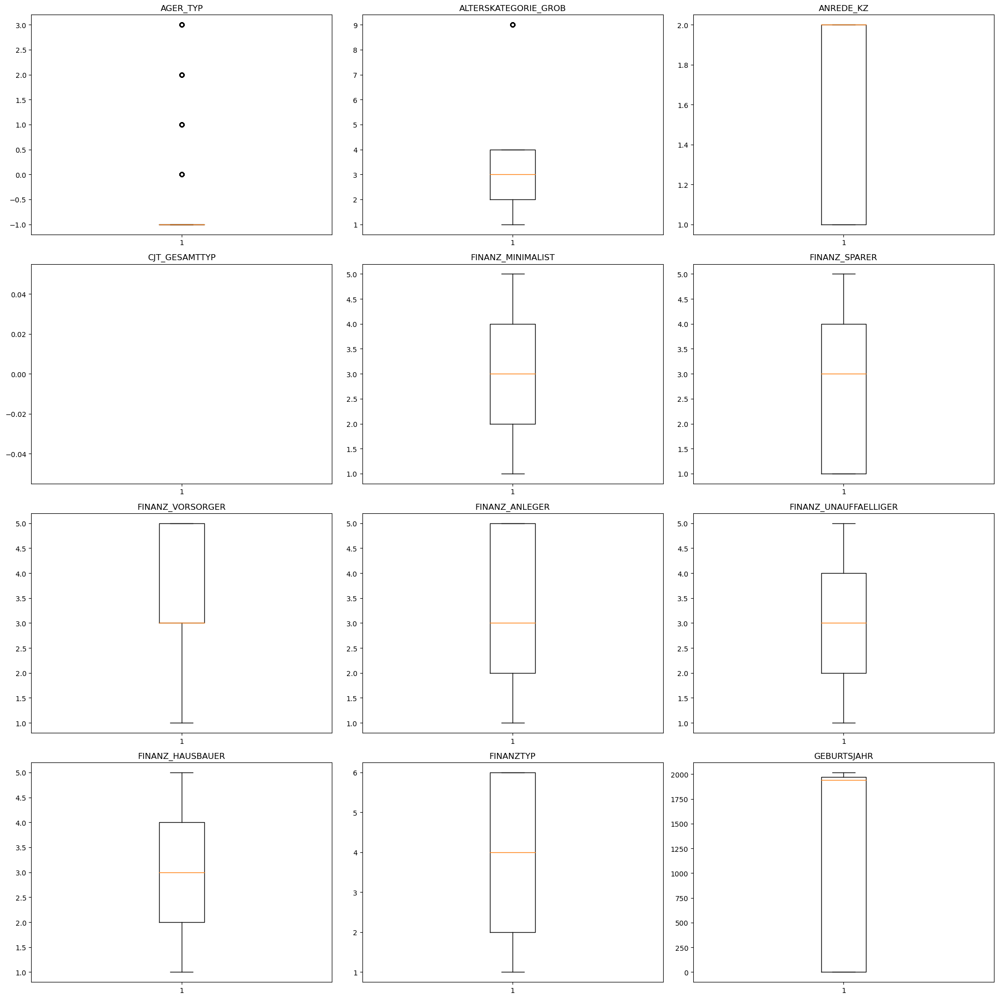

In [41]:
box_plot_matrex(numeric_population.iloc[:, 0:12]  )

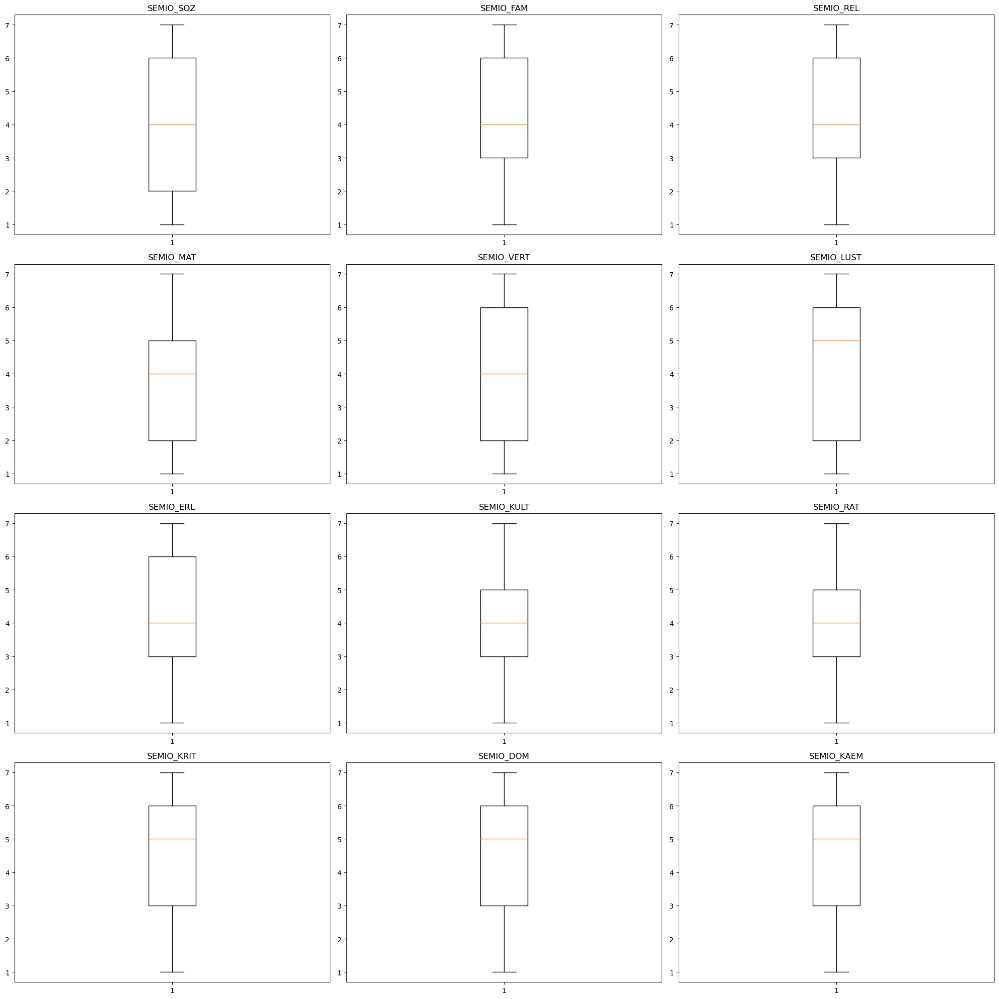

In [42]:
box_plot_matrex(numeric_population.iloc[:, 24:36])

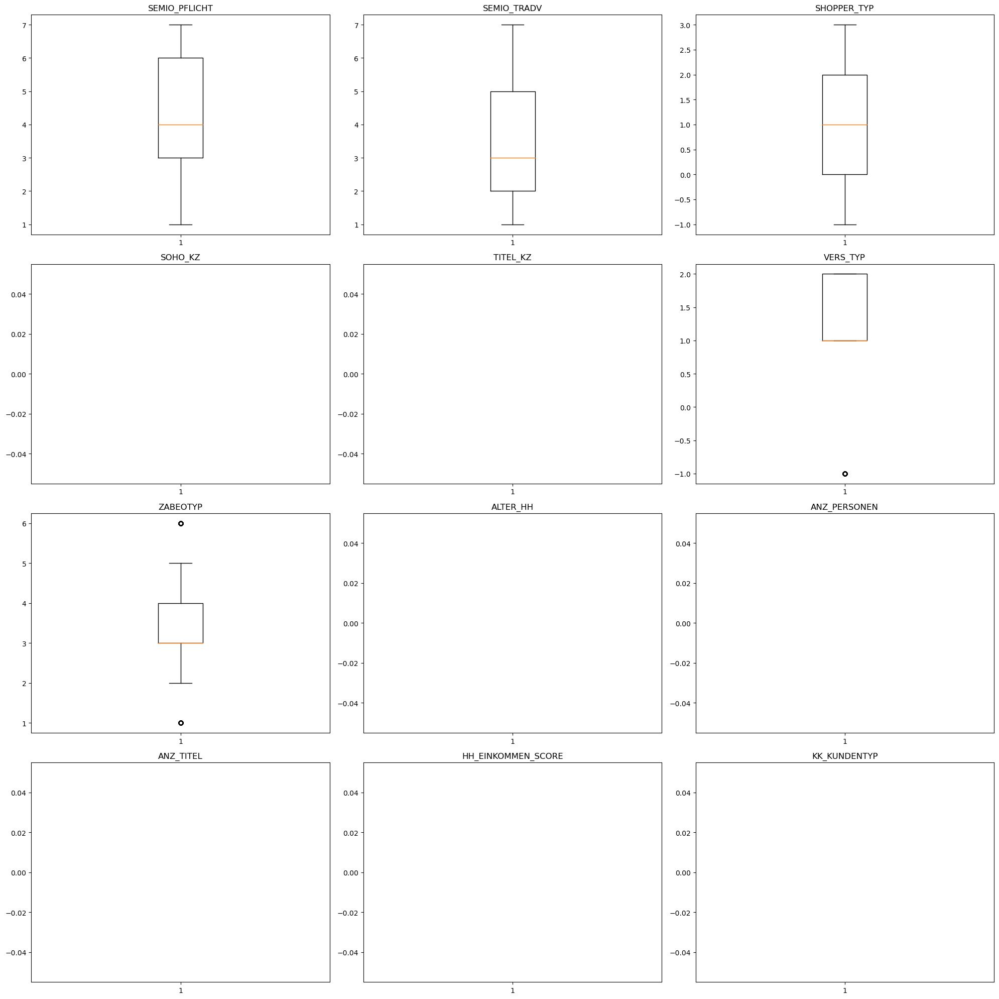

In [43]:
box_plot_matrex(numeric_population.iloc[:, 36:48])

### remove outliers 

In [44]:
cleaned_data = remove_outliers(population)


**************************************************
Start Removing Outliers

**************************************************


test if the values are removed for the first 12 column

In [45]:
cleaned_data.head(10)


,AGER_TYP,ALTERSKATEGORIE_GROB,ANREDE_KZ,CJT_GESAMTTYP,FINANZ_MINIMALIST,FINANZ_SPARER,FINANZ_VORSORGER,FINANZ_ANLEGER,FINANZ_UNAUFFAELLIGER,FINANZ_HAUSBAUER,FINANZTYP,GEBURTSJAHR,GFK_URLAUBERTYP,GREEN_AVANTGARDE,HEALTH_TYP,LP_LEBENSPHASE_FEIN,LP_LEBENSPHASE_GROB,LP_FAMILIE_FEIN,LP_FAMILIE_GROB,LP_STATUS_FEIN,LP_STATUS_GROB,NATIONALITAET_KZ,PRAEGENDE_JUGENDJAHRE,RETOURTYP_BK_S,SEMIO_SOZ,SEMIO_FAM,SEMIO_REL,SEMIO_MAT,SEMIO_VERT,SEMIO_LUST,SEMIO_ERL,SEMIO_KULT,SEMIO_RAT,SEMIO_KRIT,SEMIO_DOM,SEMIO_KAEM,SEMIO_PFLICHT,SEMIO_TRADV,SHOPPER_TYP,SOHO_KZ,TITEL_KZ,VERS_TYP,ZABEOTYP,ALTER_HH,ANZ_PERSONEN,ANZ_TITEL,HH_EINKOMMEN_SCORE,KK_KUNDENTYP,W_KEIT_KIND_HH,WOHNDAUER_2008,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,GEBAEUDETYP,KONSUMNAEHE,MIN_GEBAEUDEJAHR,OST_WEST_KZ,WOHNLAGE,CAMEO_DEUG_2015,CAMEO_DEU_2015,CAMEO_INTL_2015,KBA05_ANTG1,KBA05_ANTG2,KBA05_ANTG3,KBA05_ANTG4,KBA05_BAUMAX,KBA05_GBZ,BALLRAUM,EWDICHTE,INNENSTADT,GEBAEUDETYP_RASTER,KKK,MOBI_REGIO,ONLINE_AFFINITAET,REGIOTYP,KBA13_ANZAHL_PKW,PLZ8_ANTG1,PLZ8_ANTG2,PLZ8_ANTG3,PLZ8_ANTG4,PLZ8_BAUMAX,PLZ8_HHZ,PLZ8_GBZ,ARBEIT,ORTSGR_KLS9,RELAT_AB
0,-1.0,2.0,1,2.0,3,4,3,5,5,3,4,0,10.0,0.0,-1,15.0,4.0,2.0,2.0,1.0,1.0,NaN,0,5.0,2,6,7,5,1,5,3,3,4,7,6,6,5,3,-1,NaN,NaN,NaN,3.0,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,-1.0,1.0,2,5.0,1,5,2,5,4,5,1,1996,10.0,0.0,3,21.0,6.0,5.0,3.0,2.0,1.0,1.0,14,1.0,5,4,4,3,1,2,2,3,6,4,7,4,7,6,3,NaN,0.0,2.0,5.0,0.0,2.0,0.0,6.0,NaN,3.0,9.0,11.0,0.0,NaN,1.0,1992.0,W,4.0,8,8A,51,0.0,0.0,0.0,NaN,5.0,1.0,6.0,3.0,8.0,3.0,2.0,1.0,3.0,3.0,963.0,2.0,3.0,2.0,1.0,1.0,5.0,4.0,3.0,5.0,4.0
2,-1.0,3.0,2,3.0,1,4,1,2,3,5,1,1979,10.0,NaN,3,3.0,1.0,1.0,1.0,3.0,2.0,1.0,15,3.0,4,1,3,3,4,4,6,3,4,7,7,7,3,3,2,0.0,0.0,1.0,5.0,17.0,1.0,0.0,4.0,NaN,3.0,9.0,10.0,0.0,1.0,5.0,1992.0,W,2.0,4,4C,24,1.0,3.0,1.0,0.0,0.0,3.0,2.0,4.0,4.0,4.0,2.0,3.0,2.0,2.0,712.0,3.0,3.0,1.0,0.0,1.0,4.0,4.0,3.0,5.0,2.0
3,NaN,4.0,2,2.0,4,2,5,2,1,2,6,1957,1.0,0.0,2,0.0,0.0,0.0,0.0,9.0,4.0,1.0,8,2.0,5,1,2,1,4,4,7,4,3,4,4,5,4,4,1,0.0,0.0,1.0,3.0,13.0,0.0,0.0,1.0,NaN,NaN,9.0,1.0,0.0,1.0,4.0,NaN,W,7.0,2,2A,12,4.0,1.0,0.0,0.0,1.0,4.0,4.0,2.0,6.0,4.0,NaN,4.0,1.0,0.0,596.0,2.0,2.0,2.0,0.0,1.0,3.0,4.0,2.0,3.0,3.0
4,-1.0,3.0,1,5.0,4,3,4,1,3,2,5,1963,5.0,0.0,3,32.0,10.0,10.0,5.0,3.0,2.0,1.0,8,5.0,6,4,4,2,7,4,4,6,2,3,2,2,4,2,2,0.0,0.0,2.0,4.0,20.0,NaN,0.0,5.0,1.0,2.0,9.0,3.0,0.0,1.0,4.0,1992.0,W,3.0,6,6B,43,1.0,4.0,1.0,0.0,0.0,3.0,2.0,5.0,1.0,5.0,3.0,3.0,5.0,5.0,435.0,2.0,4.0,2.0,1.0,2.0,3.0,3.0,4.0,6.0,5.0
5,NaN,1.0,2,2.0,3,1,5,2,2,5,2,1943,1.0,0.0,3,8.0,2.0,1.0,1.0,4.0,2.0,1.0,3,3.0,2,4,7,4,2,2,2,5,7,4,4,4,7,6,0,0.0,0.0,2.0,4.0,10.0,1.0,0.0,5.0,3.0,6.0,9.0,5.0,0.0,1.0,5.0,1992.0,W,7.0,8,8C,54,2.0,2.0,0.0,0.0,0.0,4.0,6.0,2.0,7.0,4.0,4.0,4.0,1.0,5.0,1300.0,2.0,3.0,1.0,1.0,1.0,5.0,5.0,2.0,3.0,3.0
6,-1.0,2.0,2,5.0,1,5,1,5,4,3,4,0,12.0,0.0,2,2.0,1.0,1.0,1.0,2.0,1.0,1.0,10,4.0,2,5,5,7,2,6,5,5,7,7,4,7,7,7,1,0.0,0.0,1.0,4.0,0.0,1.0,0.0,6.0,NaN,3.0,9.0,4.0,0.0,1.0,5.0,1992.0,W,5.0,4,4A,22,3.0,2.0,0.0,0.0,1.0,3.0,6.0,4.0,3.0,5.0,3.0,5.0,2.0,5.0,867.0,3.0,3.0,1.0,0.0,1.0,5.0,5.0,4.0,6.0,3.0
7,-1.0,1.0,1,3.0,3,3,4,1,3,2,5,1964,9.0,0.0,1,5.0,2.0,1.0,1.0,1.0,1.0,1.0,8,5.0,7,7,7,5,6,2,2,7,5,1,1,2,5,5,0,0.0,0.0,1.0,NaN,14.0,1.0,0.0,4.0,NaN,5.0,9.0,6.0,0.0,NaN,3.0,1992.0,W,1.0,2,2D,14,2.0,2.0,0.0,0.0,0.0,4.0,2.0,5.0,3.0,4.0,1.0,4.0,1.0,1.0,758.0,3.0,3.0,1.0,0.0,1.0,4.0,4.0,2.0,5.0,2.0
8,-1.0,3.0,1,3.0,4,4,2,4,2,2,6,1974,3.0,NaN,3,10.0,3.0,1.0,1.0,10.0,5.0,1.0,11,4.0,4,5,4,1,5,6,4,5,2,5,5,3,1,4,3,0.0,0.0,2.0,NaN,16.0,1.0,0.0,3.0,NaN,5.0,8.0,2.0,NaN,3.0,4.0,1992.0,W,1.0,1,1A,13,1.0,1.0,0.0,0.0,0.0,5.0,3.0,4.0,4.0,4.0,1.0,3.0,2.0,3.0,511.0,2.0,3.0,2.0,1.0,1.0,3.0,3.0,2.0,4.0,3.0
9,-1.0,3.0,2,4.0,2,4,2,3,5,4,1,1975,12.0,NaN,2,4.0,1.0,1.0,1.0,3.0,2.0,1.0,15,4.0,2,1,1,3,2,6,6,3,4,7,6,7,1,3,3,0.0,0.0,2.0,4.0,17.0,1.0,0.0,4.0,6.0,4.0,NaN,9.0,0.0,3.0,4.0,1992.0,W,7.0,1,1E,15,1.0,3.0,1.0,0.0,0.0,2.0,6.0,5.0,4.0,3.0,1.0,3.0,3.0,1.0,530

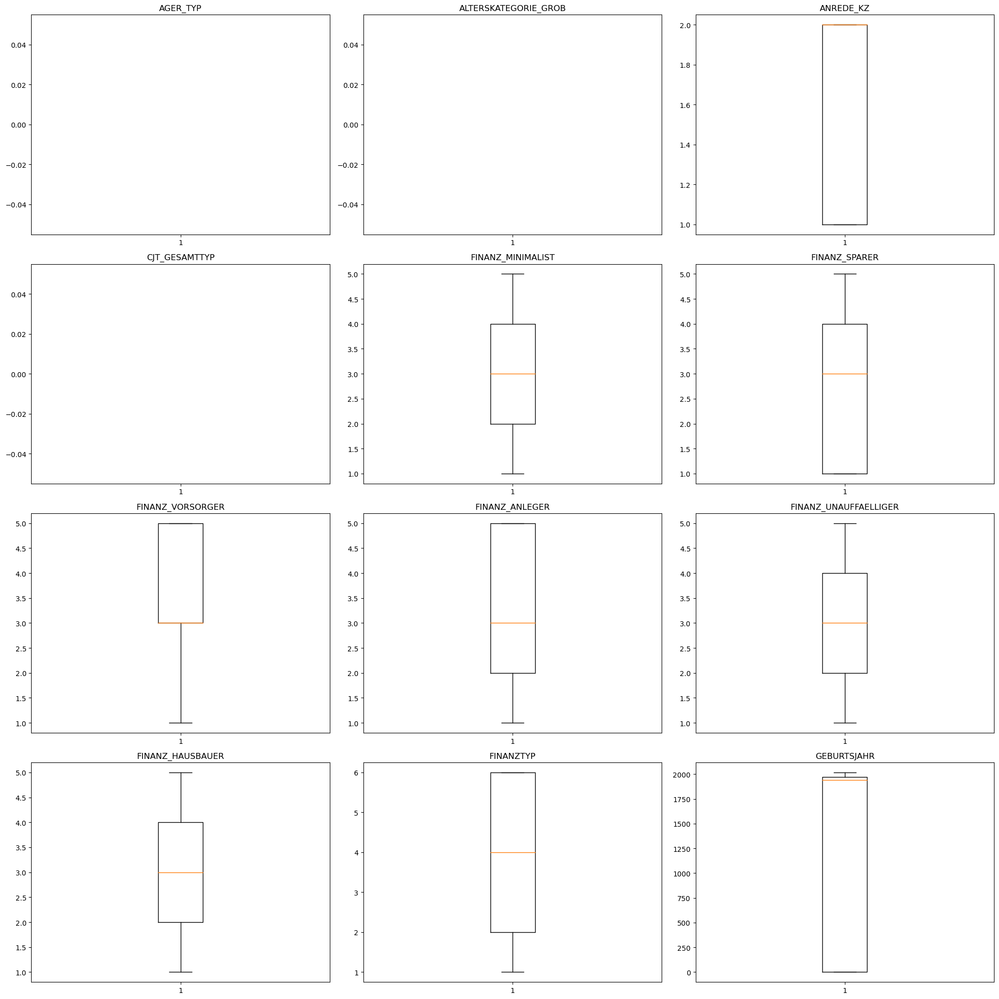

In [46]:
numeric_columns = cleaned_data.select_dtypes(include=['number']).columns
box_plot_matrex(cleaned_data[numeric_columns].iloc[:, 0:12])

### Distribution of Unknown values

### Missing Data Pattern 

In [47]:
# Perform an assessment of how much missing data there is in each column of the
# dataset.
cleaned_data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 891221 entries, 0 to 891220
Data columns (total 85 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   AGER_TYP               677503 non-null  float64
 1   ALTERSKATEGORIE_GROB   888340 non-null  float64
 2   ANREDE_KZ              891221 non-null  int64  
 3   CJT_GESAMTTYP          886367 non-null  float64
 4   FINANZ_MINIMALIST      891221 non-null  int64  
 5   FINANZ_SPARER          891221 non-null  int64  
 6   FINANZ_VORSORGER       891221 non-null  int64  
 7   FINANZ_ANLEGER         891221 non-null  int64  
 8   FINANZ_UNAUFFAELLIGER  891221 non-null  int64  
 9   FINANZ_HAUSBAUER       891221 non-null  int64  
 10  FINANZTYP              891221 non-null  int64  
 11  GEBURTSJAHR            891221 non-null  int64  
 12  GFK_URLAUBERTYP        886367 non-null  float64
 13  GREEN_AVANTGARDE       715996 non-null  float64
 14  HEALTH_TYP             891221 non-nu

In [48]:
count_nan_values(cleaned_data, 0)

AGER_TYP has 213718 NAN values = %23.980359529230125
ALTERSKATEGORIE_GROB has 2881 NAN values = %0.32326437550282144
ANREDE_KZ has 0 NAN values = %0.0
CJT_GESAMTTYP has 4854 NAN values = %0.5446460529992
FINANZ_MINIMALIST has 0 NAN values = %0.0
FINANZ_SPARER has 0 NAN values = %0.0
FINANZ_VORSORGER has 0 NAN values = %0.0
FINANZ_ANLEGER has 0 NAN values = %0.0
FINANZ_UNAUFFAELLIGER has 0 NAN values = %0.0
FINANZ_HAUSBAUER has 0 NAN values = %0.0
FINANZTYP has 0 NAN values = %0.0
GEBURTSJAHR has 0 NAN values = %0.0
GFK_URLAUBERTYP has 4854 NAN values = %0.5446460529992
GREEN_AVANTGARDE has 175225 NAN values = %19.661228808567124
HEALTH_TYP has 0 NAN values = %0.0
LP_LEBENSPHASE_FEIN has 4854 NAN values = %0.5446460529992
LP_LEBENSPHASE_GROB has 4854 NAN values = %0.5446460529992
LP_FAMILIE_FEIN has 4854 NAN values = %0.5446460529992
LP_FAMILIE_GROB has 4854 NAN values = %0.5446460529992
LP_STATUS_FEIN has 4854 NAN values = %0.5446460529992
LP_STATUS_GROB has 4854 NAN values = %0.544646

['AGER_TYP',
 'ALTERSKATEGORIE_GROB',
 'ANREDE_KZ',
 'CJT_GESAMTTYP',
 'FINANZ_MINIMALIST',
 'FINANZ_SPARER',
 'FINANZ_VORSORGER',
 'FINANZ_ANLEGER',
 'FINANZ_UNAUFFAELLIGER',
 'FINANZ_HAUSBAUER',
 'FINANZTYP',
 'GEBURTSJAHR',
 'GFK_URLAUBERTYP',
 'GREEN_AVANTGARDE',
 'HEALTH_TYP',
 'LP_LEBENSPHASE_FEIN',
 'LP_LEBENSPHASE_GROB',
 'LP_FAMILIE_FEIN',
 'LP_FAMILIE_GROB',
 'LP_STATUS_FEIN',
 'LP_STATUS_GROB',
 'NATIONALITAET_KZ',
 'PRAEGENDE_JUGENDJAHRE',
 'RETOURTYP_BK_S',
 'SEMIO_SOZ',
 'SEMIO_FAM',
 'SEMIO_REL',
 'SEMIO_MAT',
 'SEMIO_VERT',
 'SEMIO_LUST',
 'SEMIO_ERL',
 'SEMIO_KULT',
 'SEMIO_RAT',
 'SEMIO_KRIT',
 'SEMIO_DOM',
 'SEMIO_KAEM',
 'SEMIO_PFLICHT',
 'SEMIO_TRADV',
 'SHOPPER_TYP',
 'SOHO_KZ',
 'TITEL_KZ',
 'VERS_TYP',
 'ZABEOTYP',
 'ALTER_HH',
 'ANZ_PERSONEN',
 'ANZ_TITEL',
 'HH_EINKOMMEN_SCORE',
 'KK_KUNDENTYP',
 'W_KEIT_KIND_HH',
 'WOHNDAUER_2008',
 'ANZ_HAUSHALTE_AKTIV',
 'ANZ_HH_TITEL',
 'GEBAEUDETYP',
 'KONSUMNAEHE',
 'MIN_GEBAEUDEJAHR',
 'OST_WEST_KZ',
 'WOHNLAGE',
 'CAME

In [49]:
cleaned_data.shape

(891221, 85)

#### Discussion 1.1.2: Assess Missing Data in Each Column

After replacing the unknown values and outliers with nan, we can find that the following columns have more than 35% nan values: 

AGER_TYP has 685843 NAN values = %76.95

GEBURTSJAHR has 392591 NAN values = %44.05

TITEL_KZ has 889274 NAN values = %99.78

ALTER_HH has 312148 NAN values = %35.02

KK_KUNDENTYP has 584612 NAN values = %65.59

KBA05_BAUMAX has 476524 NAN values = %53.46


#### Step 1.1.3: Assess Missing Data in Each Row

Now, you'll perform a similar assessment for the rows of the dataset. How much data is missing in each row? As with the columns, you should see some groups of points that have a very different numbers of missing values. Divide the data into two subsets: one for data points that are above some threshold for missing values, and a second subset for points below that threshold.

In order to know what to do with the outlier rows, we should see if the distribution of data values on columns that are not missing data (or are missing very little data) are similar or different between the two groups. Select at least five of these columns and compare the distribution of values.
- You can use seaborn's [`countplot()`](https://seaborn.pydata.org/generated/seaborn.countplot.html) function to create a bar chart of code frequencies and matplotlib's [`subplot()`](https://matplotlib.org/api/_as_gen/matplotlib.pyplot.subplot.html) function to put bar charts for the two subplots side by side.
- To reduce repeated code, you might want to write a function that can perform this comparison, taking as one of its arguments a column to be compared.

Depending on what you observe in your comparison, this will have implications on how you approach your conclusions later in the analysis. If the distributions of non-missing features look similar between the data with many missing values and the data with few or no missing values, then we could argue that simply dropping those points from the analysis won't present a major issue. On the other hand, if the data with many missing values looks very different from the data with few or no missing values, then we should make a note on those data as special. We'll revisit these data later on. **Either way, you should continue your analysis for now using just the subset of the data with few or no missing values.**

In [50]:
# How much data is missing in each row of the dataset?
null_rows_count = cleaned_data.isna().sum(axis=1).sort_values(ascending=True)

In [51]:
null_rows_count

328116     0
433278     0
203356     0
844117     0
433325     0
203334     0
203327     0
433334     0
433340     0
768576     0
27228      0
631164     0
433365     0
203266     0
768614     0
433414     0
433423     0
433437     0
203224     0
27199      0
27195      0
631080     0
631217     0
433515     0
203377     0
27265      0
631416     0
432960     0
203547     0
203520     0
27310      0
433029     0
631355     0
631344     0
631337     0
203484     0
78474      0
433114     0
433116     0
433131     0
203425     0
631312     0
631289     0
78483      0
433190     0
203393     0
203391     0
631252     0
844095     0
844090     0
27177      0
433846     0
27114      0
78606      0
630871     0
433913     0
630867     0
630866     0
202830     0
27090      0
202829     0
433986     0
202803     0
630832     0
875201     0
202798     0
434023     0
434024     0
434063     0
202748     0
434071     0
630802     0
630914     0
630923     0
202918     0
433796     0
203085     0

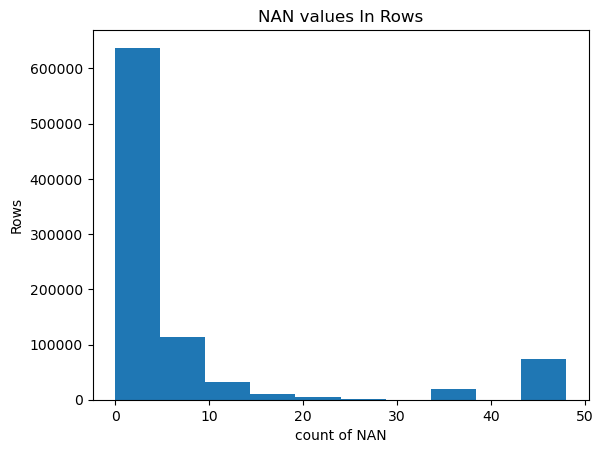

In [52]:
plot_hist(null_rows_count,'NAN values In Rows','count of NAN','Rows')

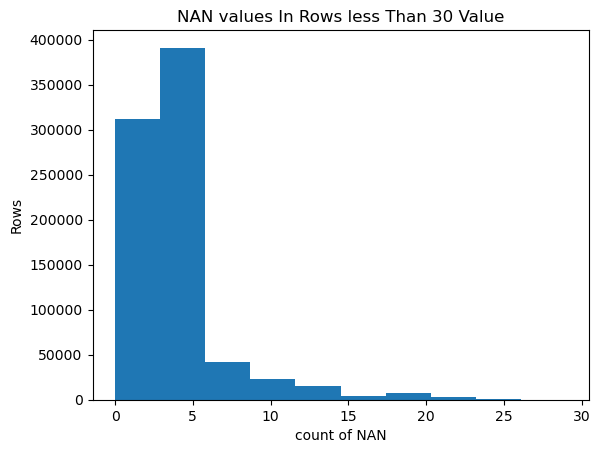

In [53]:
plot_hist(null_rows_count[null_rows_count<30],'NAN values In Rows less Than 30 Value','count of NAN','Rows')

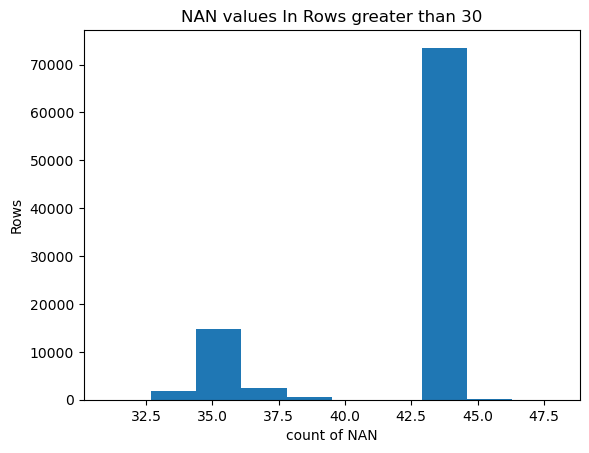

In [54]:
plot_hist(null_rows_count[null_rows_count>30],'NAN values In Rows greater than 30','count of NAN','Rows')

In [55]:
# remove the rows that have more than 30 null value (~half of the data is null)
data_NAN_less_30 = cleaned_data[null_rows_count<30]

C:\Users\User\AppData\Local\Temp\ipykernel_2316\683475980.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  data_NAN_less_30 = cleaned_data[null_rows_count<30]


In [56]:
data_NAN_less_30.shape

(798023, 85)

In [57]:
data_NAN_less_30.head(10)

,AGER_TYP,ALTERSKATEGORIE_GROB,ANREDE_KZ,CJT_GESAMTTYP,FINANZ_MINIMALIST,FINANZ_SPARER,FINANZ_VORSORGER,FINANZ_ANLEGER,FINANZ_UNAUFFAELLIGER,FINANZ_HAUSBAUER,FINANZTYP,GEBURTSJAHR,GFK_URLAUBERTYP,GREEN_AVANTGARDE,HEALTH_TYP,LP_LEBENSPHASE_FEIN,LP_LEBENSPHASE_GROB,LP_FAMILIE_FEIN,LP_FAMILIE_GROB,LP_STATUS_FEIN,LP_STATUS_GROB,NATIONALITAET_KZ,PRAEGENDE_JUGENDJAHRE,RETOURTYP_BK_S,SEMIO_SOZ,SEMIO_FAM,SEMIO_REL,SEMIO_MAT,SEMIO_VERT,SEMIO_LUST,SEMIO_ERL,SEMIO_KULT,SEMIO_RAT,SEMIO_KRIT,SEMIO_DOM,SEMIO_KAEM,SEMIO_PFLICHT,SEMIO_TRADV,SHOPPER_TYP,SOHO_KZ,TITEL_KZ,VERS_TYP,ZABEOTYP,ALTER_HH,ANZ_PERSONEN,ANZ_TITEL,HH_EINKOMMEN_SCORE,KK_KUNDENTYP,W_KEIT_KIND_HH,WOHNDAUER_2008,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,GEBAEUDETYP,KONSUMNAEHE,MIN_GEBAEUDEJAHR,OST_WEST_KZ,WOHNLAGE,CAMEO_DEUG_2015,CAMEO_DEU_2015,CAMEO_INTL_2015,KBA05_ANTG1,KBA05_ANTG2,KBA05_ANTG3,KBA05_ANTG4,KBA05_BAUMAX,KBA05_GBZ,BALLRAUM,EWDICHTE,INNENSTADT,GEBAEUDETYP_RASTER,KKK,MOBI_REGIO,ONLINE_AFFINITAET,REGIOTYP,KBA13_ANZAHL_PKW,PLZ8_ANTG1,PLZ8_ANTG2,PLZ8_ANTG3,PLZ8_ANTG4,PLZ8_BAUMAX,PLZ8_HHZ,PLZ8_GBZ,ARBEIT,ORTSGR_KLS9,RELAT_AB
1,-1.0,1.0,2,5.0,1,5,2,5,4,5,1,1996,10.0,0.0,3,21.0,6.0,5.0,3.0,2.0,1.0,1.0,14,1.0,5,4,4,3,1,2,2,3,6,4,7,4,7,6,3,NaN,0.0,2.0,5.0,0.0,2.0,0.0,6.0,NaN,3.0,9.0,11.0,0.0,NaN,1.0,1992.0,W,4.0,8,8A,51,0.0,0.0,0.0,NaN,5.0,1.0,6.0,3.0,8.0,3.0,2.0,1.0,3.0,3.0,963.0,2.0,3.0,2.0,1.0,1.0,5.0,4.0,3.0,5.0,4.0
2,-1.0,3.0,2,3.0,1,4,1,2,3,5,1,1979,10.0,NaN,3,3.0,1.0,1.0,1.0,3.0,2.0,1.0,15,3.0,4,1,3,3,4,4,6,3,4,7,7,7,3,3,2,0.0,0.0,1.0,5.0,17.0,1.0,0.0,4.0,NaN,3.0,9.0,10.0,0.0,1.0,5.0,1992.0,W,2.0,4,4C,24,1.0,3.0,1.0,0.0,0.0,3.0,2.0,4.0,4.0,4.0,2.0,3.0,2.0,2.0,712.0,3.0,3.0,1.0,0.0,1.0,4.0,4.0,3.0,5.0,2.0
3,NaN,4.0,2,2.0,4,2,5,2,1,2,6,1957,1.0,0.0,2,0.0,0.0,0.0,0.0,9.0,4.0,1.0,8,2.0,5,1,2,1,4,4,7,4,3,4,4,5,4,4,1,0.0,0.0,1.0,3.0,13.0,0.0,0.0,1.0,NaN,NaN,9.0,1.0,0.0,1.0,4.0,NaN,W,7.0,2,2A,12,4.0,1.0,0.0,0.0,1.0,4.0,4.0,2.0,6.0,4.0,NaN,4.0,1.0,0.0,596.0,2.0,2.0,2.0,0.0,1.0,3.0,4.0,2.0,3.0,3.0
4,-1.0,3.0,1,5.0,4,3,4,1,3,2,5,1963,5.0,0.0,3,32.0,10.0,10.0,5.0,3.0,2.0,1.0,8,5.0,6,4,4,2,7,4,4,6,2,3,2,2,4,2,2,0.0,0.0,2.0,4.0,20.0,NaN,0.0,5.0,1.0,2.0,9.0,3.0,0.0,1.0,4.0,1992.0,W,3.0,6,6B,43,1.0,4.0,1.0,0.0,0.0,3.0,2.0,5.0,1.0,5.0,3.0,3.0,5.0,5.0,435.0,2.0,4.0,2.0,1.0,2.0,3.0,3.0,4.0,6.0,5.0
5,NaN,1.0,2,2.0,3,1,5,2,2,5,2,1943,1.0,0.0,3,8.0,2.0,1.0,1.0,4.0,2.0,1.0,3,3.0,2,4,7,4,2,2,2,5,7,4,4,4,7,6,0,0.0,0.0,2.0,4.0,10.0,1.0,0.0,5.0,3.0,6.0,9.0,5.0,0.0,1.0,5.0,1992.0,W,7.0,8,8C,54,2.0,2.0,0.0,0.0,0.0,4.0,6.0,2.0,7.0,4.0,4.0,4.0,1.0,5.0,1300.0,2.0,3.0,1.0,1.0,1.0,5.0,5.0,2.0,3.0,3.0
6,-1.0,2.0,2,5.0,1,5,1,5,4,3,4,0,12.0,0.0,2,2.0,1.0,1.0,1.0,2.0,1.0,1.0,10,4.0,2,5,5,7,2,6,5,5,7,7,4,7,7,7,1,0.0,0.0,1.0,4.0,0.0,1.0,0.0,6.0,NaN,3.0,9.0,4.0,0.0,1.0,5.0,1992.0,W,5.0,4,4A,22,3.0,2.0,0.0,0.0,1.0,3.0,6.0,4.0,3.0,5.0,3.0,5.0,2.0,5.0,867.0,3.0,3.0,1.0,0.0,1.0,5.0,5.0,4.0,6.0,3.0
7,-1.0,1.0,1,3.0,3,3,4,1,3,2,5,1964,9.0,0.0,1,5.0,2.0,1.0,1.0,1.0,1.0,1.0,8,5.0,7,7,7,5,6,2,2,7,5,1,1,2,5,5,0,0.0,0.0,1.0,NaN,14.0,1.0,0.0,4.0,NaN,5.0,9.0,6.0,0.0,NaN,3.0,1992.0,W,1.0,2,2D,14,2.0,2.0,0.0,0.0,0.0,4.0,2.0,5.0,3.0,4.0,1.0,4.0,1.0,1.0,758.0,3.0,3.0,1.0,0.0,1.0,4.0,4.0,2.0,5.0,2.0
8,-1.0,3.0,1,3.0,4,4,2,4,2,2,6,1974,3.0,NaN,3,10.0,3.0,1.0,1.0,10.0,5.0,1.0,11,4.0,4,5,4,1,5,6,4,5,2,5,5,3,1,4,3,0.0,0.0,2.0,NaN,16.0,1.0,0.0,3.0,NaN,5.0,8.0,2.0,NaN,3.0,4.0,1992.0,W,1.0,1,1A,13,1.0,1.0,0.0,0.0,0.0,5.0,3.0,4.0,4.0,4.0,1.0,3.0,2.0,3.0,511.0,2.0,3.0,2.0,1.0,1.0,3.0,3.0,2.0,4.0,3.0
9,-1.0,3.0,2,4.0,2,4,2,3,5,4,1,1975,12.0,NaN,2,4.0,1.0,1.0,1.0,3.0,2.0,1.0,15,4.0,2,1,1,3,2,6,6,3,4,7,6,7,1,3,3,0.0,0.0,2.0,4.0,17.0,1.0,0.0,4.0,6.0,4.0,NaN,9.0,0.0,3.0,4.0,1992.0,W,7.0,1,1E,15,1.0,3.0,1.0,0.0,0.0,2.0,6.0,5.0,4.0,3.0,1.0,3.0,3.0,1.0,530.0,2.0,3.0,2.0,1.0,1.0,3.0,3.0,2.0,3.0,1.0
10,NaN,3.0,2,1.0,2,2,5,3,1,5,6,1941,8.0,0.0,2,6.0,2.0,1.0,1.0,1.0,1.0,1.0,3,5.0,5,2,3,5,5,6,6,1,4,7,4,7,5,3,2,0.0,0.0,2.0,3.0,10.0,1.0,0.0,6.0,NaN,6.0,9.0,6.0,0.0,1.0,4.0,1992.0,W,5.0,9,9D,51,0.0,4.0,1.0,0.0,2.0,2.0,6.0,4.0,4.0,5.0,4.0,1.0,1.0,7.0,424.

In [58]:
data_NAN_less_30.isna().sum(axis=0).sort_values(ascending=False)

KK_KUNDENTYP             498652
AGER_TYP                 208901
KBA05_ANTG4              197852
ZABEOTYP                 194306
GREEN_AVANTGARDE         175214
WOHNDAUER_2008           158519
GEBAEUDETYP              152472
NATIONALITAET_KZ         130130
MIN_GEBAEUDEJAHR         119115
KBA05_ANTG3              113496
ANZ_PERSONEN              68326
KKK                       64874
PLZ8_GBZ                  63917
ARBEIT                    60984
ANZ_HAUSHALTE_AKTIV       58731
KBA13_ANZAHL_PKW          49389
KBA05_ANTG1               40126
KBA05_ANTG2               40126
KBA05_BAUMAX              40126
KBA05_GBZ                 40126
MOBI_REGIO                40126
VERS_TYP                  36723
PLZ8_HHZ                  34262
W_KEIT_KIND_HH            33294
PLZ8_ANTG2                30755
REGIOTYP                  28008
ANZ_HH_TITEL              27826
PLZ8_BAUMAX               23317
PLZ8_ANTG1                23317
PLZ8_ANTG4                23317
PLZ8_ANTG3                23317
GEBAEUDE

In [59]:
# Write code to divide the data into two subsets based on the number of missing
# values in each row.

data_NAN_less_30 = cleaned_data[null_rows_count<30]
data_NAN_greater_30 = cleaned_data[null_rows_count>=30]


C:\Users\User\AppData\Local\Temp\ipykernel_2316\3647028840.py:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  data_NAN_less_30 = cleaned_data[null_rows_count<30]
C:\Users\User\AppData\Local\Temp\ipykernel_2316\3647028840.py:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  data_NAN_greater_30 = cleaned_data[null_rows_count>=30]


In [60]:
common_columns = data_NAN_less_30.columns.intersection(data_NAN_greater_30.columns)
common_columns

Index(['AGER_TYP', 'ALTERSKATEGORIE_GROB', 'ANREDE_KZ', 'CJT_GESAMTTYP',
       'FINANZ_MINIMALIST', 'FINANZ_SPARER', 'FINANZ_VORSORGER',
       'FINANZ_ANLEGER', 'FINANZ_UNAUFFAELLIGER', 'FINANZ_HAUSBAUER',
       'FINANZTYP', 'GEBURTSJAHR', 'GFK_URLAUBERTYP', 'GREEN_AVANTGARDE',
       'HEALTH_TYP', 'LP_LEBENSPHASE_FEIN', 'LP_LEBENSPHASE_GROB',
       'LP_FAMILIE_FEIN', 'LP_FAMILIE_GROB', 'LP_STATUS_FEIN',
       'LP_STATUS_GROB', 'NATIONALITAET_KZ', 'PRAEGENDE_JUGENDJAHRE',
       'RETOURTYP_BK_S', 'SEMIO_SOZ', 'SEMIO_FAM', 'SEMIO_REL', 'SEMIO_MAT',
       'SEMIO_VERT', 'SEMIO_LUST', 'SEMIO_ERL', 'SEMIO_KULT', 'SEMIO_RAT',
       'SEMIO_KRIT', 'SEMIO_DOM', 'SEMIO_KAEM', 'SEMIO_PFLICHT', 'SEMIO_TRADV',
       'SHOPPER_TYP', 'SOHO_KZ', 'TITEL_KZ', 'VERS_TYP', 'ZABEOTYP',
       'ALTER_HH', 'ANZ_PERSONEN', 'ANZ_TITEL', 'HH_EINKOMMEN_SCORE',
       'KK_KUNDENTYP', 'W_KEIT_KIND_HH', 'WOHNDAUER_2008',
       'ANZ_HAUSHALTE_AKTIV', 'ANZ_HH_TITEL', 'GEBAEUDETYP', 'KONSUMNAEHE',
       'MIN_

In [61]:
columns = cleaned_data[common_columns].isna().sum(axis=0).sort_values(ascending=False).tail(8)
columns_to_compare = list(columns.index)
columns_to_compare

['SEMIO_DOM',
 'SEMIO_KAEM',
 'SEMIO_PFLICHT',
 'SEMIO_TRADV',
 'SHOPPER_TYP',
 'FINANZTYP',
 'FINANZ_VORSORGER',
 'FINANZ_ANLEGER']

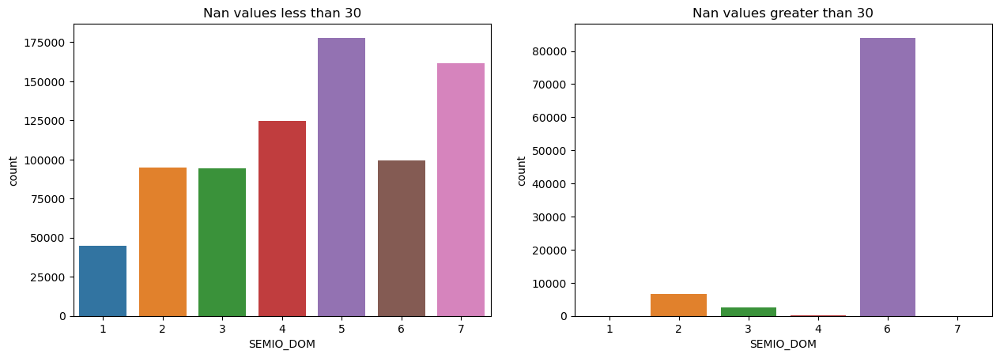

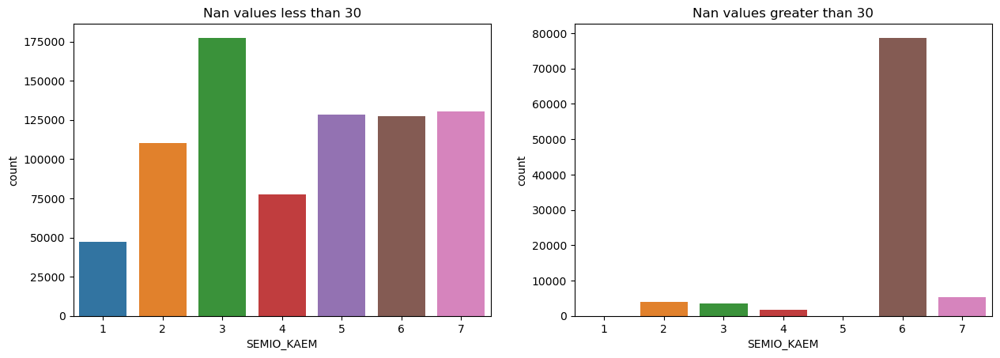

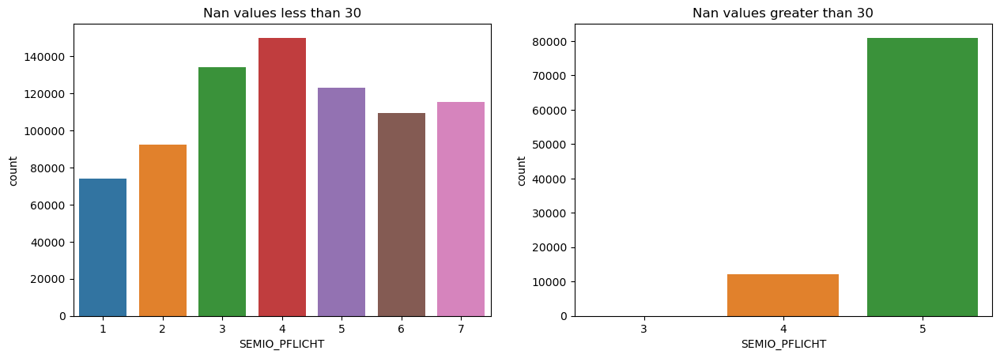

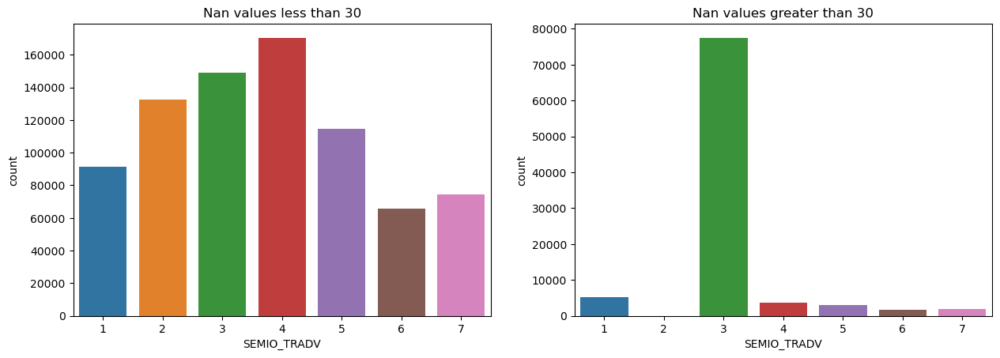

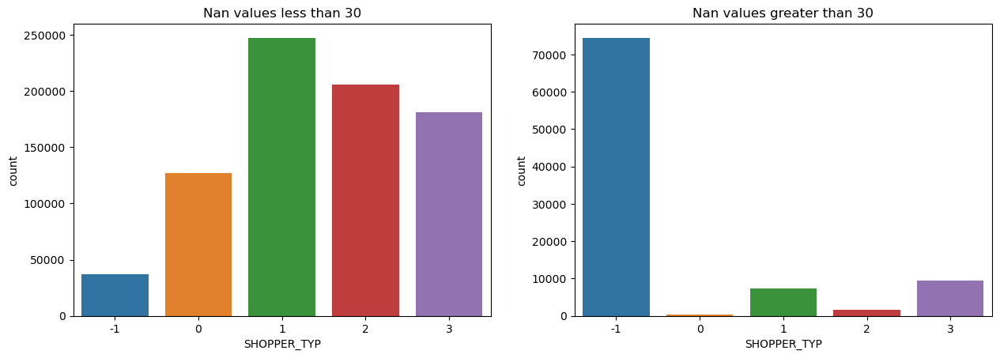

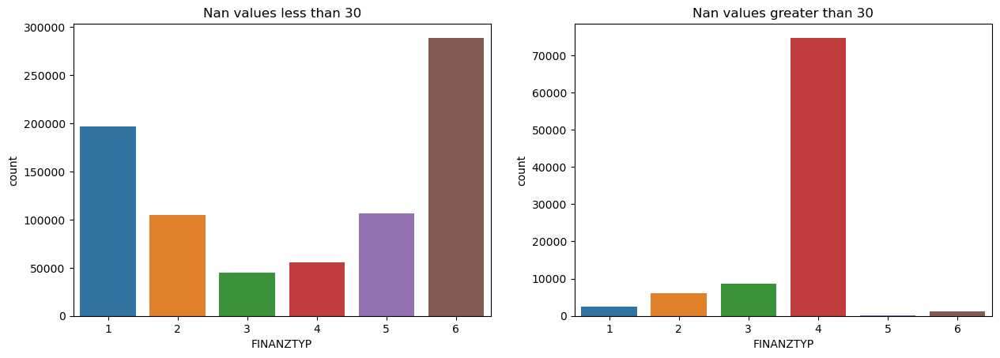

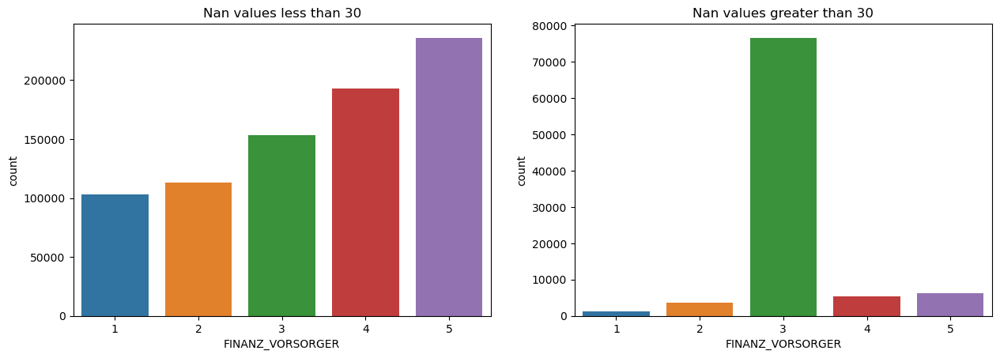

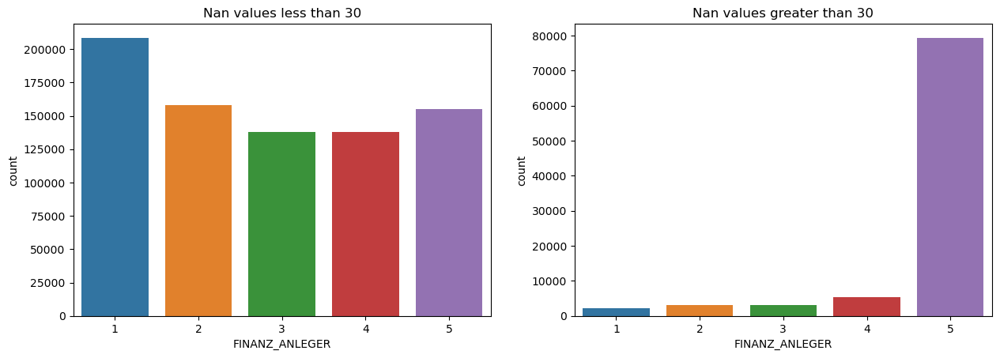

In [62]:
def compare_dataSets_plot(df1, df2, columns, threshold):
    
    for column in columns:
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_figwidth(15)
        
        ax1.set_title(f'Nan values less than {threshold}')
        sns.countplot(data=df1, x=column, ax=ax1)

        ax2.set_title(f'Nan values greater than {threshold}')
        sns.countplot(data=df2, x=column, ax=ax2)
        
        plt.show()


compare_dataSets_plot(data_NAN_less_30, data_NAN_greater_30, columns_to_compare, 30)

#### Discussion 1.1.3: Assess Missing Data in Each Row

(Double-click this cell and replace this text with your own text, reporting your observations regarding missing data in rows. Are the data with lots of missing values are qualitatively different from data with few or no missing values?)

From the distribution of the data in both datasets (NaN values < 30 and NaN values > 30) across 8 columns, we can see that the distribution in the NaN values < 30 dataset is more evenly spread across multiple categories. In contrast, the distribution in the NaN values > 30 dataset is highly skewed in most cases.

### Step 1.2: Select and Re-Encode Features

Checking for missing data isn't the only way in which you can prepare a dataset for analysis. Since the unsupervised learning techniques to be used will only work on data that is encoded numerically, you need to make a few encoding changes or additional assumptions to be able to make progress. In addition, while almost all of the values in the dataset are encoded using numbers, not all of them represent numeric values. Check the third column of the feature summary (`feat_info`) for a summary of types of measurement.
- For numeric and interval data, these features can be kept without changes.
- Most of the variables in the dataset are ordinal in nature. While ordinal values may technically be non-linear in spacing, make the simplifying assumption that the ordinal variables can be treated as being interval in nature (that is, kept without any changes).
- Special handling may be necessary for the remaining two variable types: categorical, and 'mixed'.

In the first two parts of this sub-step, you will perform an investigation of the categorical and mixed-type features and make a decision on each of them, whether you will keep, drop, or re-encode each. Then, in the last part, you will create a new data frame with only the selected and engineered columns.

Data wrangling is often the trickiest part of the data analysis process, and there's a lot of it to be done here. But stick with it: once you're done with this step, you'll be ready to get to the machine learning parts of the project!

In [63]:
# How many features are there of each data type?
features =feature_summary[feature_summary['attribute'].isin(data_NAN_less_30)]

features_count = features.type.value_counts()
features_count

ordinal        49
categorical    21
numeric         7
mixed           7
interval        1
Name: type, dtype: int64

#### Step 1.2.1: Re-Encode Categorical Features

For categorical data, you would ordinarily need to encode the levels as dummy variables. Depending on the number of categories, perform one of the following:
- For binary (two-level) categoricals that take numeric values, you can keep them without needing to do anything.
- There is one binary variable that takes on non-numeric values. For this one, you need to re-encode the values as numbers or create a dummy variable.
- For multi-level categoricals (three or more values), you can choose to encode the values using multiple dummy variables (e.g. via [OneHotEncoder](http://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.OneHotEncoder.html)), or (to keep things straightforward) just drop them from the analysis. As always, document your choices in the Discussion section.

In [64]:
# Assess categorical variables: which are binary, which are multi-level, and
# which one needs to be re-encoded?
categorical_attribute = features[features['type'] == 'categorical' ]['attribute']
categorical_attribute.to_list()

['AGER_TYP',
 'ANREDE_KZ',
 'CJT_GESAMTTYP',
 'FINANZTYP',
 'GFK_URLAUBERTYP',
 'GREEN_AVANTGARDE',
 'LP_FAMILIE_FEIN',
 'LP_FAMILIE_GROB',
 'LP_STATUS_FEIN',
 'LP_STATUS_GROB',
 'NATIONALITAET_KZ',
 'SHOPPER_TYP',
 'SOHO_KZ',
 'TITEL_KZ',
 'VERS_TYP',
 'ZABEOTYP',
 'KK_KUNDENTYP',
 'GEBAEUDETYP',
 'OST_WEST_KZ',
 'CAMEO_DEUG_2015',
 'CAMEO_DEU_2015']

In [65]:
data_NAN_less_30[categorical_attribute].nunique().sort_values()

AGER_TYP             1
TITEL_KZ             1
SOHO_KZ              1
GREEN_AVANTGARDE     1
NATIONALITAET_KZ     1
ANREDE_KZ            2
VERS_TYP             2
OST_WEST_KZ          2
ZABEOTYP             4
LP_STATUS_GROB       5
SHOPPER_TYP          5
FINANZTYP            6
LP_FAMILIE_GROB      6
CJT_GESAMTTYP        6
KK_KUNDENTYP         6
GEBAEUDETYP          6
LP_STATUS_FEIN      10
CAMEO_DEUG_2015     10
LP_FAMILIE_FEIN     12
GFK_URLAUBERTYP     12
CAMEO_DEU_2015      45
dtype: int64

In [66]:
low_variance_columns = data_NAN_less_30[categorical_attribute].nunique() < 3
low_variance_columns

AGER_TYP             True
ANREDE_KZ            True
CJT_GESAMTTYP       False
FINANZTYP           False
GFK_URLAUBERTYP     False
GREEN_AVANTGARDE     True
LP_FAMILIE_FEIN     False
LP_FAMILIE_GROB     False
LP_STATUS_FEIN      False
LP_STATUS_GROB      False
NATIONALITAET_KZ     True
SHOPPER_TYP         False
SOHO_KZ              True
TITEL_KZ             True
VERS_TYP             True
ZABEOTYP            False
KK_KUNDENTYP        False
GEBAEUDETYP         False
OST_WEST_KZ          True
CAMEO_DEUG_2015     False
CAMEO_DEU_2015      False
dtype: bool

In [67]:
binary_category = low_variance_columns.index[low_variance_columns == True].to_list()
binary_category

['AGER_TYP',
 'ANREDE_KZ',
 'GREEN_AVANTGARDE',
 'NATIONALITAET_KZ',
 'SOHO_KZ',
 'TITEL_KZ',
 'VERS_TYP',
 'OST_WEST_KZ']

In [68]:
data_NAN_less_30[binary_category].head(10)

,AGER_TYP,ANREDE_KZ,GREEN_AVANTGARDE,NATIONALITAET_KZ,SOHO_KZ,TITEL_KZ,VERS_TYP,OST_WEST_KZ
1,-1.0,2,0.0,1.0,NaN,0.0,2.0,W
2,-1.0,2,NaN,1.0,0.0,0.0,1.0,W
3,NaN,2,0.0,1.0,0.0,0.0,1.0,W
4,-1.0,1,0.0,1.0,0.0,0.0,2.0,W
5,NaN,2,0.0,1.0,0.0,0.0,2.0,W
6,-1.0,2,0.0,1.0,0.0,0.0,1.0,W
7,-1.0,1,0.0,1.0,0.0,0.0,1.0,W
8,-1.0,1,NaN,1.0,0.0,0.0,2.0,W
9,-1.0,2,NaN,1.0,0.0,0.0,2.0,W
10,NaN,2,0.0,1.0,0.0,0.0,2.0,W


In [69]:
binary_categories = []
for column in categorical_attribute.to_list():
    if (data_NAN_less_30[column].nunique()==2):
      print(f'Values for {column} before transformation:')
      print(data_NAN_less_30[column].value_counts())
      binary_categories.append(column)
print(binary_categories)

Values for ANREDE_KZ before transformation:
2    416160
1    381863
Name: ANREDE_KZ, dtype: int64
Values for VERS_TYP before transformation:
2.0    394230
1.0    367070
Name: VERS_TYP, dtype: int64
Values for OST_WEST_KZ before transformation:
W    629485
O    168538
Name: OST_WEST_KZ, dtype: int64
['ANREDE_KZ', 'VERS_TYP', 'OST_WEST_KZ']


In [70]:
many_categories = []
for column in categorical_attribute.to_list():
    if (data_NAN_less_30[column].nunique()>2):
        many_categories.append(column)
print(many_categories)
print(f'many_categories size = {len(many_categories)}')

['CJT_GESAMTTYP', 'FINANZTYP', 'GFK_URLAUBERTYP', 'LP_FAMILIE_FEIN', 'LP_FAMILIE_GROB', 'LP_STATUS_FEIN', 'LP_STATUS_GROB', 'SHOPPER_TYP', 'ZABEOTYP', 'KK_KUNDENTYP', 'GEBAEUDETYP', 'CAMEO_DEUG_2015', 'CAMEO_DEU_2015']
many_categories size = 13


In [71]:
# encode categorical features 
cleaned_data = data_NAN_less_30
cleaned_data = encode_categorical_data(cleaned_data, features)


****************************************
Start Binary-Category Encoding
****************************************

Values for ANREDE_KZ before transformation:
2    416160
1    381863
Name: ANREDE_KZ, dtype: int64
Values for VERS_TYP before transformation:
2.0    394230
1.0    367070
Name: VERS_TYP, dtype: int64
Values for OST_WEST_KZ before transformation:
W    629485
O    168538
Name: OST_WEST_KZ, dtype: int64
['ANREDE_KZ', 'VERS_TYP', 'OST_WEST_KZ']


C:\Users\User\AppData\Local\Temp\ipykernel_2316\1080023015.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[column] = label_encoder.fit_transform(df[column])


Values for ANREDE_KZ after transformation:
1    416160
0    381863
Name: ANREDE_KZ, dtype: int64


C:\Users\User\AppData\Local\Temp\ipykernel_2316\1080023015.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[column] = label_encoder.fit_transform(df[column])


Values for VERS_TYP after transformation:
1    394230
0    367070
2     36723
Name: VERS_TYP, dtype: int64


C:\Users\User\AppData\Local\Temp\ipykernel_2316\1080023015.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[column] = label_encoder.fit_transform(df[column])


Values for OST_WEST_KZ after transformation:
1    629485
0    168538
Name: OST_WEST_KZ, dtype: int64

****************************************
Start Multi-Category Encoding
****************************************

many_categories size = 14
OneHotEncoder will be applied on the following columns: 
['CJT_GESAMTTYP', 'FINANZTYP', 'GFK_URLAUBERTYP', 'LP_FAMILIE_FEIN', 'LP_FAMILIE_GROB', 'LP_STATUS_FEIN', 'LP_STATUS_GROB', 'SHOPPER_TYP', 'VERS_TYP', 'ZABEOTYP', 'KK_KUNDENTYP', 'GEBAEUDETYP', 'CAMEO_DEUG_2015', 'CAMEO_DEU_2015']


In [72]:
cleaned_data.head(10)

,AGER_TYP,ALTERSKATEGORIE_GROB,ANREDE_KZ,FINANZ_MINIMALIST,FINANZ_SPARER,FINANZ_VORSORGER,FINANZ_ANLEGER,FINANZ_UNAUFFAELLIGER,FINANZ_HAUSBAUER,GEBURTSJAHR,GREEN_AVANTGARDE,HEALTH_TYP,LP_LEBENSPHASE_FEIN,LP_LEBENSPHASE_GROB,NATIONALITAET_KZ,PRAEGENDE_JUGENDJAHRE,RETOURTYP_BK_S,SEMIO_SOZ,SEMIO_FAM,SEMIO_REL,SEMIO_MAT,SEMIO_VERT,SEMIO_LUST,SEMIO_ERL,SEMIO_KULT,SEMIO_RAT,SEMIO_KRIT,SEMIO_DOM,SEMIO_KAEM,SEMIO_PFLICHT,SEMIO_TRADV,SOHO_KZ,TITEL_KZ,ALTER_HH,ANZ_PERSONEN,ANZ_TITEL,HH_EINKOMMEN_SCORE,W_KEIT_KIND_HH,WOHNDAUER_2008,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,KONSUMNAEHE,MIN_GEBAEUDEJAHR,OST_WEST_KZ,WOHNLAGE,CAMEO_INTL_2015,KBA05_ANTG1,KBA05_ANTG2,KBA05_ANTG3,KBA05_ANTG4,KBA05_BAUMAX,KBA05_GBZ,BALLRAUM,EWDICHTE,INNENSTADT,GEBAEUDETYP_RASTER,KKK,MOBI_REGIO,ONLINE_AFFINITAET,REGIOTYP,KBA13_ANZAHL_PKW,PLZ8_ANTG1,PLZ8_ANTG2,PLZ8_ANTG3,PLZ8_ANTG4,PLZ8_BAUMAX,PLZ8_HHZ,PLZ8_GBZ,ARBEIT,ORTSGR_KLS9,RELAT_AB,CJT_GESAMTTYP_1.0,CJT_GESAMTTYP_2.0,CJT_GESAMTTYP_3.0,CJT_GESAMTTYP_4.0,CJT_GESAMTTYP_5.0,CJT_GESAMTTYP_6.0,CJT_GESAMTTYP_nan,FINANZTYP_1,FINANZTYP_2,FINANZTYP_3,FINANZTYP_4,FINANZTYP_5,FINANZTYP_6,GFK_URLAUBERTYP_1.0,GFK_URLAUBERTYP_2.0,GFK_URLAUBERTYP_3.0,GFK_URLAUBERTYP_4.0,GFK_URLAUBERTYP_5.0,GFK_URLAUBERTYP_6.0,GFK_URLAUBERTYP_7.0,GFK_URLAUBERTYP_8.0,GFK_URLAUBERTYP_9.0,GFK_URLAUBERTYP_10.0,GFK_URLAUBERTYP_11.0,GFK_URLAUBERTYP_12.0,GFK_URLAUBERTYP_nan,LP_FAMILIE_FEIN_0.0,LP_FAMILIE_FEIN_1.0,LP_FAMILIE_FEIN_2.0,LP_FAMILIE_FEIN_3.0,LP_FAMILIE_FEIN_4.0,LP_FAMILIE_FEIN_5.0,LP_FAMILIE_FEIN_6.0,LP_FAMILIE_FEIN_7.0,LP_FAMILIE_FEIN_8.0,LP_FAMILIE_FEIN_9.0,LP_FAMILIE_FEIN_10.0,LP_FAMILIE_FEIN_11.0,LP_FAMILIE_FEIN_nan,LP_FAMILIE_GROB_0.0,LP_FAMILIE_GROB_1.0,LP_FAMILIE_GROB_2.0,LP_FAMILIE_GROB_3.0,LP_FAMILIE_GROB_4.0,LP_FAMILIE_GROB_5.0,LP_FAMILIE_GROB_nan,LP_STATUS_FEIN_1.0,LP_STATUS_FEIN_2.0,LP_STATUS_FEIN_3.0,LP_STATUS_FEIN_4.0,LP_STATUS_FEIN_5.0,LP_STATUS_FEIN_6.0,LP_STATUS_FEIN_7.0,LP_STATUS_FEIN_8.0,LP_STATUS_FEIN_9.0,LP_STATUS_FEIN_10.0,LP_STATUS_FEIN_nan,LP_STATUS_GROB_1.0,LP_STATUS_GROB_2.0,LP_STATUS_GROB_3.0,LP_STATUS_GROB_4.0,LP_STATUS_GROB_5.0,LP_STATUS_GROB_nan,SHOPPER_TYP_-1,SHOPPER_TYP_0,SHOPPER_TYP_1,SHOPPER_TYP_2,SHOPPER_TYP_3,VERS_TYP_0,VERS_TYP_1,VERS_TYP_2,ZABEOTYP_2.0,ZABEOTYP_3.0,ZABEOTYP_4.0,ZABEOTYP_5.0,ZABEOTYP_nan,KK_KUNDENTYP_1.0,KK_KUNDENTYP_2.0,KK_KUNDENTYP_3.0,KK_KUNDENTYP_4.0,KK_KUNDENTYP_5.0,KK_KUNDENTYP_6.0,KK_KUNDENTYP_nan,GEBAEUDETYP_1.0,GEBAEUDETYP_2.0,GEBAEUDETYP_3.0,GEBAEUDETYP_4.0,GEBAEUDETYP_5.0,GEBAEUDETYP_6.0,GEBAEUDETYP_nan,CAMEO_DEUG_2015_1,CAMEO_DEUG_2015_2,CAMEO_DEUG_2015_3,CAMEO_DEUG_2015_4,CAMEO_DEUG_2015_5,CAMEO_DEUG_2015_6,CAMEO_DEUG_2015_7,CAMEO_DEUG_2015_8,CAMEO_DEUG_2015_9,CAMEO_DEUG_2015_X,CAMEO_DEUG_2015_nan,CAMEO_DEU_2015_1A,CAMEO_DEU_2015_1B,CAMEO_DEU_2015_1C,CAMEO_DEU_2015_1D,CAMEO_DEU_2015_1E,CAMEO_DEU_2015_2A,CAMEO_DEU_2015_2B,CAMEO_DEU_2015_2C,CAMEO_DEU_2015_2D,CAMEO_DEU_2015_3A,CAMEO_DEU_2015_3B,CAMEO_DEU_2015_3C,CAMEO_DEU_2015_3D,CAMEO_DEU_2015_4A,CAMEO_DEU_2015_4B,CAMEO_DEU_2015_4C,CAMEO_DEU_2015_4D,CAMEO_DEU_2015_4E,CAMEO_DEU_2015_5A,CAMEO_DEU_2015_5B,CAMEO_DEU_2015_5C,CAMEO_DEU_2015_5D,CAMEO_DEU_2015_5E,CAMEO_DEU_2015_5F,CAMEO_DEU_2015_6A,CAMEO_DEU_2015_6B,CAMEO_DEU_2015_6C,CAMEO_DEU_2015_6D,CAMEO_DEU_2015_6E,CAMEO_DEU_2015_6F,CAMEO_DEU_2015_7A,CAMEO_DEU_2015_7B,CAMEO_DEU_2015_7C,CAMEO_DEU_2015_7D,CAMEO_DEU_2015_7E,CAMEO_DEU_2015_8A,CAMEO_DEU_2015_8B,CAMEO_DEU_2015_8C,CAMEO_DEU_2015_8D,CAMEO_DEU_2015_9A,CAMEO_DEU_2015_9B,CAMEO_DEU_2015_9C,CAMEO_DEU_2015_9D,CAMEO_DEU_2015_9E,CAMEO_DEU_2015_XX,CAMEO_DEU_2015_nan
1,-1.0,1.0,1,1,5,2,5,4,5,1996,0.0,3,21.0,6.0,1.0,14,1.0,5,4,4,3,1,2,2,3,6,4,7,4,7,6,NaN,0.0,0.0,2.0,0.0,6.0,3.0,9.0,11.0,0.0,1.0,1992.0,1,4.0,51,0.0,0.0,0.0,NaN,5.0,1.0,6.0,3.0,8.0,3.0,2.0,1.0,3.0,3.0,963.0,2.0,3.0,2.0,1.0,1.0,5.0,4.0,3.0,5.0,4.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0

In [73]:
cleaned_data.shape

(798023, 218)

#### Discussion 1.2.1: Re-Encode Categorical Features

(Double-click this cell and replace this text with your own text, reporting your findings and decisions regarding categorical features. Which ones did you keep, which did you drop, and what engineering steps did you perform?)

For the binary categorical columns, I re-encoded them to have values of 0 or 1. Some columns contained letters, such as "W" in OST_WEST_KZ, while others had numeric values like "2", so I standardized them to a binary format.

For the multi-categorical features, I applied encoding to split them into multiple columns. For example, CJT_GESAMTTYP was split into six separate columns after encoding.

#### Step 1.2.2: Engineer Mixed-Type Features

There are a handful of features that are marked as "mixed" in the feature summary that require special treatment in order to be included in the analysis. There are two in particular that deserve attention; the handling of the rest are up to your own choices:
- "PRAEGENDE_JUGENDJAHRE" combines information on three dimensions: generation by decade, movement (mainstream vs. avantgarde), and nation (east vs. west). While there aren't enough levels to disentangle east from west, you should create two new variables to capture the other two dimensions: an interval-type variable for decade, and a binary variable for movement.
- "CAMEO_INTL_2015" combines information on two axes: wealth and life stage. Break up the two-digit codes by their 'tens'-place and 'ones'-place digits into two new ordinal variables (which, for the purposes of this project, is equivalent to just treating them as their raw numeric values).
- If you decide to keep or engineer new features around the other mixed-type features, make sure you note your steps in the Discussion section.

Be sure to check `Data_Dictionary.md` for the details needed to finish these tasks.

In [74]:
# Investigate "PRAEGENDE_JUGENDJAHRE" and engineer two new variables.
cleaned_data['PRAEGENDE_JUGENDJAHRE'].head(10)


1     14
2     15
3      8
4      8
5      3
6     10
7      8
8     11
9     15
10     3
Name: PRAEGENDE_JUGENDJAHRE, dtype: int64

In [75]:
# movement mapper = { Mainstream  = 0 , Avantgarde = 1}
# decade mapper = { 40s: 0, 50s: 1, 60s: 2, 70s: 3,  80s: 4, 90s: 5}
movement_mapper = {
  0 : [1,3,5,8,10,12,14],
  1: [2,4,6,7,9,11,13,15]
}

decade_mapper = {
    0: [1,2], 
    1: [3,4], 
    2: [5, 6, 7], 
    3: [8, 9],  
    4: [10, 11, 12, 13], 
    5: [14, 15],
}

mappers = [movement_mapper, decade_mapper]

cleaned_data = engineer_mixed_features(
    cleaned_data, 
    mappers, 
    'PRAEGENDE_JUGENDJAHRE', 
    ['movement', 'decade']
    )




****************************************
Start Engineering PRAEGENDE_JUGENDJAHRE
****************************************

    movement  decade  PRAEGENDE_JUGENDJAHRE
1        0.0     5.0                     14
2        1.0     5.0                     15
3        0.0     3.0                      8
4        0.0     3.0                      8
5        0.0     1.0                      3
6        0.0     4.0                     10
7        0.0     3.0                      8
8        1.0     4.0                     11
9        1.0     5.0                     15
10       0.0     1.0                      3


In [76]:
# Investigate "CAMEO_INTL_2015" and engineer two new variables.
cleaned_data['CAMEO_INTL_2015'].head(10)


1     51
2     24
3     12
4     43
5     54
6     22
7     14
8     13
9     15
10    51
Name: CAMEO_INTL_2015, dtype: object

The data type of the column `CAMEO_INTL_2015` is not float. In the following cell, we add two new attributes `wealth` `life_stage` and convert the column to float.

In [77]:
cleaned_data['wealth'] = pd.to_numeric(cleaned_data['CAMEO_INTL_2015'], errors='coerce')
cleaned_data['life_stage'] = pd.to_numeric(cleaned_data['CAMEO_INTL_2015'], errors='coerce')
print(cleaned_data[['CAMEO_INTL_2015', 'wealth', 'life_stage']].head(20))

   CAMEO_INTL_2015  wealth  life_stage
1               51    51.0        51.0
2               24    24.0        24.0
3               12    12.0        12.0
4               43    43.0        43.0
5               54    54.0        54.0
6               22    22.0        22.0
7               14    14.0        14.0
8               13    13.0        13.0
9               15    15.0        15.0
10              51    51.0        51.0
12              43    43.0        43.0
13              33    33.0        33.0
15              41    41.0        41.0
16              41    41.0        41.0
18              24    24.0        24.0
19              34    34.0        34.0
20              24    24.0        24.0
21              55    55.0        55.0
22              51    51.0        51.0
23              43    43.0        43.0


In [78]:
# wealth mapper = { Poorer Households  = 0 , 
# Less Affluent Households = 1, 
# Comfortable Households = 2, Prosperous Households =3, Wealthy Households=5}
# life stage mapper = { 40s: 0, 50s: 1, 60s: 2, 70s: 3,  80s: 4, 90s: 5}
wealth_mapper = {
  0: [51,52,53,54,55],
  1: [41,42,43,44,45],
  2: [31,32,33,34,35],
  3: [21,22,23,24,25],
  4: [11,12,13,14,15],
}

life_stage_mapper = {
  0: [11,21,31,41,51],
  1: [12,22,32,42,52],
  2: [13,23,43,33,53],
  3: [14,24,34,44,54],
  4: [15,25,35,45,55],
}


mappers = [wealth_mapper, life_stage_mapper]

cleaned_data = engineer_mixed_features(
    cleaned_data, 
    mappers, 
    'CAMEO_INTL_2015', 
    ['wealth', 'life_stage']
    )



****************************************
Start Engineering CAMEO_INTL_2015
****************************************

    wealth  life_stage  CAMEO_INTL_2015
1      0.0         0.0             51.0
2      3.0         3.0             24.0
3      4.0         1.0             12.0
4      1.0         2.0             43.0
5      0.0         3.0             54.0
6      3.0         1.0             22.0
7      4.0         3.0             14.0
8      4.0         2.0             13.0
9      4.0         4.0             15.0
10     0.0         0.0             51.0


#### Discussion 1.2.2: Engineer Mixed-Type Features

(Double-click this cell and replace this text with your own text, reporting your findings and decisions regarding mixed-value features. Which ones did you keep, which did you drop, and what engineering steps did you perform?)

In this step, I re-engineered the mixed-type feature "CAMEO_INTL_2015" by creating two mappers and remapping the column, splitting it into two separate features: wealth and life_stage. I then dropped the original column as it was no longer needed.

Similarly, I applied the same process to "PRAEGENDE_JUGENDJAHRE", splitting it into movement and decade, and then dropped the original column.

#### Step 1.2.3: Complete Feature Selection

In order to finish this step up, you need to make sure that your data frame now only has the columns that you want to keep. To summarize, the dataframe should consist of the following:
- All numeric, interval, and ordinal type columns from the original dataset.
- Binary categorical features (all numerically-encoded).
- Engineered features from other multi-level categorical features and mixed features.

Make sure that for any new columns that you have engineered, that you've excluded the original columns from the final dataset. Otherwise, their values will interfere with the analysis later on the project. For example, you should not keep "PRAEGENDE_JUGENDJAHRE", since its values won't be useful for the algorithm: only the values derived from it in the engineered features you created should be retained. As a reminder, your data should only be from **the subset with few or no missing values**.

In [79]:
# If there are other re-engineering tasks you need to perform, make sure you
# take care of them here. (Dealing with missing data will come in step 2.1.)

cleaned_data.drop(columns=['PRAEGENDE_JUGENDJAHRE', 'CAMEO_INTL_2015'], axis=1,inplace=True)
cleaned_data.shape


(798023, 220)

In [80]:
cleaned_data.head(10)

,AGER_TYP,ALTERSKATEGORIE_GROB,ANREDE_KZ,FINANZ_MINIMALIST,FINANZ_SPARER,FINANZ_VORSORGER,FINANZ_ANLEGER,FINANZ_UNAUFFAELLIGER,FINANZ_HAUSBAUER,GEBURTSJAHR,GREEN_AVANTGARDE,HEALTH_TYP,LP_LEBENSPHASE_FEIN,LP_LEBENSPHASE_GROB,NATIONALITAET_KZ,RETOURTYP_BK_S,SEMIO_SOZ,SEMIO_FAM,SEMIO_REL,SEMIO_MAT,SEMIO_VERT,SEMIO_LUST,SEMIO_ERL,SEMIO_KULT,SEMIO_RAT,SEMIO_KRIT,SEMIO_DOM,SEMIO_KAEM,SEMIO_PFLICHT,SEMIO_TRADV,SOHO_KZ,TITEL_KZ,ALTER_HH,ANZ_PERSONEN,ANZ_TITEL,HH_EINKOMMEN_SCORE,W_KEIT_KIND_HH,WOHNDAUER_2008,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,KONSUMNAEHE,MIN_GEBAEUDEJAHR,OST_WEST_KZ,WOHNLAGE,KBA05_ANTG1,KBA05_ANTG2,KBA05_ANTG3,KBA05_ANTG4,KBA05_BAUMAX,KBA05_GBZ,BALLRAUM,EWDICHTE,INNENSTADT,GEBAEUDETYP_RASTER,KKK,MOBI_REGIO,ONLINE_AFFINITAET,REGIOTYP,KBA13_ANZAHL_PKW,PLZ8_ANTG1,PLZ8_ANTG2,PLZ8_ANTG3,PLZ8_ANTG4,PLZ8_BAUMAX,PLZ8_HHZ,PLZ8_GBZ,ARBEIT,ORTSGR_KLS9,RELAT_AB,CJT_GESAMTTYP_1.0,CJT_GESAMTTYP_2.0,CJT_GESAMTTYP_3.0,CJT_GESAMTTYP_4.0,CJT_GESAMTTYP_5.0,CJT_GESAMTTYP_6.0,CJT_GESAMTTYP_nan,FINANZTYP_1,FINANZTYP_2,FINANZTYP_3,FINANZTYP_4,FINANZTYP_5,FINANZTYP_6,GFK_URLAUBERTYP_1.0,GFK_URLAUBERTYP_2.0,GFK_URLAUBERTYP_3.0,GFK_URLAUBERTYP_4.0,GFK_URLAUBERTYP_5.0,GFK_URLAUBERTYP_6.0,GFK_URLAUBERTYP_7.0,GFK_URLAUBERTYP_8.0,GFK_URLAUBERTYP_9.0,GFK_URLAUBERTYP_10.0,GFK_URLAUBERTYP_11.0,GFK_URLAUBERTYP_12.0,GFK_URLAUBERTYP_nan,LP_FAMILIE_FEIN_0.0,LP_FAMILIE_FEIN_1.0,LP_FAMILIE_FEIN_2.0,LP_FAMILIE_FEIN_3.0,LP_FAMILIE_FEIN_4.0,LP_FAMILIE_FEIN_5.0,LP_FAMILIE_FEIN_6.0,LP_FAMILIE_FEIN_7.0,LP_FAMILIE_FEIN_8.0,LP_FAMILIE_FEIN_9.0,LP_FAMILIE_FEIN_10.0,LP_FAMILIE_FEIN_11.0,LP_FAMILIE_FEIN_nan,LP_FAMILIE_GROB_0.0,LP_FAMILIE_GROB_1.0,LP_FAMILIE_GROB_2.0,LP_FAMILIE_GROB_3.0,LP_FAMILIE_GROB_4.0,LP_FAMILIE_GROB_5.0,LP_FAMILIE_GROB_nan,LP_STATUS_FEIN_1.0,LP_STATUS_FEIN_2.0,LP_STATUS_FEIN_3.0,LP_STATUS_FEIN_4.0,LP_STATUS_FEIN_5.0,LP_STATUS_FEIN_6.0,LP_STATUS_FEIN_7.0,LP_STATUS_FEIN_8.0,LP_STATUS_FEIN_9.0,LP_STATUS_FEIN_10.0,LP_STATUS_FEIN_nan,LP_STATUS_GROB_1.0,LP_STATUS_GROB_2.0,LP_STATUS_GROB_3.0,LP_STATUS_GROB_4.0,LP_STATUS_GROB_5.0,LP_STATUS_GROB_nan,SHOPPER_TYP_-1,SHOPPER_TYP_0,SHOPPER_TYP_1,SHOPPER_TYP_2,SHOPPER_TYP_3,VERS_TYP_0,VERS_TYP_1,VERS_TYP_2,ZABEOTYP_2.0,ZABEOTYP_3.0,ZABEOTYP_4.0,ZABEOTYP_5.0,ZABEOTYP_nan,KK_KUNDENTYP_1.0,KK_KUNDENTYP_2.0,KK_KUNDENTYP_3.0,KK_KUNDENTYP_4.0,KK_KUNDENTYP_5.0,KK_KUNDENTYP_6.0,KK_KUNDENTYP_nan,GEBAEUDETYP_1.0,GEBAEUDETYP_2.0,GEBAEUDETYP_3.0,GEBAEUDETYP_4.0,GEBAEUDETYP_5.0,GEBAEUDETYP_6.0,GEBAEUDETYP_nan,CAMEO_DEUG_2015_1,CAMEO_DEUG_2015_2,CAMEO_DEUG_2015_3,CAMEO_DEUG_2015_4,CAMEO_DEUG_2015_5,CAMEO_DEUG_2015_6,CAMEO_DEUG_2015_7,CAMEO_DEUG_2015_8,CAMEO_DEUG_2015_9,CAMEO_DEUG_2015_X,CAMEO_DEUG_2015_nan,CAMEO_DEU_2015_1A,CAMEO_DEU_2015_1B,CAMEO_DEU_2015_1C,CAMEO_DEU_2015_1D,CAMEO_DEU_2015_1E,CAMEO_DEU_2015_2A,CAMEO_DEU_2015_2B,CAMEO_DEU_2015_2C,CAMEO_DEU_2015_2D,CAMEO_DEU_2015_3A,CAMEO_DEU_2015_3B,CAMEO_DEU_2015_3C,CAMEO_DEU_2015_3D,CAMEO_DEU_2015_4A,CAMEO_DEU_2015_4B,CAMEO_DEU_2015_4C,CAMEO_DEU_2015_4D,CAMEO_DEU_2015_4E,CAMEO_DEU_2015_5A,CAMEO_DEU_2015_5B,CAMEO_DEU_2015_5C,CAMEO_DEU_2015_5D,CAMEO_DEU_2015_5E,CAMEO_DEU_2015_5F,CAMEO_DEU_2015_6A,CAMEO_DEU_2015_6B,CAMEO_DEU_2015_6C,CAMEO_DEU_2015_6D,CAMEO_DEU_2015_6E,CAMEO_DEU_2015_6F,CAMEO_DEU_2015_7A,CAMEO_DEU_2015_7B,CAMEO_DEU_2015_7C,CAMEO_DEU_2015_7D,CAMEO_DEU_2015_7E,CAMEO_DEU_2015_8A,CAMEO_DEU_2015_8B,CAMEO_DEU_2015_8C,CAMEO_DEU_2015_8D,CAMEO_DEU_2015_9A,CAMEO_DEU_2015_9B,CAMEO_DEU_2015_9C,CAMEO_DEU_2015_9D,CAMEO_DEU_2015_9E,CAMEO_DEU_2015_XX,CAMEO_DEU_2015_nan,movement,decade,wealth,life_stage
1,-1.0,1.0,1,1,5,2,5,4,5,1996,0.0,3,21.0,6.0,1.0,1.0,5,4,4,3,1,2,2,3,6,4,7,4,7,6,NaN,0.0,0.0,2.0,0.0,6.0,3.0,9.0,11.0,0.0,1.0,1992.0,1,4.0,0.0,0.0,0.0,NaN,5.0,1.0,6.0,3.0,8.0,3.0,2.0,1.0,3.0,3.0,963.0,2.0,3.0,2.0,1.0,1.0,5.0,4.0,3.0,5.0,4.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0

In [81]:
# Do whatever you need to in order to ensure that the dataframe only contains
# the columns that should be passed to the algorithm functions.

## check all the data types:
cleaned_data.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 798023 entries, 1 to 891220
Columns: 220 entries, AGER_TYP to life_stage
dtypes: float64(196), int32(1), int64(23)
memory usage: 1.3 GB


We can find that `CAMEO_DEUG_2015` and `CAMEO_DEU_2015` are objects so they will be dropped 

In [82]:
del data_NAN_less_30
del data_NAN_greater_30

### Step 1.3: Create a Cleaning Function

Even though you've finished cleaning up the general population demographics data, it's important to look ahead to the future and realize that you'll need to perform the same cleaning steps on the customer demographics data. In this substep, complete the function below to execute the main feature selection, encoding, and re-engineering steps you performed above. Then, when it comes to looking at the customer data in Step 3, you can just run this function on that DataFrame to get the trimmed dataset in a single step.

In [83]:
def clean_data(df):
    """
    Perform feature trimming, re-encoding, and engineering for demographics
    data
    
    INPUT: Demographics DataFrame
    OUTPUT: Trimmed and cleaned demographics DataFrame
    """
    column_threshold = 70
    rows_threshold = 30

    # Put in code here to execute all main cleaning steps:
    # convert missing value codes into NaNs, ...

    replace_with_nan(df, unknown_values)

    without_outliers = remove_outliers(df)


    print(f'Rows with null values equal or greater than %{column_threshold/100}')
    null_rows_count = without_outliers.isna().sum(axis=1).sort_values(ascending=True)
    cleaned_data_1 = without_outliers[null_rows_count < rows_threshold]

    del without_outliers, null_rows_count

    features =feature_summary[feature_summary['attribute'].isin(cleaned_data_1)]

    
    # select, re-encode, and engineer column values.
    cleaned_data_encoded = encode_categorical_data(cleaned_data_1, features)

    del cleaned_data_1

    movement_mapper = {
    0 : [1,3,5,8,10,12,14],
    1: [2,4,6,7,9,11,13,15]
    }

    decade_mapper = {
        0: [1,2], 
        1: [3,4], 
        2: [5, 6, 7], 
        3: [8, 9],  
        4: [10, 11, 12, 13], 
        5: [14, 15],
    }

    mappers = [movement_mapper, decade_mapper]

    cleaned_data_reegineered = engineer_mixed_features(
    cleaned_data_encoded, 
    mappers, 
    'PRAEGENDE_JUGENDJAHRE', 
    ['movement', 'decade']
    )

    del cleaned_data_encoded

    wealth_mapper = {
    0: [51,52,53,54,55],
    1: [41,42,43,44,45],
    2: [31,32,33,34,35],
    3: [21,22,23,24,25],
    4: [11,12,13,14,15],
    }

    life_stage_mapper = {
    0: [11,21,31,41,51],
    1: [12,22,32,42,52],
    2: [13,23,43,33,53],
    3: [14,24,34,44,54],
    4: [15,25,35,45,55],
    }


    mappers = [wealth_mapper, life_stage_mapper]

    cleaned_data_1 = engineer_mixed_features(
        cleaned_data_reegineered, 
        mappers, 
        'CAMEO_INTL_2015', 
        ['wealth', 'life_stage']
        )    

    cleaned_data_1.drop(columns=['PRAEGENDE_JUGENDJAHRE', 'CAMEO_INTL_2015'], axis=1,inplace=True)
    cleaned_data_1.shape

    # Return the cleaned dataframe.
    return cleaned_data_1
    
    

In [84]:
population_copy = population.copy()
cleaned_population = clean_data(population_copy)


****************************************
Start Replacing Unknown values with NaNs
****************************************


**************************************************
Start Removing Outliers

**************************************************
Rows with null values equal or greater than %0.7


C:\Users\User\AppData\Local\Temp\ipykernel_2316\1665795460.py:22: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  cleaned_data_1 = without_outliers[null_rows_count < rows_threshold]



****************************************
Start Binary-Category Encoding
****************************************

Values for ANREDE_KZ before transformation:
2    415918
1    381710
Name: ANREDE_KZ, dtype: int64
Values for VERS_TYP before transformation:
2.0    394192
1.0    366911
Name: VERS_TYP, dtype: int64
Values for OST_WEST_KZ before transformation:
W    629153
O    168475
Name: OST_WEST_KZ, dtype: int64
['ANREDE_KZ', 'VERS_TYP', 'OST_WEST_KZ']
Values for ANREDE_KZ after transformation:
1    415918
0    381710
Name: ANREDE_KZ, dtype: int64


C:\Users\User\AppData\Local\Temp\ipykernel_2316\1080023015.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[column] = label_encoder.fit_transform(df[column])
C:\Users\User\AppData\Local\Temp\ipykernel_2316\1080023015.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[column] = label_encoder.fit_transform(df[column])


Values for VERS_TYP after transformation:
1    394192
0    366911
2     36525
Name: VERS_TYP, dtype: int64


C:\Users\User\AppData\Local\Temp\ipykernel_2316\1080023015.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[column] = label_encoder.fit_transform(df[column])


Values for OST_WEST_KZ after transformation:
1    629153
0    168475
Name: OST_WEST_KZ, dtype: int64

****************************************
Start Multi-Category Encoding
****************************************

many_categories size = 14
OneHotEncoder will be applied on the following columns: 
['CJT_GESAMTTYP', 'FINANZTYP', 'GFK_URLAUBERTYP', 'LP_FAMILIE_FEIN', 'LP_FAMILIE_GROB', 'LP_STATUS_FEIN', 'LP_STATUS_GROB', 'SHOPPER_TYP', 'VERS_TYP', 'ZABEOTYP', 'KK_KUNDENTYP', 'GEBAEUDETYP', 'CAMEO_DEUG_2015', 'CAMEO_DEU_2015']

****************************************
Start Engineering PRAEGENDE_JUGENDJAHRE
****************************************

    movement  decade  PRAEGENDE_JUGENDJAHRE
1        0.0     5.0                   14.0
2        1.0     5.0                   15.0
3        0.0     3.0                    8.0
4        0.0     3.0                    8.0
5        0.0     1.0                    3.0
6        0.0     4.0                   10.0
7        0.0     3.0                   

In [85]:
del population_copy

## Step 2: Feature Transformation

### Step 2.1: Apply Feature Scaling

Before we apply dimensionality reduction techniques to the data, we need to perform feature scaling so that the principal component vectors are not influenced by the natural differences in scale for features. Starting from this part of the project, you'll want to keep an eye on the [API reference page for sklearn](http://scikit-learn.org/stable/modules/classes.html) to help you navigate to all of the classes and functions that you'll need. In this substep, you'll need to check the following:

- sklearn requires that data not have missing values in order for its estimators to work properly. So, before applying the scaler to your data, make sure that you've cleaned the DataFrame of the remaining missing values. This can be as simple as just removing all data points with missing data, or applying an [SimpleImputer](https://scikit-learn.org/stable/modules/generated/sklearn.impute.SimpleImputer.html) to replace all missing values. You might also try a more complicated procedure where you temporarily remove missing values in order to compute the scaling parameters before re-introducing those missing values and applying imputation. Think about how much missing data you have and what possible effects each approach might have on your analysis, and justify your decision in the discussion section below.
- For the actual scaling function, a [StandardScaler](http://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html) instance is suggested, scaling each feature to mean 0 and standard deviation 1.
- For these classes, you can make use of the `.fit_transform()` method to both fit a procedure to the data as well as apply the transformation to the data at the same time. Don't forget to keep the fit sklearn objects handy, since you'll be applying them to the customer demographics data towards the end of the project.

In [86]:
# If you've not yet cleaned the dataset of all NaN values, then investigate and
# do that now.
have_nulls = cleaned_population.isna().sum() > 0
column_have_nulls = have_nulls[have_nulls].index
column_have_nulls



Index(['AGER_TYP', 'ALTERSKATEGORIE_GROB', 'GEBURTSJAHR', 'GREEN_AVANTGARDE',
       'HEALTH_TYP', 'LP_LEBENSPHASE_FEIN', 'LP_LEBENSPHASE_GROB',
       'NATIONALITAET_KZ', 'RETOURTYP_BK_S', 'SOHO_KZ', 'TITEL_KZ', 'ALTER_HH',
       'ANZ_PERSONEN', 'ANZ_TITEL', 'W_KEIT_KIND_HH', 'WOHNDAUER_2008',
       'ANZ_HAUSHALTE_AKTIV', 'ANZ_HH_TITEL', 'KONSUMNAEHE',
       'MIN_GEBAEUDEJAHR', 'KBA05_ANTG1', 'KBA05_ANTG2', 'KBA05_ANTG3',
       'KBA05_ANTG4', 'KBA05_BAUMAX', 'KBA05_GBZ', 'BALLRAUM', 'EWDICHTE',
       'INNENSTADT', 'GEBAEUDETYP_RASTER', 'KKK', 'MOBI_REGIO',
       'ONLINE_AFFINITAET', 'REGIOTYP', 'KBA13_ANZAHL_PKW', 'PLZ8_ANTG1',
       'PLZ8_ANTG2', 'PLZ8_ANTG3', 'PLZ8_ANTG4', 'PLZ8_BAUMAX', 'PLZ8_HHZ',
       'PLZ8_GBZ', 'ARBEIT', 'ORTSGR_KLS9', 'RELAT_AB', 'movement', 'decade',
       'wealth', 'life_stage'],
      dtype='object')

In [87]:
column_to_drop = count_nan_values(cleaned_population, 50)

AGER_TYP has 797628 NAN values = %100.0
TITEL_KZ has 797628 NAN values = %100.0
['AGER_TYP', 'TITEL_KZ']


In [88]:
print(column_to_drop)

['AGER_TYP', 'TITEL_KZ']


In [89]:
cleaned_population.drop(columns=column_to_drop, axis=1, inplace=True)

# Imputer

In [91]:
####################################3
column_have_nulls = cleaned_population.columns


imputer = SimpleImputer(strategy='most_frequent')


preprocessor = ColumnTransformer(
    transformers=[('cat', imputer, column_have_nulls)]
)

df_transformed = preprocessor.fit_transform(cleaned_population[column_have_nulls])
df_transformed = pd.DataFrame(df_transformed, columns=column_have_nulls, index=cleaned_population.index)
cleaned_population[column_have_nulls] = df_transformed


In [92]:
cleaned_data.shape

(798023, 220)

In [93]:
cleaned_population.columns[cleaned_population.isna().any()]

Index([], dtype='object')

In [94]:
# Apply feature scaling to the general population demographics data.
scaler = StandardScaler()
features_scaled = scaler.fit_transform(cleaned_population)

In [95]:
features_scaled=pd.DataFrame(features_scaled,columns=cleaned_population.columns.tolist())

In [96]:
features_scaled.head(10)

,ALTERSKATEGORIE_GROB,ANREDE_KZ,FINANZ_MINIMALIST,FINANZ_SPARER,FINANZ_VORSORGER,FINANZ_ANLEGER,FINANZ_UNAUFFAELLIGER,FINANZ_HAUSBAUER,GEBURTSJAHR,GREEN_AVANTGARDE,HEALTH_TYP,LP_LEBENSPHASE_FEIN,LP_LEBENSPHASE_GROB,NATIONALITAET_KZ,RETOURTYP_BK_S,SEMIO_SOZ,SEMIO_FAM,SEMIO_REL,SEMIO_MAT,SEMIO_VERT,SEMIO_LUST,SEMIO_ERL,SEMIO_KULT,SEMIO_RAT,SEMIO_KRIT,SEMIO_DOM,SEMIO_KAEM,SEMIO_PFLICHT,SEMIO_TRADV,SOHO_KZ,ALTER_HH,ANZ_PERSONEN,ANZ_TITEL,HH_EINKOMMEN_SCORE,W_KEIT_KIND_HH,WOHNDAUER_2008,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,KONSUMNAEHE,MIN_GEBAEUDEJAHR,OST_WEST_KZ,WOHNLAGE,KBA05_ANTG1,KBA05_ANTG2,KBA05_ANTG3,KBA05_ANTG4,KBA05_BAUMAX,KBA05_GBZ,BALLRAUM,EWDICHTE,INNENSTADT,GEBAEUDETYP_RASTER,KKK,MOBI_REGIO,ONLINE_AFFINITAET,REGIOTYP,KBA13_ANZAHL_PKW,PLZ8_ANTG1,PLZ8_ANTG2,PLZ8_ANTG3,PLZ8_ANTG4,PLZ8_BAUMAX,PLZ8_HHZ,PLZ8_GBZ,ARBEIT,ORTSGR_KLS9,RELAT_AB,CJT_GESAMTTYP_1.0,CJT_GESAMTTYP_2.0,CJT_GESAMTTYP_3.0,CJT_GESAMTTYP_4.0,CJT_GESAMTTYP_5.0,CJT_GESAMTTYP_6.0,CJT_GESAMTTYP_nan,FINANZTYP_1,FINANZTYP_2,FINANZTYP_3,FINANZTYP_4,FINANZTYP_5,FINANZTYP_6,GFK_URLAUBERTYP_1.0,GFK_URLAUBERTYP_2.0,GFK_URLAUBERTYP_3.0,GFK_URLAUBERTYP_4.0,GFK_URLAUBERTYP_5.0,GFK_URLAUBERTYP_6.0,GFK_URLAUBERTYP_7.0,GFK_URLAUBERTYP_8.0,GFK_URLAUBERTYP_9.0,GFK_URLAUBERTYP_10.0,GFK_URLAUBERTYP_11.0,GFK_URLAUBERTYP_12.0,GFK_URLAUBERTYP_nan,LP_FAMILIE_FEIN_1.0,LP_FAMILIE_FEIN_2.0,LP_FAMILIE_FEIN_3.0,LP_FAMILIE_FEIN_4.0,LP_FAMILIE_FEIN_5.0,LP_FAMILIE_FEIN_6.0,LP_FAMILIE_FEIN_7.0,LP_FAMILIE_FEIN_8.0,LP_FAMILIE_FEIN_9.0,LP_FAMILIE_FEIN_10.0,LP_FAMILIE_FEIN_11.0,LP_FAMILIE_FEIN_nan,LP_FAMILIE_GROB_1.0,LP_FAMILIE_GROB_2.0,LP_FAMILIE_GROB_3.0,LP_FAMILIE_GROB_4.0,LP_FAMILIE_GROB_5.0,LP_FAMILIE_GROB_nan,LP_STATUS_FEIN_1.0,LP_STATUS_FEIN_2.0,LP_STATUS_FEIN_3.0,LP_STATUS_FEIN_4.0,LP_STATUS_FEIN_5.0,LP_STATUS_FEIN_6.0,LP_STATUS_FEIN_7.0,LP_STATUS_FEIN_8.0,LP_STATUS_FEIN_9.0,LP_STATUS_FEIN_10.0,LP_STATUS_FEIN_nan,LP_STATUS_GROB_1.0,LP_STATUS_GROB_2.0,LP_STATUS_GROB_3.0,LP_STATUS_GROB_4.0,LP_STATUS_GROB_5.0,LP_STATUS_GROB_nan,SHOPPER_TYP_0.0,SHOPPER_TYP_1.0,SHOPPER_TYP_2.0,SHOPPER_TYP_3.0,SHOPPER_TYP_nan,VERS_TYP_0,VERS_TYP_1,VERS_TYP_2,ZABEOTYP_2.0,ZABEOTYP_3.0,ZABEOTYP_4.0,ZABEOTYP_5.0,ZABEOTYP_nan,KK_KUNDENTYP_1.0,KK_KUNDENTYP_2.0,KK_KUNDENTYP_3.0,KK_KUNDENTYP_4.0,KK_KUNDENTYP_5.0,KK_KUNDENTYP_6.0,KK_KUNDENTYP_nan,GEBAEUDETYP_1.0,GEBAEUDETYP_2.0,GEBAEUDETYP_3.0,GEBAEUDETYP_4.0,GEBAEUDETYP_5.0,GEBAEUDETYP_6.0,GEBAEUDETYP_nan,CAMEO_DEUG_2015_1,CAMEO_DEUG_2015_2,CAMEO_DEUG_2015_3,CAMEO_DEUG_2015_4,CAMEO_DEUG_2015_5,CAMEO_DEUG_2015_6,CAMEO_DEUG_2015_7,CAMEO_DEUG_2015_8,CAMEO_DEUG_2015_9,CAMEO_DEUG_2015_nan,CAMEO_DEU_2015_1A,CAMEO_DEU_2015_1B,CAMEO_DEU_2015_1C,CAMEO_DEU_2015_1D,CAMEO_DEU_2015_1E,CAMEO_DEU_2015_2A,CAMEO_DEU_2015_2B,CAMEO_DEU_2015_2C,CAMEO_DEU_2015_2D,CAMEO_DEU_2015_3A,CAMEO_DEU_2015_3B,CAMEO_DEU_2015_3C,CAMEO_DEU_2015_3D,CAMEO_DEU_2015_4A,CAMEO_DEU_2015_4B,CAMEO_DEU_2015_4C,CAMEO_DEU_2015_4D,CAMEO_DEU_2015_4E,CAMEO_DEU_2015_5A,CAMEO_DEU_2015_5B,CAMEO_DEU_2015_5C,CAMEO_DEU_2015_5D,CAMEO_DEU_2015_5E,CAMEO_DEU_2015_5F,CAMEO_DEU_2015_6A,CAMEO_DEU_2015_6B,CAMEO_DEU_2015_6C,CAMEO_DEU_2015_6D,CAMEO_DEU_2015_6E,CAMEO_DEU_2015_6F,CAMEO_DEU_2015_7A,CAMEO_DEU_2015_7B,CAMEO_DEU_2015_7C,CAMEO_DEU_2015_7D,CAMEO_DEU_2015_7E,CAMEO_DEU_2015_8A,CAMEO_DEU_2015_8B,CAMEO_DEU_2015_8C,CAMEO_DEU_2015_8D,CAMEO_DEU_2015_9A,CAMEO_DEU_2015_9B,CAMEO_DEU_2015_9C,CAMEO_DEU_2015_9D,CAMEO_DEU_2015_9E,CAMEO_DEU_2015_nan,movement,decade,wealth,life_stage
0,-1.766497,0.957994,-1.494592,1.538128,-1.040712,1.466338,0.959383,1.338974,2.085594,0.0,1.010285,0.455230,0.331855,0.0,-1.685117,0.442893,-0.059133,0.003182,-0.463588,-1.684975,-1.109909,-1.435573,-0.578269,1.274159,-0.311981,1.339214,-0.157563,1.518419,1.288791,0.0,0.559485,0.760670,0.0,1.026283,-0.729966,0.0,1.470503,0.0,-1.304431,0.0,0.517475,-0.027437,-1.009394,-0.966202,-0.491105,0.0,2.217408,-1.658888,0.845279,-0.547302,1.701192,-0.942781,-0.791394,-1.280639,0.167019,-0.882108,1.616552,-0.256599,0.189942,0.403103,0.442007,-0.633515,1.499671,0.552093,-0.

### Discussion 2.1: Apply Feature Scaling

(Double-click this cell and replace this text with your own text, reporting your decisions regarding feature scaling.)

as you can see from the displayed table above , all the data now is scaled using StandardScaler.

### Step 2.2: Perform Dimensionality Reduction

On your scaled data, you are now ready to apply dimensionality reduction techniques.

- Use sklearn's [PCA](http://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html) class to apply principal component analysis on the data, thus finding the vectors of maximal variance in the data. To start, you should not set any parameters (so all components are computed) or set a number of components that is at least half the number of features (so there's enough features to see the general trend in variability).
- Check out the ratio of variance explained by each principal component as well as the cumulative variance explained. Try plotting the cumulative or sequential values using matplotlib's [`plot()`](https://matplotlib.org/api/_as_gen/matplotlib.pyplot.plot.html) function. Based on what you find, select a value for the number of transformed features you'll retain for the clustering part of the project.
- Once you've made a choice for the number of components to keep, make sure you re-fit a PCA instance to perform the decided-on transformation.

In [ ]:
# Apply PCA to the data.

# pca = PCA()
# pca.fit(features_scaled)

In [ ]:
# Investigate the variance accounted for by each principal component.

# num_components=np.arange(len(pca.explained_variance_ratio_))
# values=pca.explained_variance_ratio_
# plt.bar(num_components,values)
# plt.xlabel("Principal component")
# plt.ylabel("Explained variance")
# plt.title("Explained variance per principal component")
# plt.show() 



In [ ]:
# cum_vals = np.cumsum(values)
# plt.plot(num_components,cum_vals)
# plt.xlabel("Principal component")
# plt.ylabel("Cumulative explained variance")
# plt.title("Cumulative explained variance per principal component")
# plt.show()


# PCA_100

In [97]:
features_scaled.head()

,ALTERSKATEGORIE_GROB,ANREDE_KZ,FINANZ_MINIMALIST,FINANZ_SPARER,FINANZ_VORSORGER,FINANZ_ANLEGER,FINANZ_UNAUFFAELLIGER,FINANZ_HAUSBAUER,GEBURTSJAHR,GREEN_AVANTGARDE,HEALTH_TYP,LP_LEBENSPHASE_FEIN,LP_LEBENSPHASE_GROB,NATIONALITAET_KZ,RETOURTYP_BK_S,SEMIO_SOZ,SEMIO_FAM,SEMIO_REL,SEMIO_MAT,SEMIO_VERT,SEMIO_LUST,SEMIO_ERL,SEMIO_KULT,SEMIO_RAT,SEMIO_KRIT,SEMIO_DOM,SEMIO_KAEM,SEMIO_PFLICHT,SEMIO_TRADV,SOHO_KZ,ALTER_HH,ANZ_PERSONEN,ANZ_TITEL,HH_EINKOMMEN_SCORE,W_KEIT_KIND_HH,WOHNDAUER_2008,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,KONSUMNAEHE,MIN_GEBAEUDEJAHR,OST_WEST_KZ,WOHNLAGE,KBA05_ANTG1,KBA05_ANTG2,KBA05_ANTG3,KBA05_ANTG4,KBA05_BAUMAX,KBA05_GBZ,BALLRAUM,EWDICHTE,INNENSTADT,GEBAEUDETYP_RASTER,KKK,MOBI_REGIO,ONLINE_AFFINITAET,REGIOTYP,KBA13_ANZAHL_PKW,PLZ8_ANTG1,PLZ8_ANTG2,PLZ8_ANTG3,PLZ8_ANTG4,PLZ8_BAUMAX,PLZ8_HHZ,PLZ8_GBZ,ARBEIT,ORTSGR_KLS9,RELAT_AB,CJT_GESAMTTYP_1.0,CJT_GESAMTTYP_2.0,CJT_GESAMTTYP_3.0,CJT_GESAMTTYP_4.0,CJT_GESAMTTYP_5.0,CJT_GESAMTTYP_6.0,CJT_GESAMTTYP_nan,FINANZTYP_1,FINANZTYP_2,FINANZTYP_3,FINANZTYP_4,FINANZTYP_5,FINANZTYP_6,GFK_URLAUBERTYP_1.0,GFK_URLAUBERTYP_2.0,GFK_URLAUBERTYP_3.0,GFK_URLAUBERTYP_4.0,GFK_URLAUBERTYP_5.0,GFK_URLAUBERTYP_6.0,GFK_URLAUBERTYP_7.0,GFK_URLAUBERTYP_8.0,GFK_URLAUBERTYP_9.0,GFK_URLAUBERTYP_10.0,GFK_URLAUBERTYP_11.0,GFK_URLAUBERTYP_12.0,GFK_URLAUBERTYP_nan,LP_FAMILIE_FEIN_1.0,LP_FAMILIE_FEIN_2.0,LP_FAMILIE_FEIN_3.0,LP_FAMILIE_FEIN_4.0,LP_FAMILIE_FEIN_5.0,LP_FAMILIE_FEIN_6.0,LP_FAMILIE_FEIN_7.0,LP_FAMILIE_FEIN_8.0,LP_FAMILIE_FEIN_9.0,LP_FAMILIE_FEIN_10.0,LP_FAMILIE_FEIN_11.0,LP_FAMILIE_FEIN_nan,LP_FAMILIE_GROB_1.0,LP_FAMILIE_GROB_2.0,LP_FAMILIE_GROB_3.0,LP_FAMILIE_GROB_4.0,LP_FAMILIE_GROB_5.0,LP_FAMILIE_GROB_nan,LP_STATUS_FEIN_1.0,LP_STATUS_FEIN_2.0,LP_STATUS_FEIN_3.0,LP_STATUS_FEIN_4.0,LP_STATUS_FEIN_5.0,LP_STATUS_FEIN_6.0,LP_STATUS_FEIN_7.0,LP_STATUS_FEIN_8.0,LP_STATUS_FEIN_9.0,LP_STATUS_FEIN_10.0,LP_STATUS_FEIN_nan,LP_STATUS_GROB_1.0,LP_STATUS_GROB_2.0,LP_STATUS_GROB_3.0,LP_STATUS_GROB_4.0,LP_STATUS_GROB_5.0,LP_STATUS_GROB_nan,SHOPPER_TYP_0.0,SHOPPER_TYP_1.0,SHOPPER_TYP_2.0,SHOPPER_TYP_3.0,SHOPPER_TYP_nan,VERS_TYP_0,VERS_TYP_1,VERS_TYP_2,ZABEOTYP_2.0,ZABEOTYP_3.0,ZABEOTYP_4.0,ZABEOTYP_5.0,ZABEOTYP_nan,KK_KUNDENTYP_1.0,KK_KUNDENTYP_2.0,KK_KUNDENTYP_3.0,KK_KUNDENTYP_4.0,KK_KUNDENTYP_5.0,KK_KUNDENTYP_6.0,KK_KUNDENTYP_nan,GEBAEUDETYP_1.0,GEBAEUDETYP_2.0,GEBAEUDETYP_3.0,GEBAEUDETYP_4.0,GEBAEUDETYP_5.0,GEBAEUDETYP_6.0,GEBAEUDETYP_nan,CAMEO_DEUG_2015_1,CAMEO_DEUG_2015_2,CAMEO_DEUG_2015_3,CAMEO_DEUG_2015_4,CAMEO_DEUG_2015_5,CAMEO_DEUG_2015_6,CAMEO_DEUG_2015_7,CAMEO_DEUG_2015_8,CAMEO_DEUG_2015_9,CAMEO_DEUG_2015_nan,CAMEO_DEU_2015_1A,CAMEO_DEU_2015_1B,CAMEO_DEU_2015_1C,CAMEO_DEU_2015_1D,CAMEO_DEU_2015_1E,CAMEO_DEU_2015_2A,CAMEO_DEU_2015_2B,CAMEO_DEU_2015_2C,CAMEO_DEU_2015_2D,CAMEO_DEU_2015_3A,CAMEO_DEU_2015_3B,CAMEO_DEU_2015_3C,CAMEO_DEU_2015_3D,CAMEO_DEU_2015_4A,CAMEO_DEU_2015_4B,CAMEO_DEU_2015_4C,CAMEO_DEU_2015_4D,CAMEO_DEU_2015_4E,CAMEO_DEU_2015_5A,CAMEO_DEU_2015_5B,CAMEO_DEU_2015_5C,CAMEO_DEU_2015_5D,CAMEO_DEU_2015_5E,CAMEO_DEU_2015_5F,CAMEO_DEU_2015_6A,CAMEO_DEU_2015_6B,CAMEO_DEU_2015_6C,CAMEO_DEU_2015_6D,CAMEO_DEU_2015_6E,CAMEO_DEU_2015_6F,CAMEO_DEU_2015_7A,CAMEO_DEU_2015_7B,CAMEO_DEU_2015_7C,CAMEO_DEU_2015_7D,CAMEO_DEU_2015_7E,CAMEO_DEU_2015_8A,CAMEO_DEU_2015_8B,CAMEO_DEU_2015_8C,CAMEO_DEU_2015_8D,CAMEO_DEU_2015_9A,CAMEO_DEU_2015_9B,CAMEO_DEU_2015_9C,CAMEO_DEU_2015_9D,CAMEO_DEU_2015_9E,CAMEO_DEU_2015_nan,movement,decade,wealth,life_stage
0,-1.766497,0.957994,-1.494592,1.538128,-1.040712,1.466338,0.959383,1.338974,2.085594,0.0,1.010285,0.455230,0.331855,0.0,-1.685117,0.442893,-0.059133,0.003182,-0.463588,-1.684975,-1.109909,-1.435573,-0.578269,1.274159,-0.311981,1.339214,-0.157563,1.518419,1.288791,0.0,0.559485,0.760670,0.0,1.026283,-0.729966,0.0,1.470503,0.0,-1.304431,0.0,0.517475,-0.027437,-1.009394,-0.966202,-0.491105,0.0,2.217408,-1.658888,0.845279,-0.547302,1.701192,-0.942781,-0.791394,-1.280639,0.167019,-0.882108,1.616552,-0.256599,0.189942,0.403103,0.442007,-0.633515,1.499671,0.552093,-0.

In [98]:
# Re-apply PCA to the data while selecting for number of components to retain.
pca_100 = PCA(n_components=100)
pca_100_data = pca_100.fit_transform(features_scaled)

In [99]:
pca_100_data.shape

(797628, 100)

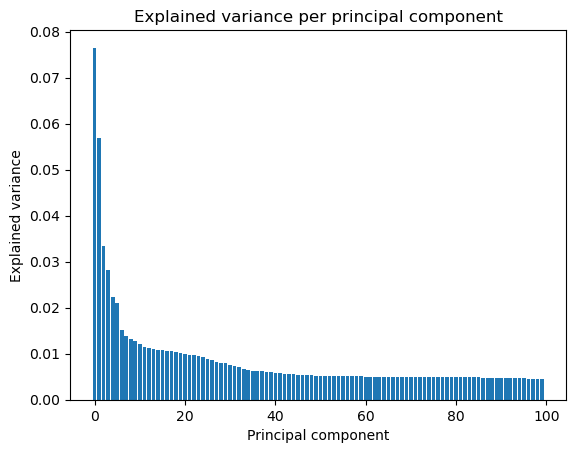

In [100]:
num_components=np.arange(len(pca_100.explained_variance_ratio_))
values=pca_100.explained_variance_ratio_
plt.bar(num_components,values)
plt.xlabel("Principal component")
plt.ylabel("Explained variance")
plt.title("Explained variance per principal component")
plt.show() 


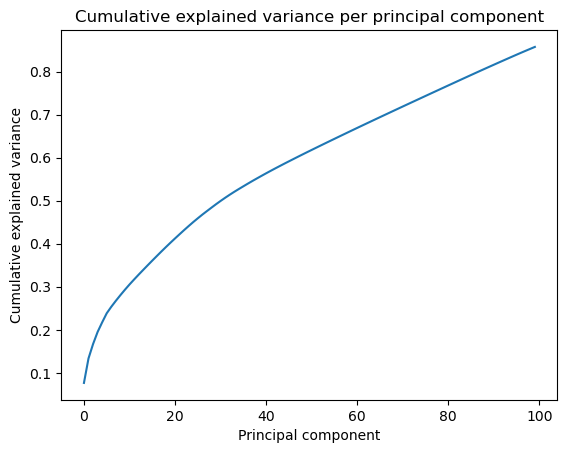

In [101]:
cum_vals = np.cumsum(values)
plt.plot(num_components,cum_vals)
plt.xlabel("Principal component")
plt.ylabel("Cumulative explained variance")
plt.title("Cumulative explained variance per principal component")
plt.show()

### Discussion 2.2: Perform Dimensionality Reduction

(Double-click this cell and replace this text with your own text, reporting your findings and decisions regarding dimensionality reduction. How many principal components / transformed features are you retaining for the next step of the analysis?)

I choose 100 principal components as they have a cumulative explained variance more than 80%

### Step 2.3: Interpret Principal Components

Now that we have our transformed principal components, it's a nice idea to check out the weight of each variable on the first few components to see if they can be interpreted in some fashion.

As a reminder, each principal component is a unit vector that points in the direction of highest variance (after accounting for the variance captured by earlier principal components). The further a weight is from zero, the more the principal component is in the direction of the corresponding feature. If two features have large weights of the same sign (both positive or both negative), then increases in one tend expect to be associated with increases in the other. To contrast, features with different signs can be expected to show a negative correlation: increases in one variable should result in a decrease in the other.

- To investigate the features, you should map each weight to their corresponding feature name, then sort the features according to weight. The most interesting features for each principal component, then, will be those at the beginning and end of the sorted list. Use the data dictionary document to help you understand these most prominent features, their relationships, and what a positive or negative value on the principal component might indicate.
- You should investigate and interpret feature associations from the first three principal components in this substep. To help facilitate this, you should write a function that you can call at any time to print the sorted list of feature weights, for the *i*-th principal component. This might come in handy in the next step of the project, when you interpret the tendencies of the discovered clusters.

In [102]:
# Map weights for the first principal component to corresponding feature names
# and then print the linked values, sorted by weight.
# HINT: Try defining a function here or in a new cell that you can reuse in the
# other cells.

def PCA_weights_mapper(df,pca,principal):
    weights=pd.DataFrame(pca.components_,columns=list(df.columns)).iloc[principal]
    weights.sort_values(ascending=False, inplace=True)
    return weights


In [103]:
PCA_weights_mapper(features_scaled,pca_100,0)

LP_STATUS_GROB_1.0       0.189753
PLZ8_ANTG3               0.179599
HH_EINKOMMEN_SCORE       0.177673
PLZ8_ANTG4               0.171724
PLZ8_BAUMAX              0.169350
ORTSGR_KLS9              0.152641
EWDICHTE                 0.151651
ANZ_HAUSHALTE_AKTIV      0.145714
FINANZ_HAUSBAUER         0.145654
PLZ8_ANTG2               0.136631
KBA05_BAUMAX             0.135389
LP_STATUS_FEIN_1.0       0.121286
LP_STATUS_FEIN_2.0       0.114816
FINANZ_SPARER            0.114748
FINANZTYP_1              0.113518
CAMEO_DEUG_2015_9        0.109108
RELAT_AB                 0.103568
LP_FAMILIE_GROB_1.0      0.098221
LP_FAMILIE_FEIN_1.0      0.098221
CAMEO_DEUG_2015_8        0.089620
KBA05_ANTG3              0.088074
SEMIO_PFLICHT            0.081665
SEMIO_REL                0.078634
decade                   0.078343
ZABEOTYP_5.0             0.077960
ARBEIT                   0.077899
KK_KUNDENTYP_nan         0.068103
SEMIO_RAT                0.067308
GEBAEUDETYP_3.0          0.065773
CAMEO_DEU_2015

In [104]:
# Map weights for the second principal component to corresponding feature names
# and then print the linked values, sorted by weight.

PCA_weights_mapper(features_scaled,pca_100,1)


ALTERSKATEGORIE_GROB     0.222578
FINANZ_VORSORGER         0.214722
ZABEOTYP_3.0             0.194028
SEMIO_ERL                0.166451
SEMIO_LUST               0.155619
RETOURTYP_BK_S           0.153863
W_KEIT_KIND_HH           0.129588
CJT_GESAMTTYP_2.0        0.107824
FINANZTYP_5              0.098501
LP_STATUS_FEIN_1.0       0.092007
FINANZTYP_2              0.091399
FINANZ_MINIMALIST        0.089669
FINANZ_HAUSBAUER         0.082944
KK_KUNDENTYP_nan         0.070754
CJT_GESAMTTYP_1.0        0.069740
SHOPPER_TYP_3.0          0.069030
LP_FAMILIE_GROB_1.0      0.066896
LP_FAMILIE_FEIN_1.0      0.066896
SEMIO_KRIT               0.065123
FINANZTYP_6              0.063225
PLZ8_ANTG3               0.060876
EWDICHTE                 0.059828
ORTSGR_KLS9              0.058383
PLZ8_ANTG4               0.058003
GFK_URLAUBERTYP_4.0      0.056900
PLZ8_BAUMAX              0.054762
LP_STATUS_FEIN_3.0       0.050578
PLZ8_ANTG2               0.048983
KBA05_BAUMAX             0.047290
SEMIO_KAEM    

In [105]:
# Map weights for the third principal component to corresponding feature names
# and then print the linked values, sorted by weight.

PCA_weights_mapper(features_scaled,pca_100,2)

SEMIO_VERT               0.322289
SEMIO_FAM                0.266454
SEMIO_KULT               0.260445
SEMIO_SOZ                0.259610
ZABEOTYP_nan             0.134484
FINANZ_MINIMALIST        0.128039
FINANZTYP_5              0.127105
SHOPPER_TYP_0.0          0.126701
SEMIO_REL                0.119928
SEMIO_MAT                0.096492
RETOURTYP_BK_S           0.067190
SHOPPER_TYP_1.0          0.059641
movement                 0.058339
W_KEIT_KIND_HH           0.056967
ORTSGR_KLS9              0.050316
EWDICHTE                 0.049986
PLZ8_BAUMAX              0.045577
PLZ8_ANTG3               0.041725
PLZ8_ANTG4               0.041511
LP_STATUS_FEIN_1.0       0.040394
LP_STATUS_GROB_5.0       0.039575
LP_STATUS_FEIN_10.0      0.039575
LP_STATUS_FEIN_3.0       0.039301
FINANZ_VORSORGER         0.038730
PLZ8_ANTG2               0.033265
LP_STATUS_GROB_3.0       0.028953
RELAT_AB                 0.027267
KBA05_BAUMAX             0.026279
GEBAEUDETYP_3.0          0.025726
GFK_URLAUBERTY

In [106]:
df_transformed = pd.DataFrame(df_transformed, columns=column_have_nulls, index=cleaned_population.index)

cleaned_population[column_have_nulls] = df_transformed

### Discussion 2.3: Interpret Principal Components

(Double-click this cell and replace this text with your own text, reporting your observations from detailed investigation of the first few principal components generated. Can we interpret positive and negative values from them in a meaningful way?)

After applying Principal Component Analysis (PCA), the first principal component (PC1) is derived as a linear combination of multiple features in the dataset. the following features are some of the features that positively contribute to PC1. such as:

1. LP_STATUS_GROB_1.0       1.919914e-01 - Person-level features
2. PLZ8_ANTG3               1.836906e-01 - PLZ8 macro-cell features
3. HH_EINKOMMEN_SCORE       1.798428e-01 - Household-level features
4. PLZ8_ANTG4               1.758859e-01 - PLZ8 macro-cell features
5. PLZ8_BAUMAX              1.734051e-01 - PLZ8 macro-cell features
6. ORTSGR_KLS9              1.570938e-01 - Community-level features

and some are negatively to contribute to PC1
1. wealth                  -1.803034e-01 
2. PLZ8_ANTG1              -1.836089e-01 - PLZ8 macro-cell features
3. MOBI_REGIO              -1.847414e-01 - RR1 region features
4. FINANZ_MINIMALIST       -1.863471e-01 - Person-level features

The second principal component (PC2) is derived as a linear combination of multiple features in the dataset. the following features are some of the features that positively contribute to PC2. such as:
1. ALTERSKATEGORIE_GROB     2.358707e-01 - Person-level features
2. FINANZ_VORSORGER         2.234778e-01 - Person-level features
3. ZABEOTYP_3.0             2.029613e-01 - Person-level features
4. SEMIO_ERL                1.803186e-01 - Person-level features
5. SEMIO_LUST               1.641805e-01 - Person-level features

and some are negatively to contribute to PC2
1. FINANZ_UNAUFFAELLIGER   -2.164378e-01 - Person-level features
2. SEMIO_REL               -2.181382e-01 - Person-level features
3. FINANZ_SPARER           -2.329107e-01 - Person-level features
4. decade                  -2.358777e-01 - Person-level features

The Thierd principal component (PC3) is derived as a linear combination of multiple features in the dataset. the following features are some of the features that positively contribute to PC3. such as:
1. LP_FAMILIE_FEIN_nan      4.045173e-01 - Person-level features
2. GFK_URLAUBERTYP_nan      4.045173e-01
3. LP_FAMILIE_GROB_nan      4.045173e-01
4. LP_STATUS_FEIN_nan       4.045173e-01
5. CJT_GESAMTTYP_nan        4.045173e-01

and some are negatively to contribute to PC3
1. LP_FAMILIE_FEIN_10.0    -2.757048e-02 - Person-level features
2. LP_FAMILIE_GROB_5.0     -3.381412e-02 - Person-level features
3. LP_LEBENSPHASE_GROB     -3.981046e-02 - Person-level features
4. LP_LEBENSPHASE_FEIN     -5.337575e-02 - Person-level features

## Step 3: Clustering

### Step 3.1: Apply Clustering to General Population

You've assessed and cleaned the demographics data, then scaled and transformed them. Now, it's time to see how the data clusters in the principal components space. In this substep, you will apply k-means clustering to the dataset and use the average within-cluster distances from each point to their assigned cluster's centroid to decide on a number of clusters to keep.

- Use sklearn's [KMeans](http://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html#sklearn.cluster.KMeans) class to perform k-means clustering on the PCA-transformed data.
- Then, compute the average difference from each point to its assigned cluster's center. **Hint**: The KMeans object's `.score()` method might be useful here, but note that in sklearn, scores tend to be defined so that larger is better. Try applying it to a small, toy dataset, or use an internet search to help your understanding.
- Perform the above two steps for a number of different cluster counts. You can then see how the average distance decreases with an increasing number of clusters. However, each additional cluster provides a smaller net benefit. Use this fact to select a final number of clusters in which to group the data. **Warning**: because of the large size of the dataset, it can take a long time for the algorithm to resolve. The more clusters to fit, the longer the algorithm will take. You should test for cluster counts through at least 10 clusters to get the full picture, but you shouldn't need to test for a number of clusters above about 30.
- Once you've selected a final number of clusters to use, re-fit a KMeans instance to perform the clustering operation. Make sure that you also obtain the cluster assignments for the general demographics data, since you'll be using them in the final Step 3.3.

In [107]:
# Over a number of different cluster counts...


    # run k-means clustering on the data and...
    
    
    # compute the average within-cluster distances.

Ks=[2,4,6,8,10,12,14,16,18,20,22,24,26,28,30]
scores=[]
for k in Ks:
    kmeans = KMeans(n_clusters=k)
    model = kmeans.fit(features_scaled)
    score = np.abs(model.score(features_scaled))
    scores.append(score)
    
    

C:\Users\User\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\User\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\User\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\User\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
C:\Users\User\anaconda3\lib\site-packages\sklearn\cluster\_k

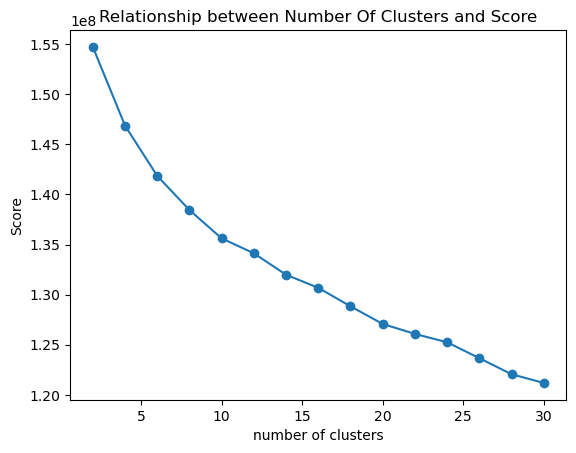

In [108]:
# Investigate the change in within-cluster distance across number of clusters.
# HINT: Use matplotlib's plot function to visualize this relationship.

plt.plot(Ks,scores,marker='o')
plt.xlabel('number of clusters')
plt.ylabel('Score')
plt.title("Relationship between Number Of Clusters and Score")
plt.show()

In [109]:
# Re-fit the k-means model with the selected number of clusters and obtain
# cluster predictions for the general population demographics data.

kmeans = KMeans(n_clusters=22)
model=kmeans.fit(pca_100_data)
population_pred=model.predict(pca_100_data)


C:\Users\User\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [110]:
population_pred

array([ 1,  6, 11, ...,  0, 12,  2])

### Discussion 3.1: Apply Clustering to General Population

(Double-click this cell and replace this text with your own text, reporting your findings and decisions regarding clustering. Into how many clusters have you decided to segment the population?)

The optimal number of clusters is typically selected at the point where the score begins to increase sharply or stops decreasing. In our case, the score continues to decrease, but it is worth noting that the rate of decrease is more pronounced up to 20 clusters. After 20 clusters, the rate of decrease slows down. Therefore, I would choose 20 clusters to strike a balance between the number of clusters and the complexity of the model.

### Step 3.2: Apply All Steps to the Customer Data

Now that you have clusters and cluster centers for the general population, it's time to see how the customer data maps on to those clusters. Take care to not confuse this for re-fitting all of the models to the customer data. Instead, you're going to use the fits from the general population to clean, transform, and cluster the customer data. In the last step of the project, you will interpret how the general population fits apply to the customer data.

- Don't forget when loading in the customers data, that it is semicolon (`;`) delimited.
- Apply the same feature wrangling, selection, and engineering steps to the customer demographics using the `clean_data()` function you created earlier. (You can assume that the customer demographics data has similar meaning behind missing data patterns as the general demographics data.)
- Use the sklearn objects from the general demographics data, and apply their transformations to the customers data. That is, you should not be using a `.fit()` or `.fit_transform()` method to re-fit the old objects, nor should you be creating new sklearn objects! Carry the data through the feature scaling, PCA, and clustering steps, obtaining cluster assignments for all of the data in the customer demographics data.

In [111]:
# Load in the customer demographics data.

# Note: THIS WAS DONE | Customers are loaded in the loading section 

customers.head()

,AGER_TYP,ALTERSKATEGORIE_GROB,ANREDE_KZ,CJT_GESAMTTYP,FINANZ_MINIMALIST,FINANZ_SPARER,FINANZ_VORSORGER,FINANZ_ANLEGER,FINANZ_UNAUFFAELLIGER,FINANZ_HAUSBAUER,FINANZTYP,GEBURTSJAHR,GFK_URLAUBERTYP,GREEN_AVANTGARDE,HEALTH_TYP,LP_LEBENSPHASE_FEIN,LP_LEBENSPHASE_GROB,LP_FAMILIE_FEIN,LP_FAMILIE_GROB,LP_STATUS_FEIN,LP_STATUS_GROB,NATIONALITAET_KZ,PRAEGENDE_JUGENDJAHRE,RETOURTYP_BK_S,SEMIO_SOZ,SEMIO_FAM,SEMIO_REL,SEMIO_MAT,SEMIO_VERT,SEMIO_LUST,SEMIO_ERL,SEMIO_KULT,SEMIO_RAT,SEMIO_KRIT,SEMIO_DOM,SEMIO_KAEM,SEMIO_PFLICHT,SEMIO_TRADV,SHOPPER_TYP,SOHO_KZ,TITEL_KZ,VERS_TYP,ZABEOTYP,ALTER_HH,ANZ_PERSONEN,ANZ_TITEL,HH_EINKOMMEN_SCORE,KK_KUNDENTYP,W_KEIT_KIND_HH,WOHNDAUER_2008,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,GEBAEUDETYP,KONSUMNAEHE,MIN_GEBAEUDEJAHR,OST_WEST_KZ,WOHNLAGE,CAMEO_DEUG_2015,CAMEO_DEU_2015,CAMEO_INTL_2015,KBA05_ANTG1,KBA05_ANTG2,KBA05_ANTG3,KBA05_ANTG4,KBA05_BAUMAX,KBA05_GBZ,BALLRAUM,EWDICHTE,INNENSTADT,GEBAEUDETYP_RASTER,KKK,MOBI_REGIO,ONLINE_AFFINITAET,REGIOTYP,KBA13_ANZAHL_PKW,PLZ8_ANTG1,PLZ8_ANTG2,PLZ8_ANTG3,PLZ8_ANTG4,PLZ8_BAUMAX,PLZ8_HHZ,PLZ8_GBZ,ARBEIT,ORTSGR_KLS9,RELAT_AB
0,2,4,1,5.0,5,1,5,1,2,2,2,0,4.0,1,1,20.0,5.0,2.0,2.0,10.0,5.0,1,4,5.0,6,5,2,6,6,7,3,4,1,3,1,1,2,1,3,0.0,0.0,1,3,10.0,2.0,0.0,1.0,NaN,6.0,9.0,1.0,0.0,1.0,5.0,1992.0,W,7.0,1,1A,13,2.0,2.0,0.0,0.0,0.0,4.0,3.0,2.0,4.0,4.0,1.0,4.0,3.0,1.0,1201.0,3.0,3.0,1.0,0.0,1.0,5.0,5.0,1.0,2.0,1.0
1,-1,4,1,NaN,5,1,5,1,3,2,2,0,NaN,0,1,NaN,NaN,NaN,NaN,NaN,NaN,1,0,NaN,3,6,2,6,7,5,3,4,1,3,3,2,4,1,3,0.0,0.0,1,3,11.0,3.0,0.0,NaN,NaN,0.0,9.0,NaN,NaN,NaN,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,-1,4,2,2.0,5,1,5,1,4,4,2,0,3.0,1,2,13.0,3.0,1.0,1.0,10.0,5.0,1,4,5.0,2,2,1,3,3,7,7,1,2,7,5,6,4,1,1,0.0,0.0,2,3,6.0,1.0,0.0,1.0,NaN,6.0,9.0,1.0,0.0,8.0,1.0,1992.0,W,2.0,5,5D,34,2.0,2.0,0.0,0.0,0.0,3.0,7.0,4.0,1.0,3.0,3.0,3.0,1.0,7.0,433.0,2.0,3.0,3.0,1.0,3.0,3.0,2.0,3.0,5.0,3.0
3,1,4,1,2.0,5,1,5,2,1,2,6,0,10.0,0,2,0.0,0.0,0.0,0.0,9.0,4.0,1,1,3.0,6,5,3,4,7,5,3,4,3,3,3,3,3,4,0,0.0,0.0,1,1,8.0,0.0,0.0,4.0,NaN,NaN,9.0,0.0,NaN,2.0,2.0,1992.0,W,7.0,4,4C,24,3.0,0.0,0.0,0.0,1.0,4.0,7.0,1.0,7.0,4.0,3.0,4.0,2.0,6.0,755.0,3.0,2.0,1.0,0.0,1.0,3.0,4.0,1.0,3.0,1.0
4,-1,3,1,6.0,3,1,4,4,5,2,2,1960,2.0,0,3,31.0,10.0,10.0,5.0,1.0,1.0,1,8,5.0,4,5,4,6,5,6,4,5,5,3,5,2,5,4,1,0.0,0.0,2,1,20.0,4.0,0.0,6.0,2.0,2.0,9.0,7.0,0.0,3.0,1.0,1992.0,W,3.0,7,7B,41,0.0,3.0,2.0,0.0,0.0,3.0,3.0,4.0,4.0,3.0,4.0,3.0,5.0,7.0,513.0,2.0,4.0,2.0,1.0,2.0,3.0,3.0,3.0,5.0,1.0


In [112]:
cleaned_customers = clean_data(customers)


****************************************
Start Replacing Unknown values with NaNs
****************************************


**************************************************
Start Removing Outliers

**************************************************
Rows with null values equal or greater than %0.7


C:\Users\User\AppData\Local\Temp\ipykernel_2316\1665795460.py:22: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  cleaned_data_1 = without_outliers[null_rows_count < rows_threshold]



****************************************
Start Binary-Category Encoding
****************************************

Values for ANREDE_KZ before transformation:
1    94822
2    46850
Name: ANREDE_KZ, dtype: int64
Values for GREEN_AVANTGARDE before transformation:
0    71307
1    70365
Name: GREEN_AVANTGARDE, dtype: int64
Values for VERS_TYP before transformation:
1.0    70605
2.0    68741
Name: VERS_TYP, dtype: int64
Values for OST_WEST_KZ before transformation:
W    130332
O     11340
Name: OST_WEST_KZ, dtype: int64
['ANREDE_KZ', 'GREEN_AVANTGARDE', 'VERS_TYP', 'OST_WEST_KZ']
Values for ANREDE_KZ after transformation:
0    94822
1    46850
Name: ANREDE_KZ, dtype: int64
Values for GREEN_AVANTGARDE after transformation:
0    71307
1    70365
Name: GREEN_AVANTGARDE, dtype: int64


C:\Users\User\AppData\Local\Temp\ipykernel_2316\1080023015.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[column] = label_encoder.fit_transform(df[column])
C:\Users\User\AppData\Local\Temp\ipykernel_2316\1080023015.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[column] = label_encoder.fit_transform(df[column])
C:\Users\User\AppData\Local\Temp\ipykernel_2316\1080023015.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

Values for VERS_TYP after transformation:
0    70605
1    68741
2     2326
Name: VERS_TYP, dtype: int64
Values for OST_WEST_KZ after transformation:
1    130332
0     11340
Name: OST_WEST_KZ, dtype: int64

****************************************
Start Multi-Category Encoding
****************************************

many_categories size = 15
OneHotEncoder will be applied on the following columns: 
['AGER_TYP', 'CJT_GESAMTTYP', 'FINANZTYP', 'GFK_URLAUBERTYP', 'LP_FAMILIE_FEIN', 'LP_FAMILIE_GROB', 'LP_STATUS_FEIN', 'LP_STATUS_GROB', 'SHOPPER_TYP', 'VERS_TYP', 'ZABEOTYP', 'KK_KUNDENTYP', 'GEBAEUDETYP', 'CAMEO_DEUG_2015', 'CAMEO_DEU_2015']

****************************************
Start Engineering PRAEGENDE_JUGENDJAHRE
****************************************

    movement  decade  PRAEGENDE_JUGENDJAHRE
0        1.0     1.0                    4.0
2        1.0     1.0                    4.0
3        0.0     0.0                    1.0
4        0.0     3.0                    8.0
5        1.

In [113]:
# customers were cleaned using clean_data function
cleaned_customers.head()

,ALTERSKATEGORIE_GROB,ANREDE_KZ,FINANZ_MINIMALIST,FINANZ_SPARER,FINANZ_VORSORGER,FINANZ_ANLEGER,FINANZ_UNAUFFAELLIGER,FINANZ_HAUSBAUER,GEBURTSJAHR,GREEN_AVANTGARDE,HEALTH_TYP,LP_LEBENSPHASE_FEIN,LP_LEBENSPHASE_GROB,NATIONALITAET_KZ,RETOURTYP_BK_S,SEMIO_SOZ,SEMIO_FAM,SEMIO_REL,SEMIO_MAT,SEMIO_VERT,SEMIO_LUST,SEMIO_ERL,SEMIO_KULT,SEMIO_RAT,SEMIO_KRIT,SEMIO_DOM,SEMIO_KAEM,SEMIO_PFLICHT,SEMIO_TRADV,SOHO_KZ,TITEL_KZ,ALTER_HH,ANZ_PERSONEN,ANZ_TITEL,HH_EINKOMMEN_SCORE,W_KEIT_KIND_HH,WOHNDAUER_2008,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,KONSUMNAEHE,MIN_GEBAEUDEJAHR,OST_WEST_KZ,WOHNLAGE,KBA05_ANTG1,KBA05_ANTG2,KBA05_ANTG3,KBA05_ANTG4,KBA05_BAUMAX,KBA05_GBZ,BALLRAUM,EWDICHTE,INNENSTADT,GEBAEUDETYP_RASTER,KKK,MOBI_REGIO,ONLINE_AFFINITAET,REGIOTYP,KBA13_ANZAHL_PKW,PLZ8_ANTG1,PLZ8_ANTG2,PLZ8_ANTG3,PLZ8_ANTG4,PLZ8_BAUMAX,PLZ8_HHZ,PLZ8_GBZ,ARBEIT,ORTSGR_KLS9,RELAT_AB,AGER_TYP_1.0,AGER_TYP_2.0,AGER_TYP_3.0,AGER_TYP_nan,CJT_GESAMTTYP_1.0,CJT_GESAMTTYP_2.0,CJT_GESAMTTYP_3.0,CJT_GESAMTTYP_4.0,CJT_GESAMTTYP_5.0,CJT_GESAMTTYP_6.0,CJT_GESAMTTYP_nan,FINANZTYP_1,FINANZTYP_2,FINANZTYP_3,FINANZTYP_4,FINANZTYP_5,FINANZTYP_6,GFK_URLAUBERTYP_1.0,GFK_URLAUBERTYP_2.0,GFK_URLAUBERTYP_3.0,GFK_URLAUBERTYP_4.0,GFK_URLAUBERTYP_5.0,GFK_URLAUBERTYP_6.0,GFK_URLAUBERTYP_7.0,GFK_URLAUBERTYP_8.0,GFK_URLAUBERTYP_9.0,GFK_URLAUBERTYP_10.0,GFK_URLAUBERTYP_11.0,GFK_URLAUBERTYP_12.0,GFK_URLAUBERTYP_nan,LP_FAMILIE_FEIN_1.0,LP_FAMILIE_FEIN_2.0,LP_FAMILIE_FEIN_3.0,LP_FAMILIE_FEIN_4.0,LP_FAMILIE_FEIN_5.0,LP_FAMILIE_FEIN_6.0,LP_FAMILIE_FEIN_7.0,LP_FAMILIE_FEIN_8.0,LP_FAMILIE_FEIN_9.0,LP_FAMILIE_FEIN_10.0,LP_FAMILIE_FEIN_11.0,LP_FAMILIE_FEIN_nan,LP_FAMILIE_GROB_1.0,LP_FAMILIE_GROB_2.0,LP_FAMILIE_GROB_3.0,LP_FAMILIE_GROB_4.0,LP_FAMILIE_GROB_5.0,LP_FAMILIE_GROB_nan,LP_STATUS_FEIN_1.0,LP_STATUS_FEIN_2.0,LP_STATUS_FEIN_3.0,LP_STATUS_FEIN_4.0,LP_STATUS_FEIN_5.0,LP_STATUS_FEIN_6.0,LP_STATUS_FEIN_7.0,LP_STATUS_FEIN_8.0,LP_STATUS_FEIN_9.0,LP_STATUS_FEIN_10.0,LP_STATUS_FEIN_nan,LP_STATUS_GROB_1.0,LP_STATUS_GROB_2.0,LP_STATUS_GROB_3.0,LP_STATUS_GROB_4.0,LP_STATUS_GROB_5.0,LP_STATUS_GROB_nan,SHOPPER_TYP_0.0,SHOPPER_TYP_1.0,SHOPPER_TYP_2.0,SHOPPER_TYP_3.0,SHOPPER_TYP_nan,VERS_TYP_0,VERS_TYP_1,VERS_TYP_2,ZABEOTYP_1,ZABEOTYP_2,ZABEOTYP_3,ZABEOTYP_4,ZABEOTYP_5,ZABEOTYP_6,KK_KUNDENTYP_1.0,KK_KUNDENTYP_2.0,KK_KUNDENTYP_3.0,KK_KUNDENTYP_4.0,KK_KUNDENTYP_5.0,KK_KUNDENTYP_6.0,KK_KUNDENTYP_nan,GEBAEUDETYP_1.0,GEBAEUDETYP_2.0,GEBAEUDETYP_3.0,GEBAEUDETYP_4.0,GEBAEUDETYP_6.0,GEBAEUDETYP_nan,CAMEO_DEUG_2015_1,CAMEO_DEUG_2015_2,CAMEO_DEUG_2015_3,CAMEO_DEUG_2015_4,CAMEO_DEUG_2015_5,CAMEO_DEUG_2015_6,CAMEO_DEUG_2015_7,CAMEO_DEUG_2015_8,CAMEO_DEUG_2015_9,CAMEO_DEUG_2015_nan,CAMEO_DEU_2015_1A,CAMEO_DEU_2015_1B,CAMEO_DEU_2015_1C,CAMEO_DEU_2015_1D,CAMEO_DEU_2015_1E,CAMEO_DEU_2015_2A,CAMEO_DEU_2015_2B,CAMEO_DEU_2015_2C,CAMEO_DEU_2015_2D,CAMEO_DEU_2015_3A,CAMEO_DEU_2015_3B,CAMEO_DEU_2015_3C,CAMEO_DEU_2015_3D,CAMEO_DEU_2015_4A,CAMEO_DEU_2015_4B,CAMEO_DEU_2015_4C,CAMEO_DEU_2015_4D,CAMEO_DEU_2015_4E,CAMEO_DEU_2015_5A,CAMEO_DEU_2015_5B,CAMEO_DEU_2015_5C,CAMEO_DEU_2015_5D,CAMEO_DEU_2015_5E,CAMEO_DEU_2015_5F,CAMEO_DEU_2015_6A,CAMEO_DEU_2015_6B,CAMEO_DEU_2015_6C,CAMEO_DEU_2015_6D,CAMEO_DEU_2015_6E,CAMEO_DEU_2015_6F,CAMEO_DEU_2015_7A,CAMEO_DEU_2015_7B,CAMEO_DEU_2015_7C,CAMEO_DEU_2015_7D,CAMEO_DEU_2015_7E,CAMEO_DEU_2015_8A,CAMEO_DEU_2015_8B,CAMEO_DEU_2015_8C,CAMEO_DEU_2015_8D,CAMEO_DEU_2015_9A,CAMEO_DEU_2015_9B,CAMEO_DEU_2015_9C,CAMEO_DEU_2015_9D,CAMEO_DEU_2015_9E,CAMEO_DEU_2015_nan,movement,decade,wealth,life_stage
0,4.0,0,5,1,5,1,2,2.0,NaN,1,1.0,20.0,5.0,1.0,5.0,6,5,2,6,6,7.0,3,4,1,3,1,1,2,1,0.0,NaN,10.0,2.0,0.0,1.0,6.0,9.0,1.0,0.0,5.0,1992.0,1,7.0,2.0,2.0,0.0,0.0,NaN,4.0,3.0,2.0,4.0,4.0,1.0,4.0,3.0,1.0,1201.0,3.0,3.0,1.0,0.0,1.0,5.0,5.0,1.0,2.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1

In [114]:
print(f' cleaned_customers Shape = {cleaned_customers.shape}')
print(f' cleaned_population Shape = {cleaned_population.shape}')

 cleaned_customers Shape = (141672, 219)
 cleaned_population Shape = (797628, 214)


In [115]:
extra_columns_in_customers = [col for col in cleaned_customers.columns if col not in cleaned_population.columns]
print(extra_columns_in_customers)

['TITEL_KZ', 'AGER_TYP_1.0', 'AGER_TYP_2.0', 'AGER_TYP_3.0', 'AGER_TYP_nan', 'ZABEOTYP_1', 'ZABEOTYP_2', 'ZABEOTYP_3', 'ZABEOTYP_4', 'ZABEOTYP_5', 'ZABEOTYP_6']


In [116]:
cleaned_customers.drop(columns=extra_columns_in_customers, axis=1, inplace=True)

In [117]:

missing_columns_in_customers = [col for col in cleaned_population.columns if col not in cleaned_customers.columns]
print(missing_columns_in_customers)

['ZABEOTYP_2.0', 'ZABEOTYP_3.0', 'ZABEOTYP_4.0', 'ZABEOTYP_5.0', 'ZABEOTYP_nan', 'GEBAEUDETYP_5.0']


In [118]:
cleaned_customers[missing_columns_in_customers] = 0
cleaned_customers.shape

(141672, 214)

In [119]:
cleaned_customers.head(1)

,ALTERSKATEGORIE_GROB,ANREDE_KZ,FINANZ_MINIMALIST,FINANZ_SPARER,FINANZ_VORSORGER,FINANZ_ANLEGER,FINANZ_UNAUFFAELLIGER,FINANZ_HAUSBAUER,GEBURTSJAHR,GREEN_AVANTGARDE,HEALTH_TYP,LP_LEBENSPHASE_FEIN,LP_LEBENSPHASE_GROB,NATIONALITAET_KZ,RETOURTYP_BK_S,SEMIO_SOZ,SEMIO_FAM,SEMIO_REL,SEMIO_MAT,SEMIO_VERT,SEMIO_LUST,SEMIO_ERL,SEMIO_KULT,SEMIO_RAT,SEMIO_KRIT,SEMIO_DOM,SEMIO_KAEM,SEMIO_PFLICHT,SEMIO_TRADV,SOHO_KZ,ALTER_HH,ANZ_PERSONEN,ANZ_TITEL,HH_EINKOMMEN_SCORE,W_KEIT_KIND_HH,WOHNDAUER_2008,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,KONSUMNAEHE,MIN_GEBAEUDEJAHR,OST_WEST_KZ,WOHNLAGE,KBA05_ANTG1,KBA05_ANTG2,KBA05_ANTG3,KBA05_ANTG4,KBA05_BAUMAX,KBA05_GBZ,BALLRAUM,EWDICHTE,INNENSTADT,GEBAEUDETYP_RASTER,KKK,MOBI_REGIO,ONLINE_AFFINITAET,REGIOTYP,KBA13_ANZAHL_PKW,PLZ8_ANTG1,PLZ8_ANTG2,PLZ8_ANTG3,PLZ8_ANTG4,PLZ8_BAUMAX,PLZ8_HHZ,PLZ8_GBZ,ARBEIT,ORTSGR_KLS9,RELAT_AB,CJT_GESAMTTYP_1.0,CJT_GESAMTTYP_2.0,CJT_GESAMTTYP_3.0,CJT_GESAMTTYP_4.0,CJT_GESAMTTYP_5.0,CJT_GESAMTTYP_6.0,CJT_GESAMTTYP_nan,FINANZTYP_1,FINANZTYP_2,FINANZTYP_3,FINANZTYP_4,FINANZTYP_5,FINANZTYP_6,GFK_URLAUBERTYP_1.0,GFK_URLAUBERTYP_2.0,GFK_URLAUBERTYP_3.0,GFK_URLAUBERTYP_4.0,GFK_URLAUBERTYP_5.0,GFK_URLAUBERTYP_6.0,GFK_URLAUBERTYP_7.0,GFK_URLAUBERTYP_8.0,GFK_URLAUBERTYP_9.0,GFK_URLAUBERTYP_10.0,GFK_URLAUBERTYP_11.0,GFK_URLAUBERTYP_12.0,GFK_URLAUBERTYP_nan,LP_FAMILIE_FEIN_1.0,LP_FAMILIE_FEIN_2.0,LP_FAMILIE_FEIN_3.0,LP_FAMILIE_FEIN_4.0,LP_FAMILIE_FEIN_5.0,LP_FAMILIE_FEIN_6.0,LP_FAMILIE_FEIN_7.0,LP_FAMILIE_FEIN_8.0,LP_FAMILIE_FEIN_9.0,LP_FAMILIE_FEIN_10.0,LP_FAMILIE_FEIN_11.0,LP_FAMILIE_FEIN_nan,LP_FAMILIE_GROB_1.0,LP_FAMILIE_GROB_2.0,LP_FAMILIE_GROB_3.0,LP_FAMILIE_GROB_4.0,LP_FAMILIE_GROB_5.0,LP_FAMILIE_GROB_nan,LP_STATUS_FEIN_1.0,LP_STATUS_FEIN_2.0,LP_STATUS_FEIN_3.0,LP_STATUS_FEIN_4.0,LP_STATUS_FEIN_5.0,LP_STATUS_FEIN_6.0,LP_STATUS_FEIN_7.0,LP_STATUS_FEIN_8.0,LP_STATUS_FEIN_9.0,LP_STATUS_FEIN_10.0,LP_STATUS_FEIN_nan,LP_STATUS_GROB_1.0,LP_STATUS_GROB_2.0,LP_STATUS_GROB_3.0,LP_STATUS_GROB_4.0,LP_STATUS_GROB_5.0,LP_STATUS_GROB_nan,SHOPPER_TYP_0.0,SHOPPER_TYP_1.0,SHOPPER_TYP_2.0,SHOPPER_TYP_3.0,SHOPPER_TYP_nan,VERS_TYP_0,VERS_TYP_1,VERS_TYP_2,KK_KUNDENTYP_1.0,KK_KUNDENTYP_2.0,KK_KUNDENTYP_3.0,KK_KUNDENTYP_4.0,KK_KUNDENTYP_5.0,KK_KUNDENTYP_6.0,KK_KUNDENTYP_nan,GEBAEUDETYP_1.0,GEBAEUDETYP_2.0,GEBAEUDETYP_3.0,GEBAEUDETYP_4.0,GEBAEUDETYP_6.0,GEBAEUDETYP_nan,CAMEO_DEUG_2015_1,CAMEO_DEUG_2015_2,CAMEO_DEUG_2015_3,CAMEO_DEUG_2015_4,CAMEO_DEUG_2015_5,CAMEO_DEUG_2015_6,CAMEO_DEUG_2015_7,CAMEO_DEUG_2015_8,CAMEO_DEUG_2015_9,CAMEO_DEUG_2015_nan,CAMEO_DEU_2015_1A,CAMEO_DEU_2015_1B,CAMEO_DEU_2015_1C,CAMEO_DEU_2015_1D,CAMEO_DEU_2015_1E,CAMEO_DEU_2015_2A,CAMEO_DEU_2015_2B,CAMEO_DEU_2015_2C,CAMEO_DEU_2015_2D,CAMEO_DEU_2015_3A,CAMEO_DEU_2015_3B,CAMEO_DEU_2015_3C,CAMEO_DEU_2015_3D,CAMEO_DEU_2015_4A,CAMEO_DEU_2015_4B,CAMEO_DEU_2015_4C,CAMEO_DEU_2015_4D,CAMEO_DEU_2015_4E,CAMEO_DEU_2015_5A,CAMEO_DEU_2015_5B,CAMEO_DEU_2015_5C,CAMEO_DEU_2015_5D,CAMEO_DEU_2015_5E,CAMEO_DEU_2015_5F,CAMEO_DEU_2015_6A,CAMEO_DEU_2015_6B,CAMEO_DEU_2015_6C,CAMEO_DEU_2015_6D,CAMEO_DEU_2015_6E,CAMEO_DEU_2015_6F,CAMEO_DEU_2015_7A,CAMEO_DEU_2015_7B,CAMEO_DEU_2015_7C,CAMEO_DEU_2015_7D,CAMEO_DEU_2015_7E,CAMEO_DEU_2015_8A,CAMEO_DEU_2015_8B,CAMEO_DEU_2015_8C,CAMEO_DEU_2015_8D,CAMEO_DEU_2015_9A,CAMEO_DEU_2015_9B,CAMEO_DEU_2015_9C,CAMEO_DEU_2015_9D,CAMEO_DEU_2015_9E,CAMEO_DEU_2015_nan,movement,decade,wealth,life_stage,ZABEOTYP_2.0,ZABEOTYP_3.0,ZABEOTYP_4.0,ZABEOTYP_5.0,ZABEOTYP_nan,GEBAEUDETYP_5.0
0,4.0,0,5,1,5,1,2,2.0,NaN,1,1.0,20.0,5.0,1.0,5.0,6,5,2,6,6,7.0,3,4,1,3,1,1,2,1,0.0,10.0,2.0,0.0,1.0,6.0,9.0,1.0,0.0,5.0,1992.0,1,7.0,2.0,2.0,0.0,0.0,NaN,4.0,3.0,2.0,4.0,4.0,1.0,4.0,3.0,1.0,1201.0,3.0,3.0,1.0,0.0,1.0,5.0,5.0,1.0,2.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0

In [120]:
# Apply preprocessing, feature transformation, and clustering from the general
# demographics onto the customer data, obtaining cluster predictions for the
# customer demographics data.

customers_imputer = imputer.fit_transform(cleaned_customers[column_have_nulls])
customers_imputer = pd.DataFrame(customers_imputer, columns=column_have_nulls, index=cleaned_customers.index)


In [121]:
customers_imputer.shape

(141672, 214)

In [122]:
cleaned_customers[column_have_nulls] = customers_imputer[column_have_nulls]
cleaned_customers.head()

,ALTERSKATEGORIE_GROB,ANREDE_KZ,FINANZ_MINIMALIST,FINANZ_SPARER,FINANZ_VORSORGER,FINANZ_ANLEGER,FINANZ_UNAUFFAELLIGER,FINANZ_HAUSBAUER,GEBURTSJAHR,GREEN_AVANTGARDE,HEALTH_TYP,LP_LEBENSPHASE_FEIN,LP_LEBENSPHASE_GROB,NATIONALITAET_KZ,RETOURTYP_BK_S,SEMIO_SOZ,SEMIO_FAM,SEMIO_REL,SEMIO_MAT,SEMIO_VERT,SEMIO_LUST,SEMIO_ERL,SEMIO_KULT,SEMIO_RAT,SEMIO_KRIT,SEMIO_DOM,SEMIO_KAEM,SEMIO_PFLICHT,SEMIO_TRADV,SOHO_KZ,ALTER_HH,ANZ_PERSONEN,ANZ_TITEL,HH_EINKOMMEN_SCORE,W_KEIT_KIND_HH,WOHNDAUER_2008,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,KONSUMNAEHE,MIN_GEBAEUDEJAHR,OST_WEST_KZ,WOHNLAGE,KBA05_ANTG1,KBA05_ANTG2,KBA05_ANTG3,KBA05_ANTG4,KBA05_BAUMAX,KBA05_GBZ,BALLRAUM,EWDICHTE,INNENSTADT,GEBAEUDETYP_RASTER,KKK,MOBI_REGIO,ONLINE_AFFINITAET,REGIOTYP,KBA13_ANZAHL_PKW,PLZ8_ANTG1,PLZ8_ANTG2,PLZ8_ANTG3,PLZ8_ANTG4,PLZ8_BAUMAX,PLZ8_HHZ,PLZ8_GBZ,ARBEIT,ORTSGR_KLS9,RELAT_AB,CJT_GESAMTTYP_1.0,CJT_GESAMTTYP_2.0,CJT_GESAMTTYP_3.0,CJT_GESAMTTYP_4.0,CJT_GESAMTTYP_5.0,CJT_GESAMTTYP_6.0,CJT_GESAMTTYP_nan,FINANZTYP_1,FINANZTYP_2,FINANZTYP_3,FINANZTYP_4,FINANZTYP_5,FINANZTYP_6,GFK_URLAUBERTYP_1.0,GFK_URLAUBERTYP_2.0,GFK_URLAUBERTYP_3.0,GFK_URLAUBERTYP_4.0,GFK_URLAUBERTYP_5.0,GFK_URLAUBERTYP_6.0,GFK_URLAUBERTYP_7.0,GFK_URLAUBERTYP_8.0,GFK_URLAUBERTYP_9.0,GFK_URLAUBERTYP_10.0,GFK_URLAUBERTYP_11.0,GFK_URLAUBERTYP_12.0,GFK_URLAUBERTYP_nan,LP_FAMILIE_FEIN_1.0,LP_FAMILIE_FEIN_2.0,LP_FAMILIE_FEIN_3.0,LP_FAMILIE_FEIN_4.0,LP_FAMILIE_FEIN_5.0,LP_FAMILIE_FEIN_6.0,LP_FAMILIE_FEIN_7.0,LP_FAMILIE_FEIN_8.0,LP_FAMILIE_FEIN_9.0,LP_FAMILIE_FEIN_10.0,LP_FAMILIE_FEIN_11.0,LP_FAMILIE_FEIN_nan,LP_FAMILIE_GROB_1.0,LP_FAMILIE_GROB_2.0,LP_FAMILIE_GROB_3.0,LP_FAMILIE_GROB_4.0,LP_FAMILIE_GROB_5.0,LP_FAMILIE_GROB_nan,LP_STATUS_FEIN_1.0,LP_STATUS_FEIN_2.0,LP_STATUS_FEIN_3.0,LP_STATUS_FEIN_4.0,LP_STATUS_FEIN_5.0,LP_STATUS_FEIN_6.0,LP_STATUS_FEIN_7.0,LP_STATUS_FEIN_8.0,LP_STATUS_FEIN_9.0,LP_STATUS_FEIN_10.0,LP_STATUS_FEIN_nan,LP_STATUS_GROB_1.0,LP_STATUS_GROB_2.0,LP_STATUS_GROB_3.0,LP_STATUS_GROB_4.0,LP_STATUS_GROB_5.0,LP_STATUS_GROB_nan,SHOPPER_TYP_0.0,SHOPPER_TYP_1.0,SHOPPER_TYP_2.0,SHOPPER_TYP_3.0,SHOPPER_TYP_nan,VERS_TYP_0,VERS_TYP_1,VERS_TYP_2,KK_KUNDENTYP_1.0,KK_KUNDENTYP_2.0,KK_KUNDENTYP_3.0,KK_KUNDENTYP_4.0,KK_KUNDENTYP_5.0,KK_KUNDENTYP_6.0,KK_KUNDENTYP_nan,GEBAEUDETYP_1.0,GEBAEUDETYP_2.0,GEBAEUDETYP_3.0,GEBAEUDETYP_4.0,GEBAEUDETYP_6.0,GEBAEUDETYP_nan,CAMEO_DEUG_2015_1,CAMEO_DEUG_2015_2,CAMEO_DEUG_2015_3,CAMEO_DEUG_2015_4,CAMEO_DEUG_2015_5,CAMEO_DEUG_2015_6,CAMEO_DEUG_2015_7,CAMEO_DEUG_2015_8,CAMEO_DEUG_2015_9,CAMEO_DEUG_2015_nan,CAMEO_DEU_2015_1A,CAMEO_DEU_2015_1B,CAMEO_DEU_2015_1C,CAMEO_DEU_2015_1D,CAMEO_DEU_2015_1E,CAMEO_DEU_2015_2A,CAMEO_DEU_2015_2B,CAMEO_DEU_2015_2C,CAMEO_DEU_2015_2D,CAMEO_DEU_2015_3A,CAMEO_DEU_2015_3B,CAMEO_DEU_2015_3C,CAMEO_DEU_2015_3D,CAMEO_DEU_2015_4A,CAMEO_DEU_2015_4B,CAMEO_DEU_2015_4C,CAMEO_DEU_2015_4D,CAMEO_DEU_2015_4E,CAMEO_DEU_2015_5A,CAMEO_DEU_2015_5B,CAMEO_DEU_2015_5C,CAMEO_DEU_2015_5D,CAMEO_DEU_2015_5E,CAMEO_DEU_2015_5F,CAMEO_DEU_2015_6A,CAMEO_DEU_2015_6B,CAMEO_DEU_2015_6C,CAMEO_DEU_2015_6D,CAMEO_DEU_2015_6E,CAMEO_DEU_2015_6F,CAMEO_DEU_2015_7A,CAMEO_DEU_2015_7B,CAMEO_DEU_2015_7C,CAMEO_DEU_2015_7D,CAMEO_DEU_2015_7E,CAMEO_DEU_2015_8A,CAMEO_DEU_2015_8B,CAMEO_DEU_2015_8C,CAMEO_DEU_2015_8D,CAMEO_DEU_2015_9A,CAMEO_DEU_2015_9B,CAMEO_DEU_2015_9C,CAMEO_DEU_2015_9D,CAMEO_DEU_2015_9E,CAMEO_DEU_2015_nan,movement,decade,wealth,life_stage,ZABEOTYP_2.0,ZABEOTYP_3.0,ZABEOTYP_4.0,ZABEOTYP_5.0,ZABEOTYP_nan,GEBAEUDETYP_5.0
0,4.0,0.0,5.0,1.0,5.0,1.0,2.0,2.0,1941.0,1.0,1.0,20.0,5.0,1.0,5.0,6.0,5.0,2.0,6.0,6.0,7.0,3.0,4.0,1.0,3.0,1.0,1.0,2.0,1.0,0.0,10.0,2.0,0.0,1.0,6.0,9.0,1.0,0.0,5.0,1992.0,1.0,7.0,2.0,2.0,0.0,0.0,1.0,4.0,3.0,2.0,4.0,4.0,1.0,4.0,3.0,1.0,1201.0,3.0,3.0,1.0,0.0,1.0,5.0,5.0,1.0,2.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.

In [123]:
cleaned_customers.shape

(141672, 214)

In [124]:
count_nan_values(cleaned_customers,1)

[]


[]

In [126]:
customers_normalize = scaler.fit_transform(cleaned_customers)

In [127]:
customers_normalize=pd.DataFrame(customers_normalize,columns=cleaned_customers.columns.tolist())

In [128]:
customers_pca_100 = pca_100.fit_transform(customers_normalize)
customer_pred = kmeans.predict(customers_pca_100)

### Step 3.3: Compare Customer Data to Demographics Data

At this point, you have clustered data based on demographics of the general population of Germany, and seen how the customer data for a mail-order sales company maps onto those demographic clusters. In this final substep, you will compare the two cluster distributions to see where the strongest customer base for the company is.

Consider the proportion of persons in each cluster for the general population, and the proportions for the customers. If we think the company's customer base to be universal, then the cluster assignment proportions should be fairly similar between the two. If there are only particular segments of the population that are interested in the company's products, then we should see a mismatch from one to the other. If there is a higher proportion of persons in a cluster for the customer data compared to the general population (e.g. 5% of persons are assigned to a cluster for the general population, but 15% of the customer data is closest to that cluster's centroid) then that suggests the people in that cluster to be a target audience for the company. On the other hand, the proportion of the data in a cluster being larger in the general population than the customer data (e.g. only 2% of customers closest to a population centroid that captures 6% of the data) suggests that group of persons to be outside of the target demographics.

Take a look at the following points in this step:

- Compute the proportion of data points in each cluster for the general population and the customer data. Visualizations will be useful here: both for the individual dataset proportions, but also to visualize the ratios in cluster representation between groups. Seaborn's [`countplot()`](https://seaborn.pydata.org/generated/seaborn.countplot.html) or [`barplot()`](https://seaborn.pydata.org/generated/seaborn.barplot.html) function could be handy.
  - Recall the analysis you performed in step 1.1.3 of the project, where you separated out certain data points from the dataset if they had more than a specified threshold of missing values. If you found that this group was qualitatively different from the main bulk of the data, you should treat this as an additional data cluster in this analysis. Make sure that you account for the number of data points in this subset, for both the general population and customer datasets, when making your computations!
- Which cluster or clusters are overrepresented in the customer dataset compared to the general population? Select at least one such cluster and infer what kind of people might be represented by that cluster. Use the principal component interpretations from step 2.3 or look at additional components to help you make this inference. Alternatively, you can use the `.inverse_transform()` method of the PCA and StandardScaler objects to transform centroids back to the original data space and interpret the retrieved values directly.
- Perform a similar investigation for the underrepresented clusters. Which cluster or clusters are underrepresented in the customer dataset compared to the general population, and what kinds of people are typified by these clusters?

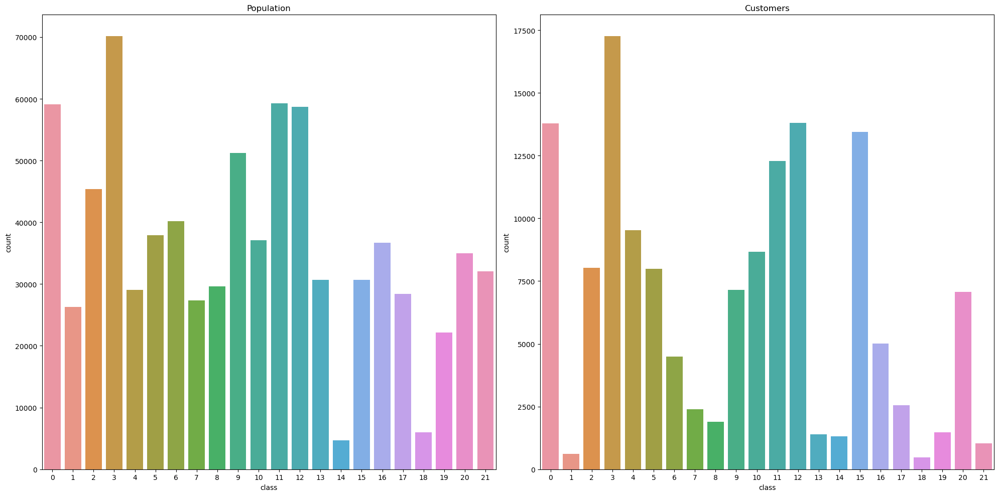

In [145]:
# Compare the proportion of data in each cluster for the customer data to the
# proportion of data in each cluster for the general population.

population_pred_df = pd.DataFrame(population_pred, columns=["class"])
customer_pred_df = pd.DataFrame(customer_pred, columns=["class"])

fig, axes = plt.subplots(1, 2, figsize=(20, 10))  


axes[0].set_title('Population')
sns.countplot(data=population_pred_df, x="class", ax=axes[0])  

axes[1].set_title('Customers')
sns.countplot(data=customer_pred_df, x="class", ax=axes[1])  

plt.tight_layout()
plt.show()


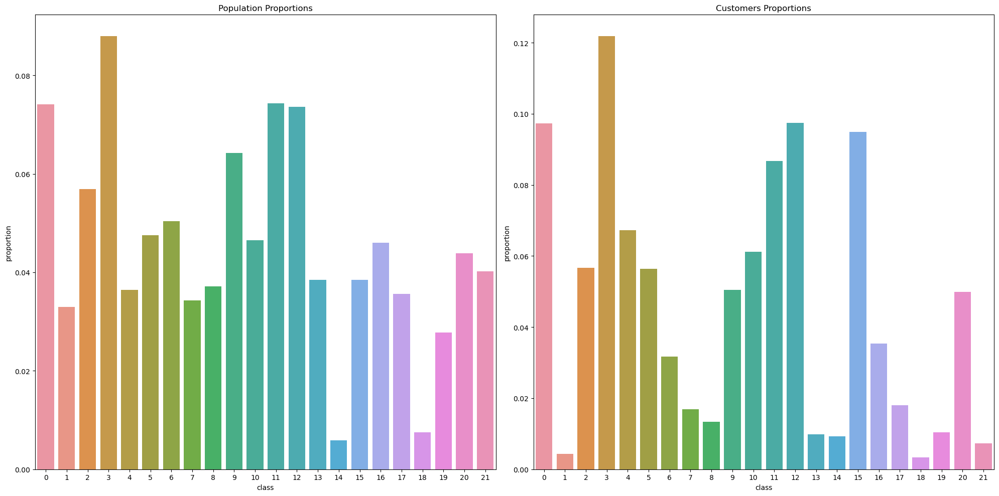

In [ ]:
# Compare the proportion of data in each cluster for the customer data to the
# proportion of data in each cluster for the general population.

population_counts = population_pred_df["class"].value_counts(normalize=True)
customer_counts = customer_pred_df["class"].value_counts(normalize=True)

population_prop_df = population_counts.reset_index()
population_prop_df.columns = ["class", "proportion"]

customer_prop_df = customer_counts.reset_index()
customer_prop_df.columns = ["class", "proportion"]

fig, axes = plt.subplots(1, 2, figsize=(20, 10))  


axes[0].set_title('Population Proportions')
sns.barplot(x="class", y="proportion", data=population_prop_df, ax=axes[0])  

axes[1].set_title('Customers Proportions')
sns.barplot(x="class", y="proportion", data=customer_prop_df, ax=axes[1])  

plt.tight_layout()
plt.show()

In [130]:
# Count occurrences of each cluster
customer_cluster_counts = pd.Series(customer_pred).value_counts(normalize=True)
population_cluster_counts = pd.Series(population_pred).value_counts(normalize=True)

comparison_df = pd.DataFrame({'Customer Proportion': customer_cluster_counts, 
                              'Population Proportion': population_cluster_counts}).fillna(0)

comparison_df['Overrepresentation'] = comparison_df['Customer Proportion'] / comparison_df['Population Proportion']

comparison_df = comparison_df.sort_values(by='Overrepresentation', ascending=False)
print(comparison_df)

    Customer Proportion  Population Proportion  Overrepresentation
15             0.094888               0.038459            2.467254
4              0.067310               0.036394            1.849484
14             0.009317               0.005840            1.595478
3              0.121767               0.087907            1.385184
12             0.097479               0.073591            1.324606
10             0.061148               0.046460            1.316142
0              0.097352               0.074150            1.312904
5              0.056398               0.047502            1.187271
11             0.086651               0.074314            1.166008
20             0.049918               0.043831            1.138872
2              0.056610               0.056918            0.994591
9              0.050391               0.064251            0.784290
16             0.035434               0.046050            0.769462
6              0.031651               0.050346            0.62

In [131]:
# What kinds of people are part of a cluster that is overrepresented in the
# customer data compared to the general population?
customer_centroids_scaled = pca_100.inverse_transform(model.cluster_centers_)

In [132]:
original_centroids = scaler.inverse_transform(customer_centroids_scaled)

In [133]:
original_centroids.shape

(22, 214)

In [134]:
print(original_centroids)

[[4.03556867 0.02333248 5.10629442 ... 0.         0.         0.        ]
 [4.0041066  0.48551459 4.54591567 ... 0.         0.         0.        ]
 [3.08221404 0.32878687 3.43820183 ... 0.         0.         0.        ]
 ...
 [3.34730914 0.56576753 3.26938762 ... 0.         0.         0.        ]
 [3.42202453 0.17942749 5.25729774 ... 0.         0.         0.        ]
 [3.88692493 0.3756263  4.09717914 ... 0.         0.         0.        ]]


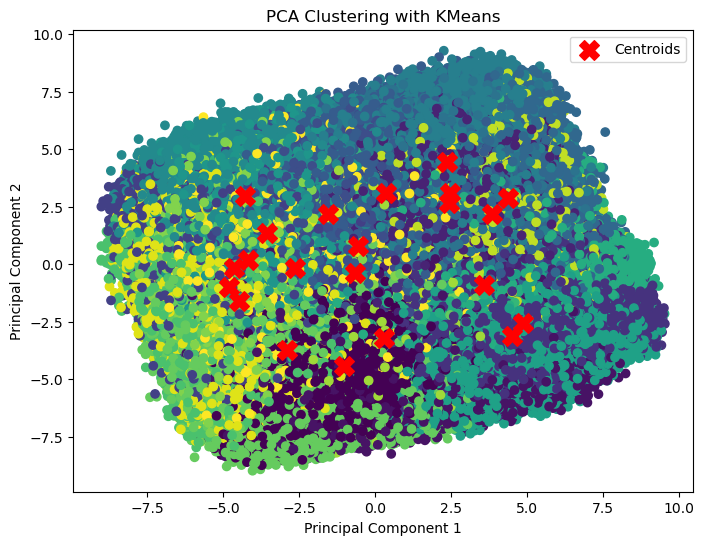

In [135]:
plt.figure(figsize=(8,6))
plt.scatter(pca_100_data[:, 0], pca_100_data[:, 1], c=model.labels_, cmap='viridis', marker='o')
plt.scatter(model.cluster_centers_[:, 0], model.cluster_centers_[:, 1], s=200, c='red', marker='X', label='Centroids')
plt.title('PCA Clustering with KMeans')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend()
plt.show()

In [136]:
original_centroids.shape

(22, 214)

In [137]:
centroids = pd.DataFrame({"feature":customers_normalize.columns, 
                          "centroids_0": original_centroids[0, :], 
                          "centroids_5": original_centroids[5, :],
                          "centroids_10": original_centroids[10, :],
                          "centroids_20": original_centroids[20, :]})
centroids.head()

,feature,centroids_0,centroids_5,centroids_10,centroids_20
0,ALTERSKATEGORIE_GROB,4.035569,3.459818,3.260674,3.422025
1,ANREDE_KZ,0.023332,0.223018,0.089787,0.179427
2,FINANZ_MINIMALIST,5.106294,4.246007,4.891443,5.257298
3,FINANZ_SPARER,0.232013,1.746316,1.633194,1.563936
4,FINANZ_VORSORGER,5.726849,4.273030,4.320434,4.377265


In [ ]:
positive_cont_features = ["LP_STATUS_GROB_1.0 ", "PLZ8_ANTG3"  ,
                          "HH_EINKOMMEN_SCORE", "PLZ8_ANTG4", "PLZ8_BAUMAX", "ORTSGR_KLS9",
                          "EWDICHTE" ,"ANZ_HAUSHALTE_AKTIV" ,"FINANZ_HAUSBAUER" ,"PLZ8_ANTG2","LP_STATUS_FEIN_1.0","KBA05_BAUMAX"]
negative_cont_features = ["wealth" , "PLZ8_ANTG1", "MOBI_REGIO" ,"FINANZ_MINIMALIST", "INNENSTADT","LP_LEBENSPHASE_GROB",
                          "KONSUMNAEHE" ,"LP_LEBENSPHASE_FEIN","KBA05_ANTG1","KBA05_GBZ"]

In [139]:
centroids[centroids["feature"].isin(positive_cont_features)]

,feature,centroids_0,centroids_5,centroids_10,centroids_20
7,FINANZ_HAUSBAUER,2.440294,2.106615,1.522366,1.931431
33,HH_EINKOMMEN_SCORE,2.786816,3.451517,2.861367,0.889283
36,ANZ_HAUSHALTE_AKTIV,1.746850,2.188511,1.178889,0.836108
46,KBA05_BAUMAX,1.000000,1.000000,1.000000,1.000000
49,EWDICHTE,3.159463,2.001786,3.092446,2.979244
58,PLZ8_ANTG2,2.710301,2.287182,2.342959,2.073551
59,PLZ8_ANTG3,1.194380,0.704872,0.939227,0.472919
60,PLZ8_ANTG4,0.389773,0.082799,0.265144,-0.089484
61,PLZ8_BAUMAX,1.000000,1.000000,1.000000,1.000000
65,ORTSGR_KLS9,3.935649,2.531881,4.263462,3.745430


In [140]:
# What kinds of people are part of a cluster that is underrepresented in the
# customer data compared to the general population?

centroids[centroids["feature"].isin(negative_cont_features)]

,feature,centroids_0,centroids_5,centroids_10,centroids_20
2,FINANZ_MINIMALIST,5.106294,4.246007,4.891443,5.257298
11,LP_LEBENSPHASE_FEIN,23.315987,18.418376,46.882456,26.067241
12,LP_LEBENSPHASE_GROB,6.932787,5.639431,14.802080,7.417756
38,KONSUMNAEHE,3.288497,3.784929,3.884942,4.129289
42,KBA05_ANTG1,2.457160,2.360596,2.784785,4.004071
47,KBA05_GBZ,3.833564,3.993453,4.060792,4.960659
50,INNENSTADT,5.838904,6.639703,5.408669,5.656691
53,MOBI_REGIO,3.897133,4.090393,4.246163,5.373941
57,PLZ8_ANTG1,2.714009,3.028935,2.974212,3.554574
206,wealth,2.674312,2.622502,2.682209,4.313731


### Discussion 3.3: Compare Customer Data to Demographics Data

(Double-click this cell and replace this text with your own text, reporting findings and conclusions from the clustering analysis. Can we describe segments of the population that are relatively popular with the mail-order company, or relatively unpopular with the company?)

if we compare cluster 0 with cluster 20 we can find the following 
customers of cluster 0 has: 
higher: 
1. HH_EINKOMMEN_SCORE	of value 2.786816 compared to cluster 20 of value 0.889283
2. ANZ_HAUSHALTE_AKTIV of value 1.746850 compared to cluster 20 of 0.836108
3. LP_STATUS_FEIN_1.0	of value 0.059339 compared with	-0.134431 for cluster 20

cluster 20 has higher values compared with cluster 0 for the following features:
1. wealth of 4.313731 compared with 2.674312 for cluster 0
2. LP_LEBENSPHASE_FEIN	of 26.067241  compared with 23.315987 for cluster 0
3. MOBI_REGIO of 5.373941 compared with 3.897133 for cluster 0
4. KONSUMNAEHE of 4.129289 compared with  3.288497 for cluster 0

> Congratulations on making it this far in the project! Before you finish, make sure to check through the entire notebook from top to bottom to make sure that your analysis follows a logical flow and all of your findings are documented in **Discussion** cells. Once you've checked over all of your work, you should export the notebook as an HTML document to submit for evaluation. You can do this from the menu, navigating to **File -> Download as -> HTML (.html)**. You will submit both that document and this notebook for your project submission.